In [2]:
import pandas as pd
import json
import numpy as np
from readability import Readability
import seaborn as sns
import ast
import syllables
import requests
from collections import Counter

In [3]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [4]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [5]:
data_df = pd.read_csv('data/3-text-extraction.csv')
data_df

,Firm,Link,URL Count,CSS Style,Industry,Tokenized Text List,Tokenized Text String
0,Whiteleys Financial Management LLP,http://www.whiteleysaccountants.co.uk/terms-an...,0.0,NaN,Investment Firms,"[[], [['As', 'business', 'advisers', 'we', 'ca...","[[], [['As', 'business', 'advisers', 'we', 'ca..."
1,Whiteleys Financial Management LLP,http://www.whiteleysaccountants.co.uk/privacy-...,8.0,NaN,Investment Firms,"[[], [['http://www.whiteleysaccountants.co.uk'...","[[], [['http://www.whiteleysaccountants.co.uk'..."
2,Whiteleys Financial Management LLP,http://www.whiteleysaccountants.co.uk/news-ite...,0.0,NaN,Investment Firms,"[[], [['Despite', 'record', 'wage', 'rises', '...","[[], [['Despite', 'record', 'wage', 'rises', '..."
3,Pioneer Point Partners LLP,https://pioneerpoint.com/privacy-and-cookie-po...,NaN,NaN,Investment Firms,"[[], [['Our', 'privacy', '&', 'cookie', 'polic...","[[], [['Our', 'privacy', '&', 'cookie', 'polic..."
4,Engage Wealth Management Limited,https://engagewm.co.uk/privacy-notice/,2.0,NaN,Investment Firms,"[[], [['CLICK', 'HERE', 'to', 'download', 'a',...","[[], [['CLICK', 'HERE', 'to', 'download', 'a',..."
...,...,...,...,...,...,...,...
4827,Onyx Commodities Limited,http://www.onyxcapitalgroup.com/cookie-policy/,11.0,NaN,Investment Firms,"[[], [['Last', 'updated', ':', '09-11-2022']],...","[[], [['Last', 'updated', ':', '09-11-2022']],..."
4828,Baring Asset Management Limited,http://www.barings.com/en-gb/guest/content/ter...,3.0,NaN,Investment Firms,"[[], [['Barings', 'LLC', '(', '“', 'Barings', ...","[[], [['Barings', 'LLC', '(', '“', 'Barings', ..."
4829,Baring Asset Management Limited,http://www.barings.com/en-gb/guest/content/pri...,3.0,NaN,Investment Firms,NaN,"[[], [['Global', 'Job', 'Applicant', 'Privacy'..."
4830,Baring Asset Management Limited,http://www.barings.com/en-gb/guest/content/coo...,2.0,NaN,Investment Firms,"[[], [['This', 'Cookies', 'Notice', 'applies',...","[[], [['This', 'Cookies', 'Notice', 'applies',..."


## Installing Package

In [7]:
# !pip install py-readability-metrics
# !python -m nltk.downloader punkt

# Trial

In [8]:
data_df['Link'][1]

'http://www.whiteleysaccountants.co.uk/privacy-cookie-policy'

In [6]:
text = data_df['Tokenized Text List'][1]
text

'[[], [[\'http://www.whiteleysaccountants.co.uk\', \'(\', \'Website\', \')\', \'is\', \'brought\', \'to\', \'you\', \'by\', \'Whiteleys\', \'Chartered\', \'Certified\', \'Accountants\', \',\', \'a\', \'partnership\', \'established\', \'in\', \'England\', \'and\', \'Wales\', \',\', \'whose\', \'main\', \'place\', \'of\', \'business\', \'is\', \'at\', \'Sovereign\', \'House\', \',\', \'155\', \'to\', \'157\', \'High\', \'Street\', \',\', \'Aldershot\', \',\', \'Hampshire\', \'GU11\', \'1TT\', \'.\'], [\'We\', \'take\', \'the\', \'privacy\', \'of\', \'our\', \'clients\', \'and\', \'Website\', \'visitors\', \'very\', \'seriously\', \'.\'], [\'We\', \'ask\', \'that\', \'you\', \'read\', \'this\', \'privacy\', \'policy\', \'(\', \'Policy\', \')\', \'carefully\', \'as\', \'it\', \'contains\', \'important\', \'information\', \'about\', \'how\', \'we\', \'will\', \'use\', \'your\', \'personal\', \'data\', \'.\'], [\'For\', \'the\', \'purposes\', \'of\', \'the\', \'General\', \'Data\', \'Protect

In [4]:
Readability(text).flesch_kincaid().score

15.487428450733976

In [5]:
text_1 = text.replace("[","").replace("]","").replace("(","").replace(")","").replace("'\'","")
print(text_1)

, 'http://www.whiteleysaccountants.co.uk', , 'Website', , 'is', 'brought', 'to', 'you', 'by', 'Whiteleys', 'Chartered', 'Certified', 'Accountants', ',', 'a', 'partnership', 'established', 'in', 'England', 'and', 'Wales', ',', 'whose', 'main', 'place', 'of', 'business', 'is', 'at', 'Sovereign', 'House', ',', '155', 'to', '157', 'High', 'Street', ',', 'Aldershot', ',', 'Hampshire', 'GU11', '1TT', '.', 'We', 'take', 'the', 'privacy', 'of', 'our', 'clients', 'and', 'Website', 'visitors', 'very', 'seriously', '.', 'We', 'ask', 'that', 'you', 'read', 'this', 'privacy', 'policy', , 'Policy', , 'carefully', 'as', 'it', 'contains', 'important', 'information', 'about', 'how', 'we', 'will', 'use', 'your', 'personal', 'data', '.', 'For', 'the', 'purposes', 'of', 'the', 'General', 'Data', 'Protection', 'Regulation', 'and', 'all', 'other', 'relevant', 'legislation', ',', 'Whiteleys', 'Chartered', 'Certified', 'Accountants', , '‘', 'we', '’', 'or', '‘', 'us', '’', , 'are', 'the', '‘', 'data', 'contro

In [6]:
Readability(text_1).flesch_kincaid().score

14.977407276163479

In [13]:
text_2 = text_1.replace(".", "")
text_2

', \'http://wwwwhiteleysaccountantscouk\', , \'Website\', , \'is\', \'brought\', \'to\', \'you\', \'by\', \'Whiteleys\', \'Chartered\', \'Certified\', \'Accountants\', \',\', \'a\', \'partnership\', \'established\', \'in\', \'England\', \'and\', \'Wales\', \',\', \'whose\', \'main\', \'place\', \'of\', \'business\', \'is\', \'at\', \'Sovereign\', \'House\', \',\', \'155\', \'to\', \'157\', \'High\', \'Street\', \',\', \'Aldershot\', \',\', \'Hampshire\', \'GU11\', \'1TT\', \'\', \'We\', \'take\', \'the\', \'privacy\', \'of\', \'our\', \'clients\', \'and\', \'Website\', \'visitors\', \'very\', \'seriously\', \'\', \'We\', \'ask\', \'that\', \'you\', \'read\', \'this\', \'privacy\', \'policy\', , \'Policy\', , \'carefully\', \'as\', \'it\', \'contains\', \'important\', \'information\', \'about\', \'how\', \'we\', \'will\', \'use\', \'your\', \'personal\', \'data\', \'\', \'For\', \'the\', \'purposes\', \'of\', \'the\', \'General\', \'Data\', \'Protection\', \'Regulation\', \'and\', \'all

In [8]:
import re

In [16]:
text_3 = re.sub(r'http\S+', '', text_1, flags=re.MULTILINE)
text_3

', \' , \'Website\', , \'is\', \'brought\', \'to\', \'you\', \'by\', \'Whiteleys\', \'Chartered\', \'Certified\', \'Accountants\', \',\', \'a\', \'partnership\', \'established\', \'in\', \'England\', \'and\', \'Wales\', \',\', \'whose\', \'main\', \'place\', \'of\', \'business\', \'is\', \'at\', \'Sovereign\', \'House\', \',\', \'155\', \'to\', \'157\', \'High\', \'Street\', \',\', \'Aldershot\', \',\', \'Hampshire\', \'GU11\', \'1TT\', \'.\', \'We\', \'take\', \'the\', \'privacy\', \'of\', \'our\', \'clients\', \'and\', \'Website\', \'visitors\', \'very\', \'seriously\', \'.\', \'We\', \'ask\', \'that\', \'you\', \'read\', \'this\', \'privacy\', \'policy\', , \'Policy\', , \'carefully\', \'as\', \'it\', \'contains\', \'important\', \'information\', \'about\', \'how\', \'we\', \'will\', \'use\', \'your\', \'personal\', \'data\', \'.\', \'For\', \'the\', \'purposes\', \'of\', \'the\', \'General\', \'Data\', \'Protection\', \'Regulation\', \'and\', \'all\', \'other\', \'relevant\', \'leg

In [17]:
Readability(text_3).flesch_kincaid().score

14.896819391073016

# Further Cleaning

In [7]:
data_df_cleaned = data_df.dropna(subset='Tokenized Text List', axis=0)
token_text = [ast.literal_eval(i) for i in data_df_cleaned['Tokenized Text List']]

# Simple Readability Scores

In [74]:
%%time
readability_fk = []

for i in data_df_cleaned['Tokenized Text List']:
    try:
        readability_fk.append(Readability(i).flesch_kincaid().score)
    except:
        readability_fk.append(np.NaN)
        
readability_fk

CPU times: user 3min 55s, sys: 1.11 s, total: 3min 56s
Wall time: 3min 57s


[nan,
 14.977407276163479,
 12.33676829268293,
 11.908147505651055,
 18.235739064856713,
 14.296399055489964,
 16.367729709080226,
 15.466074402446075,
 9.02251843370735,
 18.069733398814325,
 13.440053469437359,
 16.393315515991574,
 11.549372549019608,
 12.089141494435616,
 10.66766829268293,
 19.006868266477763,
 19.006868266477763,
 13.182113059033991,
 18.45225111623571,
 15.740773658371424,
 nan,
 18.15143708250587,
 14.494986975431189,
 12.307884989721483,
 nan,
 16.482406068799765,
 12.66714285714286,
 14.434520799407846,
 nan,
 14.359357632228008,
 8.456251662676245,
 17.351083412622902,
 12.492665069860283,
 13.791084641180422,
 25.87487218045113,
 25.87487218045113,
 25.87487218045113,
 14.329395683453239,
 9.013518720465289,
 13.644698797828621,
 11.472144927536231,
 11.102400168137873,
 11.729499819522509,
 13.31566433566434,
 15.550743246555868,
 18.27607122822327,
 12.14543094496366,
 12.50855729332908,
 14.017199063562703,
 19.236048598949214,
 19.236048598949214,
 11.9

In [76]:
data_df_cleaned['Flesch Kincaid'] = readability_fk

In [77]:
data_df_no_na = data_df_cleaned.dropna(subset=['Flesch Kincaid'])
data_df_no_na.groupby(by=['Industry'])['Flesch Kincaid'].median()

Industry
Banks                  14.265217
Building Societies     13.342050
Credit Institutions    13.657565
Insurers               14.439297
Investment Firms       14.151805
Name: Flesch Kincaid, dtype: float64

<AxesSubplot: xlabel='Industry', ylabel='Flesch Kincaid'>

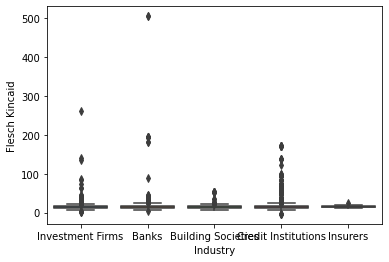

In [24]:
sns.boxplot(data=data_df_no_na, x='Industry', y='Flesch Kincaid')

In [ ]:
readability_fre = []

for i in data_df['Tokenized Text String']:
    try:
        readability_fk.append(Readability(i).flesch().score)
    except:
        readability_fk.append(np.NaN)
        
readability_fre

In [35]:
data_df_no_na.iloc[0,:]['Flesch Kincaid']

15.487428450733976

In [37]:
Readability(data_df_no_na.iloc[0,:]['Tokenized Text String']).flesch().score

40.03385045939382

# Taking into account 'not actually complex' complex words

In [19]:
data_df_cleaned[1:]

,Firm,Link,URL Count,CSS Style,Industry,Tokenized Text List,Tokenized Text String
1,Whiteleys Financial Management LLP,http://www.whiteleysaccountants.co.uk/privacy-...,8.0,NaN,Investment Firms,"[[], [['http://www.whiteleysaccountants.co.uk'...","[[], [['http://www.whiteleysaccountants.co.uk'..."
2,Whiteleys Financial Management LLP,http://www.whiteleysaccountants.co.uk/news-ite...,0.0,NaN,Investment Firms,"[[], [['Despite', 'record', 'wage', 'rises', '...","[[], [['Despite', 'record', 'wage', 'rises', '..."
3,Pioneer Point Partners LLP,https://pioneerpoint.com/privacy-and-cookie-po...,NaN,NaN,Investment Firms,"[[], [['Our', 'privacy', '&', 'cookie', 'polic...","[[], [['Our', 'privacy', '&', 'cookie', 'polic..."
4,Engage Wealth Management Limited,https://engagewm.co.uk/privacy-notice/,2.0,NaN,Investment Firms,"[[], [['CLICK', 'HERE', 'to', 'download', 'a',...","[[], [['CLICK', 'HERE', 'to', 'download', 'a',..."
5,Engage Wealth Management Limited,https://policies.google.com/privacy,43.0,NaN,Investment Firms,"[[], [['Google', 'Privacy', 'Policy']], [], [[...","[[], [['Google', 'Privacy', 'Policy']], [], [[..."
...,...,...,...,...,...,...,...
4826,Lady Grover's Hospital Fund for Officers' Fami...,https://forceshealth.co.uk/cookie-policy/,3.0,NaN,Insurers,"[[], [['Forces', 'Health', 'Military', 'Privat...","[[], [['Forces', 'Health', 'Military', 'Privat..."
4827,Onyx Commodities Limited,http://www.onyxcapitalgroup.com/cookie-policy/,11.0,NaN,Investment Firms,"[[], [['Last', 'updated', ':', '09-11-2022']],...","[[], [['Last', 'updated', ':', '09-11-2022']],..."
4828,Baring Asset Management Limited,http://www.barings.com/en-gb/guest/content/ter...,3.0,NaN,Investment Firms,"[[], [['Barings', 'LLC', '(', '“', 'Barings', ...","[[], [['Barings', 'LLC', '(', '“', 'Barings', ..."
4830,Baring Asset Management Limited,http://www.barings.com/en-gb/guest/content/coo...,2.0,NaN,Investment Firms,"[[], [['This', 'Cookies', 'Notice', 'applies',...","[[], [['This', 'Cookies', 'Notice', 'applies',..."


In [7]:
def check_list(text,firm_name, words):
    words[firm_name] = []
    if type(text[0]) == list:
        check_list(x,firm_name, words)
    else:
        for word in text:
            print(word)
            print(type(word))
            print(type(words[x[0]]))
            words[x[0]] = words[x[0]].append(str(word))
    return words

In [8]:
words = {}
for index, row in data_df_cleaned.iterrows():
    print(row[0])
    text = str(row[5]).strip()
    text = text.replace('[','').replace("]","").replace("'","").strip()
    word_list = text.split(',')
    word_list = [x.strip(' ') for x in word_list]
    word_list = [x for x in word_list if ((len(x)>1 or x.isalpha()) and x is not None)]
    words[row[1]] = word_list

Whiteleys Financial Management LLP
Whiteleys Financial Management LLP
Whiteleys Financial Management LLP
Pioneer Point Partners LLP
Engage Wealth Management Limited
Engage Wealth Management Limited
Engage Wealth Management Limited
LedgerEdge Ltd
LedgerEdge Ltd
Onyx Commodities Limited
Onyx Commodities Limited
Baring Asset Management Limited
Baring Asset Management Limited
BARINGS (U.K.) LIMITED
BARINGS (U.K.) LIMITED
Chenavari Credit Partners LLP
Chenavari Credit Partners LLP
Stanhope Capital LLP
Exo Investing Limited
Exo Investing Limited
Exo Investing Limited
Merrill Lynch International
Merrill Lynch International
EMFI Securities Limited
EMFI Securities Limited
EMFI Securities Limited
Blue Whale Capital LLP
Blue Whale Capital LLP
Blue Whale Capital LLP
Vinco Wealth Management Ltd
Vinco Wealth Management Ltd
Jarrovian Wealth Limited
Jarrovian Wealth Limited
Jarrovian Wealth Limited
Ipreo Limited
Ipreo Limited
Ipreo Limited
Independent Risk Management Solutions Limited
Hamilton Stuart 

The Blackstone Group International Partners LLP
Ediphy Markets Ltd
Ediphy Markets Ltd
London Stone Securities Limited
Asset Match Limited
Asset Match Limited
Asset Match Limited
Asset Match Limited
AFRY Capital Limited
AFRY Capital Limited
F H. Manning Financial Services Limited
F H. Manning Financial Services Limited
F H. Manning Financial Services Limited
KNG Securities LLP
KNG Securities LLP
KNG Securities LLP
Pannells Financial Planning Ltd
Pannells Financial Planning Ltd
Pannells Financial Planning Ltd
Pannells Financial Planning Ltd
Kimberworth Insurance Bureau Limited
Kimberworth Insurance Bureau Limited
GAMCO Asset Management (UK) Limited
B-FLEXION Advisors (UK) LLP
Navarino Capital Limited
CPN Investment Management LLP
MICL Limited
MICL Limited
Genpact WM UK Limited
Genpact WM UK Limited
Genpact WM UK Limited
Numis Securities Limited
Numis Securities Limited
Numis Securities Limited
Oak Hill Advisors (Europe) LLP
Foreign Currency Innovations Limited
Foreign Currency Innovation

Howard Wright Ltd
Quilter Investors Portfolio Management Limited
Quilter Investors Portfolio Management Limited
Quilter Investors Portfolio Management Limited
BMO Capital Markets Limited
BMO Capital Markets Limited
XY ERS UK Ltd
XTB Limited
XTB Limited
Mondrian Investment Partners Limited
Mondrian Investment Partners Limited
Mondrian Investment Partners Limited
Momentum Global Investment Management Limited
Momentum Global Investment Management Limited
GBIM Limited
GBIM Limited
GBIM Limited
GBIM Limited
Big Society Capital Limited
Big Society Capital Limited
Big Society Capital Limited
Big Society Capital Limited
Big Society Capital Limited
Royal London Asset Management Ltd
Royal London Asset Management Ltd
Royal London Asset Management Ltd
Ruby Capital Partners LLP
Ruby Capital Partners LLP
Bruegger Invest Limited
Monarch Alternative Capital (Europe) Ltd
Monarch Alternative Capital (Europe) Ltd
Monarch Alternative Capital (Europe) Ltd
NextEnergy Capital Limited
NextEnergy Capital Limit

TPG Europe, LLP
Camdor Global Advisors Ltd
Camdor Global Advisors Ltd
Quercus Real Assets Limited
Quercus Real Assets Limited
Quercus Real Assets Limited
Connected Asset Management Limited
Hirose Financial UK Ltd.
Hirose Financial UK Ltd.
Hirose Financial UK Ltd.
Hirose Financial UK Ltd.
Beech Tree PE LLP
Beech Tree PE LLP
HPS Investment Partners (UK) LLP
HPS Investment Partners (UK) LLP
Raymond James Investment Services Ltd
Absolute Energy Capital LLP
Absolute Energy Capital LLP
Syndicate Room Ltd
Syndicate Room Ltd
Syndicate Room Ltd
Finalto Financial Services Limited
Finalto Financial Services Limited
Finalto Financial Services Limited
Thornbridge Investment Management LLP
Thornbridge Investment Management LLP
Amram Capital (UK) LLP
Amram Capital (UK) LLP
Alteri Partners LLP
Revcap Advisors Ltd
Revcap Advisors Ltd
Skybound Capital UK Limited
Pennine Wealth Solutions LLP
Pennine Wealth Solutions LLP
Pennine Wealth Solutions LLP
Trillium Asset Management UK Ltd.
Thompson Taraz Deposit

Strowz Ltd
Permanent Wealth Partners LTD
Permanent Wealth Partners LTD
Permanent Wealth Partners LTD
London Investment Management Limited
London Investment Management Limited
London Investment Management Limited
VIBHS Financial Ltd
Investam Capital Ltd
ATLANTIC CAPITAL MARKETS LTD
Wellers Impact Limited
Trinetra Investment Management LLP
AlbaCore Capital LLP
AlbaCore Capital LLP
Financial Administration Services Limited
Halstead Independent Financial Management Limited
Halstead Independent Financial Management Limited
IFSL Administration Limited
IFSL Administration Limited
IFSL Administration Limited
IFSL Administration Limited
J & E Davy (UK) Limited
J & E Davy (UK) Limited
J & E Davy (UK) Limited
ARROWPOINT ADVISORY LLP
Truestone Impact Investment Management Limited
Truestone Impact Investment Management Limited
Shorelight Partners LLP
Shorelight Partners LLP
Shorelight Partners LLP
One Global Market Limited
One Global Market Limited
One Global Market Limited
One Global Market Limite

Dyson Capital Management Ltd
Connor Broadley Ltd
IFDC Ltd
Marl Partners LLP
Marl Partners LLP
Tier One Capital Wealth Management Limited
Tier One Capital Wealth Management Limited
Medici Advisors Ltd
Medici Advisors Ltd
Odin Capital Management Ltd
Bechtel Financing Services Limited
Bechtel Financing Services Limited
Bechtel Financing Services Limited
BGB Weston Ltd
BGB Weston Ltd
Matthews Global Investors (UK) Ltd
Matthews Global Investors (UK) Ltd
Stenham Asset Management (UK) Plc
Multrees Investor Services Limited
Multrees Investor Services Limited
Moore Kingston Smith Corporate Finance Limited
Moore Kingston Smith Corporate Finance Limited
Moore Kingston Smith Corporate Finance Limited
Moore Kingston Smith Corporate Finance Limited
Global Reach Markets Limited
Global Reach Markets Limited
Global Reach Markets Limited
Cairngorm Capital Partners LLP
Cairngorm Capital Partners LLP
Monahans Financial Services Limited
VenCap International plc
VenCap International plc
VenCap International

Dowgate Wealth Limited
Dowgate Wealth Limited
Dowgate Wealth Limited
Dowgate Wealth Limited
Dowgate Wealth Limited
Dowgate Wealth Limited
Eclipse Adviser (Pensions & Investments) Ltd
Eclipse Adviser (Pensions & Investments) Ltd
Eclipse Adviser (Pensions & Investments) Ltd
Eclipse Adviser (Pensions & Investments) Ltd
Evidence Capital Ltd
Evidence Capital Ltd
Evidence Capital Ltd
Hill Fort Capital UK LLP
Bridges Outcomes Limited
BMSG Wealth Management Limited
First Avenue Financial Ltd
Little Square Capital Limited
Little Square Capital Limited
Little Square Capital Limited
AIB Group (UK) Plc
AIB Group (UK) Plc
AIB Group (UK) Plc
AIB Group (UK) Plc
Al Rayan Bank PLC
Al Rayan Bank PLC
Al Rayan Bank PLC
Al Rayan Bank PLC
Allica Bank Ltd
Allica Bank Ltd
Allica Bank Ltd
Allica Bank Ltd
Allica Bank Ltd
Allica Bank Ltd
Alpha Bank London Limited
Alpha Bank London Limited
Alpha Bank London Limited
Alpha Bank London Limited
Arbuthnot Latham & Co Limited
Arbuthnot Latham & Co Limited
Arbuthnot Lat

Zopa Bank Limited
Zopa Bank Limited
Zopa Bank Limited
Zopa Bank Limited
Zopa Bank Limited
Zopa Bank Limited
Bath Investment & Building Society
Bath Investment & Building Society
Bath Investment & Building Society
Bath Investment & Building Society
Beverley Building Society
Beverley Building Society
Beverley Building Society
Beverley Building Society
Buckinghamshire Building Society
Buckinghamshire Building Society
Buckinghamshire Building Society
Buckinghamshire Building Society
Buckinghamshire Building Society
Buckinghamshire Building Society
Cambridge Building Society
Cambridge Building Society
Cambridge Building Society
Cambridge Building Society
Coventry Building Society
Coventry Building Society
Coventry Building Society
Coventry Building Society
Coventry Building Society
Coventry Building Society
Coventry Building Society
Coventry Building Society
Cumberland Building Society
Cumberland Building Society
Cumberland Building Society
Cumberland Building Society
Cumberland Building So

National Australia Bank Limited
Anglo-Saxons Friendly Society
Anglo-Saxons Friendly Society
Anglo-Saxons Friendly Society
Anglo-Saxons Friendly Society
Anglo-Saxons Friendly Society
Anglo-Saxons Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Armstrong Watson Friendly Society
Methodist Insurance Plc
Methodist Insurance Plc
Methodist Insurance Plc
Methodist Insurance Plc
Dentists' and General Mutual Benefit Society Ltd
Dentists' and General Mutual Benefit Society Ltd
Dentists' and General Mutual Benefit Society Ltd
Dentists' and General Mutual Benefit Society Ltd
Sheffield Mutual Friendly Society Limited
Sheffield Mutual Friendly Society Limited
Sheffield Mutual Friendly Society Limited
Sheffield Mutual Friendly Society Limited
Sheffield Mutual Friendly Society Limited
Sheffield Mutu

First Rate Credit Union Limited
First Rate Credit Union Limited
Adventist Credit Union Limited
Adventist Credit Union Limited
Adventist Credit Union Limited
Number One Police Credit Union Limited
Number One Police Credit Union Limited
Number One Police Credit Union Limited
Number One Police Credit Union Limited
Salford Credit Union Limited
Stockport Credit Union Limited
Stockport Credit Union Limited
Croydon Caribbean Credit Union Limited
Croydon Caribbean Credit Union Limited
Croydon Caribbean Credit Union Limited
Croydon Caribbean Credit Union Limited
Unify Credit Union Limited
Unify Credit Union Limited
Unify Credit Union Limited
Commonwealth Secretariat Staff Credit Union Limited
Commonwealth Secretariat Staff Credit Union Limited
Commonwealth Secretariat Staff Credit Union Limited
North Tyneside Employees Credit Union Limited
Leeds City Credit Union Limited
Smart Money Cymru Credit Union Limited
Ambac Assurance UK Limited
Ambac Assurance UK Limited
Metro Moneywise Credit Union Lim

ECCU Assurance dac
Heddington Insurance (U.K.) Limited
Heddington Insurance (U.K.) Limited
Lady Grover's Hospital Fund for Officers' Families Limited
Lady Grover's Hospital Fund for Officers' Families Limited
Lady Grover's Hospital Fund for Officers' Families Limited
Onyx Commodities Limited
Baring Asset Management Limited
Baring Asset Management Limited
BARINGS (U.K.) LIMITED


In [27]:
print(type(words))

<class 'dict'>


In [28]:
print(len(words))

1822


In [11]:
complex_words = []
for word_lists in words.values():
    print(word_lists)
    for word in word_lists:
        if syllables.estimate(word) >=3:
            complex_words.append(word.lower())


['As', 'business', 'advisers', 'we', 'can', 'help', 'formulate', 'strategic', 'plans', 'to', 'help', 'achieve', 'your', 'vision', 'Our', 'specialists', 'can', 'also', 'assist', 'with', 'profit', 'improvement', 'through', 'sound', 'business', 'management', 'techniques']
['http://www.whiteleysaccountants.co.uk', 'Website', 'is', 'brought', 'to', 'you', 'by', 'Whiteleys', 'Chartered', 'Certified', 'Accountants', 'a', 'partnership', 'established', 'in', 'England', 'and', 'Wales', 'whose', 'main', 'place', 'of', 'business', 'is', 'at', 'Sovereign', 'House', '155', 'to', '157', 'High', 'Street', 'Aldershot', 'Hampshire', 'GU11', '1TT', 'We', 'take', 'the', 'privacy', 'of', 'our', 'clients', 'and', 'Website', 'visitors', 'very', 'seriously', 'We', 'ask', 'that', 'you', 'read', 'this', 'privacy', 'policy', 'Policy', 'carefully', 'as', 'it', 'contains', 'important', 'information', 'about', 'how', 'we', 'will', 'use', 'your', 'personal', 'data', 'For', 'the', 'purposes', 'of', 'the', 'General', 

['LedgerEdge', 'respects', 'your', 'privacy', 'and', 'is', 'committed', 'to', 'protecting', 'your', 'personal', 'data', 'This', 'privacy', 'policy', 'will', 'inform', 'you', 'as', 'to', 'how', 'we', 'look', 'after', 'your', 'personal', 'data', 'when', 'you', 'visit', 'our', 'website', 'regardless', 'of', 'where', 'you', 'visit', 'it', 'from', 'and', 'tell', 'you', 'about', 'your', 'privacy', 'rights', 'and', 'how', 'the', 'law', 'protects', 'you', 'This', 'privacy', 'policy', 'is', 'provided', 'in', 'a', 'layered', 'format', 'so', 'you', 'can', 'click', 'through', 'to', 'the', 'specific', 'areas', 'set', 'out', 'below', 'Purpose', 'of', 'this', 'privacy', 'policy', 'This', 'privacy', 'policy', 'aims', 'to', 'give', 'you', 'information', 'on', 'how', 'LedgerEdge', 'collects', 'and', 'processes', 'your', 'personal', 'data', 'through', 'your', 'use', 'of', 'this', 'website', 'www.ledgeredge.com', 'including', 'any', 'data', 'you', 'may', 'provide', 'through', 'this', 'website', 'when', 'y

['Home', 'Privacy', 'Notice', 'This', 'Privacy', 'Policy', 'explains', 'how', 'we', 'use', 'the', 'personal', 'information', 'that', 'Chenavari', 'Investment', 'Managers', 'collects', 'or', 'generates', 'both', 'in', 'relation', 'to', 'this', 'website', 'and', 'our', 'products', 'and', 'services', 'The', 'list', 'below', 'sets', 'out', 'what', 'is', 'covered', 'in', 'this', 'Privacy', 'Policy', 'and', 'you', 'can', 'click', 'on', 'the', 'headings', 'below', 'to', 'go', 'to', 'a', 'specific', 'section', 'BACKGROUND', 'THE', 'PRODUCTS', 'AND', 'SERVICES', 'WE', 'PROVIDE', 'THE', 'TYPES', 'OF', 'PERSONAL', 'DATA', 'WE', 'COLLECT', 'HOW', 'WE', 'USE', 'YOUR', 'INFORMATION', 'DISCLOSURE', 'OF', 'YOUR', 'INFORMATION', 'TO', 'THIRD', 'PARTIES', 'INTERNATIONAL', 'TRANSFERS', 'OF', 'PERSONAL', 'DATA', 'HOW', 'WE', 'SAFEGUARD', 'YOUR', 'INFORMATION', '{subsections: {subsections:', 'text: 1.1', 'Chenavari', 'Financial', 'Group', 'Ltd', 'and', 'Chenavari', 'Credit', 'Partners', 'LLP', 'with', 'the

['How', 'we', 'protect', 'you', 'How', 'you', 'can', 'protect', 'yourself', 'How', 'to', 'stay', 'safe', 'online', 'Your', 'security', 'is', 'our', 'top', 'priority', 'Merrill', '’s', 'Security', 'Center', 'is', 'your', 'trusted', 'source', 'for', 'security', 'tools', 'and', 'resources', 'on', 'how', 'to', 'best', 'protect', 'yourself', 'against', 'fraud', 'and', 'scams', 'Protecting', 'your', 'personal', 'and', 'financial', 'information', 'is', 'a', 'shared', 'responsibility', 'and', 'we', '"re"', 'consistently', 'working', 'hard', 'to', 'help', 'our', 'clients', 'stay', 'secure', 'Find', 'out', 'the', 'steps', 'you', 'can', 'take', 'today', 'and', 'start', 'increasing', 'your', 'security', 'right', 'away', 'Get', 'started', 'How', 'we', 'protect', 'you', 'Merrill', 'is', 'committed', 'to', 'your', 'security', 'because', 'the', 'protection', 'and', 'trust', 'of', 'our', 'clients', 'is', 'essential', 'to', 'our', 'business', 'Here', 'are', 'some', 'of', 'the', 'ways', 'we', 'protect', 

['Jarrovian', 'Wealth', 'Limited', 'is', 'the', 'Operator', 'and', 'Copyright', 'Holder', 'respectively', 'of', 'this', 'website', 'the', 'Site', 'Jarrovian', 'Wealth', 'Limited', 'uses', 'technology', 'to', 'collect', 'information', 'about', 'the', 'use', 'of', 'the', 'Site', 'in', 'order', 'to', 'improve', 'your', 'experience', 'when', 'you', 'browse', 'the', 'Site', 'In', 'order', 'to', 'collect', 'the', 'information', 'this', 'Site', 'uses', 'Cookies', 'A', 'Cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'is', 'sent', 'to', 'your', 'browser', 'and', 'stored', 'on', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'or', 'internet', 'enabled', 'device', 'when', 'you', 'visit', 'the', 'Site', 'Analytical', 'Performance', 'Cookies', 'These', 'Cookies', 'collect', 'information', 'in', 'an', 'anonymous', 'form', 'about', 'how', 'visitors', 'use', 'our', 'Site', 'They', 'allow', 'us', 'to', 'recognise', 'and', 'count', 'the', 'number', 'of', 'visitors', '

['Privacy', 'Policy', 'This', 'privacy', 'notice', 'explains', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'information', 'do', 'we', 'collect', 'about', 'you', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'for', 'financial', 'planning', 'and', 'mortgage', 'advice', 'and', 'our', 'related', 'services', 'This', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'It', 'may', 'also', 'include', 'special', 'categories', 'of', 'personal', 'data', 'such', 'as', 'data', 'about', 'your', 'health', 'if', 'this', 'is', 'necessary', 'for', 'the', 'provision', 'of', 'our', 'services', 'We', 'may', 'also', 'collect', 'information', 'when', 'you', 'voluntarily', 'complete', 'client', 'surveys', 'or', 'provide', 'feedback', 'to', 'us', 'Information', 'relating', 'to', 'usage', 'of', 'our', 'website', 'is', 'collected', 'using', 'cookies', 'These', 'are', 'text', 'files', '

['Introduction', 'We', 'are', 'committed', 'to', 'helping', 'our', 'investors', 'reach', 'their', 'financial', 'goals', 'and', 'to', 'treating', 'investors', 'clients', 'and', 'contacts', 'fairly', 'and', 'with', 'respect', 'This', 'includes', 'maintaining', 'your', 'trust', 'and', 'confidence', 'by', 'handling', 'your', 'personal', 'data', 'and', 'information', 'with', 'respect', 'and', 'enabling', 'you', 'to', 'self', 'manage', 'the', 'communications', 'you', 'receive', 'from', 'Liontrust', 'Asset', 'Management', 'PLC', 'Liontrust', 'Fund', 'Partners', 'LLP', 'Liontrust', 'Investment', 'Partners', 'LLP', 'Liontrust', 'Potfolio', 'Management', 'Limited', 'and', 'Liontrust', 'International', 'Luxembourg', 'SA', 'collectively', 'Liontrust', 'It', 'is', 'important', 'that', 'you', 'know', 'what', 'personal', 'information', 'Liontrust', 'holds', 'about', 'you', 'and', 'how', 'it', 'is', 'used', 'and', 'this', 'Privacy', 'Notice', 'has', 'been', 'written', 'to', 'explain', 'this', 'Liontru

['KMG', 'Independent', 'L', 'imited', 'has', 'issued', 'this', 'privacy', 'notice', 'to', 'you', 'to', 'explain', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'information', 'do', 'we', 'collect', 'about', 'you', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'for', 'any', 'kind', 'of', 'financial', 'planning', 'advice', 'T', 'h', 'is', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'It', 'may', 'also', 'include', 'special', 'categories', 'of', 'personal', 'data', 'such', 'as', 'data', 'about', 'your', 'health', 'if', 'this', 'is', 'necessary', 'for', 'the', 'provision', 'of', 'our', 'services', 'We', 'may', 'also', 'collect', 'information', 'when', 'you', 'voluntarily', 'complete', 'client', 'surveys', 'or', 'provide', 'feedback', 'to', 'us', 'Information', 'relating', 'to', 'usage', 'of', 'our', 'website', 'is', 'collected', 'using', 'cookies', 'These', '

['HARTMANN', 'CAPITAL', 'TERMS', 'OF', 'USE', 'Last', 'Updated', 'June', '2022', 'These', 'Terms', 'of', 'Use', 'Terms', 'apply', 'to', 'your', 'access', 'to', 'and', 'use', 'of', 'this', 'website', 'the', 'Website', 'provided', 'by', 'Hartmann', 'Capital', 'Hartmann', 'or', 'we', 'By', 'using', 'the', 'Website', 'you', 'agree', 'to', 'these', 'Terms', 'including', 'the', 'mandatory', 'arbitration', 'provision', 'and', 'class', 'action', 'waiver', 'in', 'Section', '12', 'If', 'you', 'do', 'not', 'agree', 'to', 'these', 'Terms', 'do', 'not', 'use', 'the', 'Website', 'We', 'may', 'make', 'changes', 'to', 'these', 'Terms', 'from', 'time', 'to', 'time', 'If', 'we', 'make', 'changes', 'we', 'will', 'provide', 'you', 'with', 'notice', 'of', 'such', 'changes', 'such', 'as', 'by', 'sending', 'an', 'email', 'providing', 'a', 'notice', 'through', 'the', 'Website', 'or', 'updating', 'the', 'date', 'at', 'the', 'top', 'of', 'these', 'Terms', 'Unless', 'we', 'say', 'otherwise', 'in', 'our', 'notice

['80', 'of', 'retail', 'accounts', 'lose', 'money', 'when', 'trading', 'CFDs', 'with', 'this', 'provider', 'Spread', 'bets', 'and', 'CFDs', 'are', 'complex', 'instruments', 'and', 'come', 'with', 'a', 'high', 'risk', 'of', 'losing', 'money', 'rapidly', 'due', 'to', 'leverage', '80', 'of', 'retail', 'investor', 'accounts', 'lose', 'money', 'when', 'trading', 'spread', 'bets', 'and', 'CFDs', 'with', 'this', 'provider', 'You', 'should', 'consider', 'whether', 'you', 'understand', 'how', 'spread', 'bets', 'and', 'CFDs', 'work', 'and', 'whether', 'you', 'can', 'afford', 'to', 'take', 'the', 'high', 'risk', 'of', 'losing', 'your', 'money', 'expand_more_24px', 'Help', 'center', 'Contact', 'us', 'Choose', 'your', 'language', 'close_24px', 'Deutsch', 'Français', 'Nederlands', 'Italiano', 'Română', 'Español', 'Português', 'Latviešu', 'Lietuviškas', 'Eesti', 'Русский', 'Magyar', 'Polski', 'Hrvatski', 'Čeština', 'Български', 'Slovenski', 'Bahasa', 'Indonesia', 'العربية', 'বাংলা', 'Khmer', '한국어', '

['Website', 'Terms', 'of', 'Use', 'and', 'Disclaimer', 'This', 'website', 'is', 'communicated', 'by', 'Nau', 'Securities', 'Limited', 'Nau', 'which', 'is', 'registered', 'in', 'England', 'and', 'Wales', 'no.', '07128441', 'having', 'its', 'registered', 'office', 'at', 'Eaton', 'Gate', 'London', 'SW1W', '9BJ', 'United', 'Kingdom', '{subsections:', 'text: 1.1.', 'Please', 'note', 'that', 'access', 'to', 'and', 'the', 'use', 'of', 'this', 'website', 'are', 'subject', 'to', 'the', 'following', 'terms', 'and', 'conditions', 'Before', 'accessing', 'and', 'using', 'Nau', '’s', 'website', 'and', 'its', 'contents', 'please', 'read', 'these', 'terms', 'and', 'conditions', 'as', 'they', 'constitute', 'a', 'legal', 'notice', 'and', 'contain', 'important', 'legal', 'information', 'title: }', '{subsections:', 'text: 1.2.', 'By', 'accessing', 'and', 'using', 'Nau', '’s', 'website', 'you', 'acknowledge', 'that', 'you', 'have', 'reviewed', 'understood', 'and', 'agreed', 'to', 'the', 'terms', 'and', 'co

['People', 'Careers', 'Current', 'vacancies', 'Benefits', 'at', 'Thesis', 'FAQs', 'Our', 'assessment', 'process', 'Contact', 'us', 'Our', 'offices', 'Media', 'enquiries', 'Scam', 'safe', '17:36', 'pm', 'Friday', '25th', 'November', '2022', 'Home', 'Privacy', 'security', 'Privacy', 'security', 'Please', 'select', 'the', 'Privacy', 'Notice', 'that', 'applies', 'to', 'you', 'Privacy', 'notice', 'for', 'clients', 'This', 'Privacy', 'Notice', 'explains', 'what', 'personal', 'data', 'information', 'we', 'hold', 'about', 'you', 'as', 'a', 'client', 'or', 'potential', 'client', 'how', 'we', 'collect', 'it', 'and', 'how', 'we', 'use', 'and', 'may', 'share', 'information', 'about', 'you', 'We', 'are', 'required', 'to', 'notify', 'you', 'of', 'this', 'information', 'under', 'data', 'protection', 'legislation', 'Please', 'ensure', 'that', 'you', 'read', 'this', 'notice', 'and', 'any', 'other', 'similar', 'notice', 'we', 'may', 'provide', 'to', 'you', 'from', 'time', 'to', 'time', 'when', 'we', 'co

['{subsections: {subsections:', 'text: 1.1', 'We', 'are', 'committed', 'to', 'safeguarding', 'the', 'privacy', 'of', 'our', 'website', 'visitors', 'in', 'this', 'policy', 'we', 'explain', 'how', 'we', 'will', 'treat', 'your', 'personal', 'information', 'title: }', '{subsections:', 'text: 1.2', 'By', 'using', 'our', 'website', 'and', 'agreeing', 'to', 'this', 'policy', 'you', 'consent', 'to', 'our', 'use', 'of', 'cookies', 'in', 'accordance', 'with', 'the', 'terms', 'of', 'this', 'policy', 'title: }', 'text:', 'title: 1. Introduction}', '{subsections:', 'text: 2.1', 'This', 'document', 'was', 'created', 'using', 'a', 'template', 'from', 'SEQ', 'Legal', 'http://www.seqlegal.com', 'title: 2. Credit}', '{subsections:', 'text: 3.1', 'We', 'may', 'collect', 'store', 'and', 'use', 'the', 'following', 'kinds', 'of', 'personal', 'information', 'title: 3. Collecting personal information}', 'Terms', 'Conditions', 'Privacy', 'policy', '3.2', 'Before', 'you', 'disclose', 'to', 'us', 'the', 'persona

['The', 'content', 'of', 'the', 'pages', 'of', 'this', 'website', 'is', 'for', 'your', 'general', 'information', 'and', 'use', 'only', 'It', 'is', 'subject', 'to', 'change', 'without', 'notice', 'Neither', 'we', 'nor', 'any', 'third', 'parties', 'provide', 'any', 'warranty', 'or', 'guarantee', 'as', 'to', 'the', 'accuracy', 'timeliness', 'performance', 'completeness', 'or', 'suitability', 'of', 'the', 'information', 'and', 'materials', 'found', 'or', 'offered', 'on', 'this', 'website', 'for', 'any', 'particular', 'purpose', 'You', 'acknowledge', 'that', 'such', 'information', 'and', 'materials', 'may', 'contain', 'inaccuracies', 'or', 'errors', 'and', 'we', 'expressly', 'exclude', 'liability', 'for', 'any', 'such', 'inaccuracies', 'or', 'errors', 'to', 'the', 'fullest', 'extent', 'permitted', 'by', 'law', 'Your', 'use', 'of', 'any', 'information', 'or', 'materials', 'on', 'this', 'website', 'is', 'entirely', 'at', 'your', 'own', 'risk', 'for', 'which', 'we', 'shall', 'not', 'be', 'liab

['Follow', 'us', 'Twitter', 'LinkedIn', 'YouTube', 'Contact', 'Schroders', 'Schroders', 'is', 'a', 'world', 'class', 'asset', 'manager', 'operating', 'from', '38', 'locations', 'across', 'Europe', 'the', 'Americas', 'Asia', 'the', 'Middle', 'East', 'and', 'Africa', 'Worldwide', 'locations', 'For', 'any', 'further', 'questions', 'please', 'contact', 'us', 'Contact', 'us', 'Past', 'performance', 'is', 'not', 'a', 'guide', 'to', 'future', 'performance', 'and', 'may', 'not', 'be', 'repeated', 'The', 'value', 'of', 'investments', 'and', 'the', 'income', 'from', 'them', 'may', 'go', 'down', 'as', 'well', 'as', 'up', 'and', 'investors', 'may', 'not', 'get', 'back', 'the', 'amounts', 'originally', 'invested', 'All', 'investments', 'involve', 'risks', 'including', 'the', 'risk', 'of', 'possible', 'loss', 'of', 'principal', 'To', 'the', 'extent', 'that', 'you', 'are', 'in', 'North', 'America', 'this', 'content', 'is', 'issued', 'by', 'Schroder', 'Investment', 'Management', 'North', 'America', 'I

['This', 'is', 'the', 'website', 'of', 'FSE', 'C.I.C.', 'and', 'its', 'subsidiaries', 'The', 'FSE', 'Group', 'For', 'details', 'of', 'those', 'companies', 'please', 'see', 'the', 'FSE', 'C.I.C.', 'Companies', 'page', 'References', 'to', 'we', 'or', 'us', 'in', 'this', 'website', 'are', 'to', 'the', 'relevant', 'company', 'or', 'companies', 'in', 'the', 'FSE', 'Group', 'References', 'to', 'you', 'in', 'this', 'website', 'mean', 'to', 'you', 'and', 'if', 'applicable', 'the', 'company', 'partnership', 'or', 'other', 'organisation', 'for', 'which', 'you', 'work', '{subsections:', 'text: 1.1', 'By', 'using', 'this', 'website', 'you', 'are', 'agreeing', 'to', 'be', 'bound', 'by', 'these', 'terms', 'and', 'conditions', 'these', 'Conditions', 'and', 'that', 'we', 'may', 'use', 'your', 'personal', 'data', 'in', 'accordance', 'with', 'our', 'Privacy', 'Policy', 'By', 'using', 'this', 'website', 'and', 'agreeing', 'to', 'these', 'Conditions', 'you', 'warrant', 'and', 'confirm', 'that', 'you', 'ar

['Privacy', 'Policy', 'Blue', 'Planet', 'Investment', 'Management', 'Ltd', 'respects', 'your', 'right', 'to', 'privacy', 'while', 'using', 'our', 'web', 'site', 'Our', 'privacy', 'policy', 'detailed', 'below', 'explains', 'what', 'information', 'we', 'may', 'gather', 'from', 'your', 'visit', 'to', 'our', 'web', 'sites', 'and', 'how', 'such', 'information', 'may', 'be', 'used', 'If', 'you', 'fill', 'in', 'our', 'Enquiry', 'Form', 'we', 'will', 'use', 'this', 'information', 'to', 'process', 'your', 'requests', 'as', 'well', 'as', 'for', 'the', 'additional', 'purpose', 'of', 'tailoring', 'future', 'requests', 'and', 'correspondence', 'Upon', 'your', 'request', 'Blue', 'Planet', 'Investment', 'Management', 'Ltd', 'will', 'remove', 'your', 'name', 'from', 'any', 'mailing', 'list', 'to', 'which', 'you', 'registered', 'with', 'us', 'but', 'for', 'MiFID', 'business', 'complaints', 'we', 'have', 'a', 'statutory', 'requirment', 'to', 'retain', 'your', 'data', 'for', 'five', 'years', 'Parts', 'of

['Daiwa', 'Capital', 'Markets', 'Europe', 'Limited', 'Website', 'Terms', 'Conditions', 'Please', 'read', 'the', 'details', 'set', 'out', 'below', 'carefully', 'before', 'using', 'this', 'Site', 'By', 'accessing', 'this', 'Site', 'you', 'agree', 'to', 'be', 'bound', 'by', 'the', 'following', 'terms', 'and', 'conditions', 'and', 'disclaimers', 'the', 'Terms', 'You', 'and', 'we', 'agree', 'that', 'the', 'Terms', 'are', 'legally', 'binding', 'between', 'you', 'and', 'us', 'and', 'that', 'your', 'use', 'of', 'the', 'Site', 'is', 'subject', 'to', 'the', 'Terms', 'This', 'website', 'has', 'been', 'approved', 'for', 'issue', 'and', 'access', 'in', 'the', 'UK', 'by', 'Daiwa', 'Capital', 'Markets', 'Europe', 'Limited', 'which', 'is', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'and', 'is', 'a', 'member', 'of', 'the', 'London', 'Stock', 'Exchange', 'If', 'you', 'choose', 'to', 'enter', 'this', 'website', 'from', 'outside', 'the', 'UK', 'you', 'are', 'advised', 'that', 'it', 'ma

['Our', 'website', 'uses', 'cookies', 'This', 'site', 'uses', 'cookies', 'Some', 'are', 'essential', 'to', 'keep', 'our', 'website', 'secure', 'and', 'to', 'provide', 'our', 'users', 'with', 'requested', 'information', 'Others', 'help', 'us', 'improve', 'your', 'online', 'experience', 'and', 'track', 'website', 'performance', 'By', 'using', 'our', 'website', 'you', 'accept', 'essential', 'cookies', 'although', 'you', 'can', 'opt', 'out', 'of', 'using', 'other', 'non-essential', 'cookies', 'if', 'you', 'wish', 'A', 'cookie', 'is', 'a', 'small', 'text', 'file', 'used', 'on', 'a', 'website', 'to', 'make', 'a', 'user', '’s', 'experience', 'more', 'efficient', 'This', 'site', 'uses', 'different', 'types', 'of', 'cookies', 'Some', 'of', 'them', 'are', 'essentials', 'while', 'others', 'help', 'us', 'improve', 'your', 'online', 'experience', 'and', 'track', 'website', 'performance', 'The', 'necessary', 'essential', 'cookies', 'are', 'used', 'to', 'keep', 'our', 'website', 'secure', 'and', 'nec

['INTRODUCTION', 'Welcome', 'to', 'our', 'website', 'www.dncapital.com', 'which', 'is', 'accessible', 'via', 'your', 'computer', 'or', 'your', 'portable', 'hand', 'held', 'device', 'the', 'Website', 'or', 'App', 'the', 'App', 'The', 'Website', 'and', 'App', 'are', 'provided', 'by', 'DN', 'Capital', 'of', 'Queen', 'Annes', 'Gate', 'Dartmouth', 'Street', 'SW1H', '9BP', 'United', 'Kingdom', 'DN', 'Capital', 'us', 'we', 'or', 'our', 'for', 'short', 'You', 'and', 'your', 'means', 'you', 'as', 'the', 'user', 'of', 'our', 'Website', 'We', 'have', 'set', 'out', 'the', 'terms', 'under', 'which', 'we', 'are', 'providing', 'you', 'with', 'access', 'to', 'our', 'Website', 'or', 'App', 'and', 'our', 'products', 'and', 'services', 'These', 'include', 'the', 'terms', 'and', 'conditions', 'that', 'govern', 'a', 'Your', 'use', 'of', 'our', 'Website', 'or', 'App', 'including', 'the', 'mobile', 'optimised', 'version', 'of', 'our', 'Website', 'accessible', 'from', 'your', 'portable', 'hand', 'held', 'devi

['Welcome', 'to', 'our', 'website', 'If', 'you', 'continue', 'to', 'browse', 'and', 'use', 'this', 'website', 'you', 'are', 'agreeing', 'to', 'comply', 'with', 'and', 'be', 'bound', 'by', 'the', 'following', 'terms', 'and', 'conditions', 'of', 'use', 'which', 'together', 'with', 'our', 'privacy', 'policy', 'govern', 'Bond', 'Capital', 'Partners', 'UK', 'Limited', 'relationship', 'with', 'you', 'in', 'relation', 'to', 'this', 'website', 'Bond', 'Capital', 'Partners', 'UK', 'Limited', '1St', 'Floor', '10', 'Chandos', 'Street', 'London', 'W1G', '9DQ', 'United', 'Kingdom', 'Our', 'company', 'registration', 'number', 'is', '05476874', 'The', 'term', 'you', 'refers', 'to', 'the', 'user', 'or', 'viewer', 'of', 'our', 'website', 'The', 'use', 'of', 'this', 'website', 'is', 'subject', 'to', 'the', 'following', 'terms', 'of', 'use', 'The', 'content', 'of', 'the', 'pages', 'of', 'this', 'website', 'is', 'for', 'your', 'general', 'information', 'and', 'use', 'only', 'It', 'is', 'subject', 'to', 'c

['Welcome', 'to', 'our', 'website', 'If', 'you', 'continue', 'to', 'browse', 'and', 'use', 'this', 'website', 'you', 'are', 'agreeing', 'to', 'comply', 'with', 'and', 'be', 'bound', 'by', 'the', 'following', 'terms', 'and', 'conditions', 'of', 'use', 'which', 'together', 'with', 'our', 'privacy', 'policy', 'govern', 'MJ', 'Hudson', '’s', 'relationship', 'with', 'you', 'in', 'relation', 'to', 'this', 'website', 'Unauthorised', 'use', 'of', 'this', 'website', 'or', 'breach', 'of', 'these', 'terms', 'and', 'conditions', 'may', 'give', 'to', 'a', 'claim', 'for', 'damages', 'and', 'or', 'be', 'a', 'criminal', 'offence', 'For', 'these', 'purposes', 'the', 'term', 'MJ', 'Hudson', 'refers', 'to', 'the', 'owner', 'of', 'the', 'website', 'MJH', 'Group', 'Holdings', 'Limited', 'Jersey', 'no.', '114517', 'The', 'term', 'you', 'refers', 'to', 'the', 'user', 'or', 'viewer', 'of', 'our', 'website', 'Reliance', 'The', 'information', 'and', 'any', 'commentary', 'contained', 'on', 'this', 'website', 'is

['Search', 'Menu', 'Our', 'Capabilities', 'Lending', 'BPO', 'Lending', 'BPO', 'Primary', 'Servicing', 'Collections', 'and', 'Arrears', 'Servicing', 'Device', 'Finance', 'Servicing', 'Investments', 'BPO', 'Investments', 'BPO', 'Investment', 'Administration', 'Children', '"s"', 'Savings', 'Deposits', 'Services', 'Digital', 'Transformation', 'Digital', 'Transformation', 'Data', 'Strategy', 'and', 'Analytics', 'Automation', 'and', 'Robotics', 'Payment', 'Collections', 'Payment', 'Collections', 'Remediation', 'and', 'Redress', 'Remediation', 'and', 'Redress', 'Legal', 'Title', 'Management', 'Services', 'Legal', 'Title', 'Management', 'Services', 'Portfolio', 'Administration', 'Portfolio', 'Administration', 'Your', 'Industry', 'Financial', 'Services', 'Challenge', 'convention', 'Capture', 'value', 'Financial', 'Services', 'Public', 'Sector', 'Digital', 'by', 'default', 'Solutions', 'and', 'services', 'to', 'meet', 'changing', 'expectations', 'Public', 'Sector', 'Telecoms', 'Telecoms', 'Utili

['Privacy', 'policy', 'Last', 'Updated', 'August', '14', '2021', 'Thank', 'you', 'for', 'your', 'interest', 'in', 'Firsthand', 'an', 'affiliate', 'of', 'Infobase', 'Holdings', 'Inc.', 'referred', 'to', 'as', 'Firsthand', 'we', 'us', 'or', 'our', 'Your', 'privacy', 'is', 'important', 'to', 'us', 'and', 'this', 'Privacy', 'Policy', 'describes', 'how', 'we', 'process', 'personal', 'information', 'as', 'part', 'of', 'our', 'business', 'operations', 'including', 'the', 'types', 'of', 'personal', 'information', 'that', 'we', 'collect', 'the', 'purposes', 'for', 'which', 'we', 'use', 'it', 'the', 'types', 'of', 'third', 'parties', 'to', 'whom', 'we', 'share', 'it', 'and', 'the', 'rights', 'and', 'responsibilities', 'you', 'may', 'have', 'with', 'respect', 'to', 'such', 'personal', 'information', 'This', 'Privacy', 'Policy', 'applies', 'to', 'the', 'personal', 'information', 'you', 'provide', 'to', 'us', 'through', 'any', 'type', 'of', 'engagement', 'or', 'interaction', 'such', 'as', 'when', '

['Description', 'Prepare', 'your', 'website', 'for', 'cookie', 'consent', 'requirements', 'related', 'to', 'GDPR', 'CCPA', 'DSGVO', 'EU', 'cookie', 'law', 'and', 'notice', 'requirements', 'with', 'this', 'incredibly', 'powerful', 'easy', 'to', 'use', 'well', 'supported', 'and', '100', 'free', 'WordPress', 'plugin', 'Key', 'Features', 'Simple', 'to', 'use', 'install', 'setup', 'in', 'seconds', 'Give', 'your', 'users', 'full', 'control', 'over', 'cookies', 'stored', 'on', 'their', 'computer', 'including', 'the', 'ability', 'for', 'users', 'to', 'revoke', 'their', 'consent', 'Fully', 'customisable', 'upload', 'your', 'own', 'logo', 'colours', 'fonts', 'Fully', 'editable', 'change', 'all', 'text', 'Set', 'the', 'position', 'of', 'the', 'Cookie', 'Consent', 'Banner', 'at', 'the', 'top', 'or', 'bottom', 'of', 'your', 'pages', 'Flexible', 'decide', 'which', 'scripts', 'will', 'be', 'loaded', 'by', 'default', 'or', 'only', 'when', 'the', 'user', 'gives', 'consent', 'Accept', '**', 'Reject', 'C

['Privacy', 'Statement', 'Salonica', 'Capital', 'recognises', 'the', 'importance', 'of', 'protecting', 'the', 'privacy', 'of', 'all', 'information', 'provided', 'by', 'the', 'visitors', 'to', 'our', 'website', 'and', 'that', 'of', 'our', 'clients', 'and', 'business', 'associates', 'Salonica', 'Capital', 'respects', 'and', 'is', 'fully', 'compliant', 'with', 'the', 'requirements', 'of', 'General', 'Data', 'Protection', 'Regulation', 'GDPR', 'Salonica', 'Capital', 'is', 'committed', 'to', 'the', 'protection', 'of', 'all', 'personal', 'data', 'for', 'which', 'it', 'holds', 'responsibility', 'as', 'the', 'Data', 'Controller', 'and', 'for', 'the', 'handling', 'of', 'such', 'data', 'in', 'line', 'with', 'the', 'principles', 'of', 'GDPR', 'and', 'the', 'Data', 'Protection', 'Act', 'DPA', 'Changes', 'to', 'data', 'protection', 'legislation', 'shall', 'be', 'monitored', 'and', 'in', 'order', 'to', 'remain', 'compliant', 'with', 'all', 'requirements', 'any', 'resultant', 'changes', 'will', 'be',

['GDPR', 'Privacy', 'Notice', 'Background', 'This', 'privacy', 'notice', 'GDPR', 'Privacy', 'Notice', 'describes', 'how', 'Affiliated', 'Managers', 'Group', 'Inc.', 'AMG', 'collects', 'and', 'uses', 'personal', 'data', 'GDPR', 'Personal', 'Data', 'covered', 'by', 'the', 'European', 'Union', '’s', 'General', 'Data', 'Protection', 'Regulation', '2016/679', 'the', 'GDPR', 'AMG', 'is', 'committed', 'to', 'protecting', 'the', 'privacy', 'of', 'those', 'who', 'share', 'their', 'GDPR', 'Personal', 'Data', 'with', 'us', 'and', 'this', 'notice', 'summarizes', 'the', 'standards', 'we', 'will', 'apply', 'in', 'relation', 'to', 'GDPR', 'Personal', 'Data', 'GDPR', 'Personal', 'Data', 'may', 'be', 'collected', 'by', 'AMG', 'or', 'by', 'one', 'of', 'our', 'global', 'distribution', 'offices', 'each', 'an', 'AMG', 'Company', 'and', 'together', 'with', 'AMG', 'the', 'AMG', 'Group', 'listed', 'below', 'Affiliated', 'Managers', 'Group', 'Limited', 'AMG', 'UK', 'AMG', 'Limited', 'DIFC', 'Representative', '

['PLEASE', 'READ', 'THESE', 'TERMS', 'AND', 'CONDITIONS', 'CAREFULLY', 'BEFORE', 'USING', 'THIS', 'SITE', 'This', 'terms', 'of', 'use', 'together', 'with', 'the', 'documents', 'referred', 'to', 'in', 'it', 'tells', 'you', 'the', 'terms', 'of', 'use', 'on', 'which', 'you', 'may', 'make', 'use', 'of', 'our', 'website', 'www.cfmltd.co.uk', 'our', 'site', 'whether', 'as', 'a', 'guest', 'or', 'a', 'registered', 'user', 'Use', 'of', 'our', 'site', 'includes', 'accessing', 'browsing', 'or', 'registering', 'to', 'use', 'our', 'site', 'Please', 'read', 'these', 'terms', 'of', 'use', 'carefully', 'before', 'you', 'start', 'to', 'use', 'our', 'site', 'as', 'these', 'will', 'apply', 'to', 'your', 'use', 'of', 'our', 'site', 'We', 'recommend', 'that', 'you', 'print', 'a', 'copy', 'of', 'this', 'for', 'future', 'reference', 'If', 'you', 'do', 'not', 'agree', 'to', 'these', 'terms', 'of', 'use', 'you', 'must', 'not', 'use', 'our', 'site', 'Other', 'applicable', 'terms', 'These', 'terms', 'of', 'use',

['Purpose', 'The', 'purpose', 'of', 'this', 'Cookie', 'Policy', 'is', 'to', 'inform', 'you', 'about', 'the', 'types', 'of', 'information', 'we', 'gather', 'online', 'when', 'you', 'visit', 'the', 'websites', 'or', 'use', 'any', 'online', 'services', 'or', 'mobile', 'applications', 'hosted', 'and', 'supplied', 'by', 'Prologis', 'group', 'in', 'the', 'European', 'Union', 'our', 'websites', 'or', 'the', 'websites', 'Our', 'Cookie', 'Policy', 'explains', 'how', 'we', 'may', 'use', 'that', 'information', 'whether', 'we', 'disclose', 'it', 'to', 'anyone', 'and', 'the', 'choices', 'you', 'have', 'Who', 'are', 'we', 'This', 'document', 'relates', 'to', 'the', 'use', 'of', 'cookies', 'by', 'Prologis', 'L.P.', 'a', 'limited', 'partnership', 'organised', 'under', 'the', 'laws', 'of', 'Delaware', 'United', 'States', 'of', 'America', 'whose', 'principal', 'place', 'of', 'business', 'is', '1800', 'Wazee', 'St.', 'Suite', '500', 'Denver', 'CO', '80202', 'United', 'States', 'of', 'America', 'and', 'an

['Terms', 'Conditions', 'Cavendish', 'Corporate', 'Finance', 'LLP', 'Cavendish', 'Corporate', 'Finance', 'LLP', 'or', 'we', 'provides', 'its', 'content', 'on', 'this', 'website', 'the', 'Site', 'and', 'Site', 'Content', 'subject', 'to', 'the', 'following', 'terms', 'and', 'conditions', 'the', 'Terms', 'We', 'may', 'periodically', 'change', 'the', 'Terms', 'so', 'please', 'check', 'back', 'from', 'time', 'to', 'time', 'These', 'Terms', 'were', 'last', 'updated', 'on', '16', 'March', '2020', 'By', 'accessing', 'and', 'using', 'this', 'Site', 'you', 'agree', 'to', 'these', 'Terms', 'For', 'an', 'explanation', 'of', 'Cavendish', 'Corporate', 'Finance', 'LLP', '’s', 'practices', 'and', 'policies', 'related', 'to', 'the', 'collection', 'use', 'and', 'storage', 'of', 'our', 'users', 'information', 'please', 'read', 'our', 'privacy', 'policy', 'All', 'content', 'and', 'functionality', 'on', 'the', 'Site', 'including', 'text', 'graphics', 'logos', 'icons', 'and', 'images', 'and', 'the', 'select

['Conflicts', 'policy', 'City', 'Credit', 'Capital', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'FCA', 'and', 'are', 'bound', 'by', 'their', 'rules', 'in', 'the', 'conduct', 'of', 'its', 'trading', 'business', 'Below', 'you', 'will', 'find', 'a', 'summary', 'of', 'the', 'most', 'recent', 'City', 'Credit', 'Capital', 'Conflicts', 'of', 'Interest', 'Policy', 'Summary', 'of', 'Conflicts', 'of', 'Interest', 'Policy', 'Effective', '1st', 'November', '2007', 'General', 'This', 'policy', 'covers', 'conflicts', 'that', 'may', 'arise', 'between', 'the', 'company', 'or', 'an', 'employee', 'of', 'the', 'company', 'and', 'its', 'clients', 'as', 'well', 'as', 'between', 'clients', 'The', 'firm', '’s', 'senior', 'management', 'is', 'responsible', 'for', 'ensuring', 'that', 'the', 'systems', 'controls', 'and', 'procedures', 'in', 'place', 'are', 'robust', 'and', 'adequate', 'to', 'identify', 'and', 'manage', 'a', 'conflict', 'as', 'and', 'when', 'it', 'a

['Home', 'Menu', 'Client', 'area', 'Acquisitions', 'Careers', 'Media', 'centre', 'Latest', 'news', 'Events', 'Contact', 'us', 'Tel', '0345', '475', '7500', 'Search', 'Search', 'Search', 'Home', 'About', 'us', 'Individuals', 'Businesses', 'Partners', 'Contact', 'client', 'services', 'Existing', 'clients', 'Client', 'area', 'Contact', 'client', 'services', 'Existing', 'clients', 'for', 'your', 'life', '"s"', 'journey', 'Read', 'more', 'here', 'Award', 'winning', 'Advisers', 'Read', 'more', 'We', '"re"', 'open', 'for', 'business', 'as', 'usual', 'See', 'all', 'our', 'latest', 'updates', 'here', 'for', 'your', 'life', '"s"', 'journey', 'Your', 'life', '"s"', 'journey', 'Read', 'more', 'Our', 'advice', 'options', 'Read', 'more', 'Why', 'choose', 'Ascot', 'Lloyd', 'Read', 'more', 'Latest', 'news', 'Read', 'more', 'You', 'are', 'here', 'Legal', 'disclaimers', 'Cookie', 'policy', 'Cookie', 'policy', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of'

['Cookies', 'are', 'a', 'small', 'file', 'saved', 'on', 'your', 'computer', 'that', 'help', 'store', 'preferences', 'and', 'other', 'information', 'that', '’s', 'used', 'on', 'the', 'web', 'pages', 'you', 'visit', 'See', 'below', 'for', 'further', 'information', 'about', 'the', 'categories', 'of', 'cookies', 'used', 'on', 'our', 'site', 'and', 'your', 'current', 'preference', 'settings', 'Turning', 'any', 'of', 'these', 'cookies', 'off', 'may', 'affect', 'your', 'experience', 'of', 'the', 'site', 'Find', 'out', 'more', 'Manage', 'cookies', 'Allow', 'all', 'cookies', 'Manage', 'Cookies', 'Cookies', 'are', 'a', 'small', 'file', 'saved', 'on', 'your', 'computer', 'that', 'help', 'store', 'preferences', 'and', 'other', 'information', 'that', '’s', 'used', 'on', 'the', 'web', 'pages', 'you', 'visit', 'See', 'below', 'for', 'further', 'information', 'about', 'the', 'categories', 'of', 'cookies', 'used', 'on', 'our', 'site', 'and', 'your', 'current', 'preference', 'settings', 'Turning', 'any'

['_RequestVerification', 'Token', 'Necessary', 'Cookie', 'Helps', 'prevent', 'Cross-Site', 'Request', 'Forgery', 'CSRF', 'attacks', 'Session', 'CookieConsent', 'x4', 'Necessary', 'Cookie', 'Stores', 'the', 'user', '"s"', 'cookie', 'consent', 'state', 'for', 'the', 'current', 'domain', 'amati', 'funds', 'disclaimer', 'Necessary', 'Cookie', 'Stores', 'the', 'user', '"s"', 'fund', 'disclaimer', 'accept', 'state', '_gat', 'x4', 'Analytics', 'Cookie', 'Used', 'by', 'Google', 'Analytics', 'to', 'throttle', 'request', 'rate', '_gid', 'x4', 'Analytics', 'Cookie', 'Registers', 'a', 'unique', 'ID', 'that', 'is', 'used', 'to', 'generate', 'statistical', 'data', 'on', 'how', 'the', 'visitor', 'uses', 'the', 'website', '_ga', 'x4', 'Analytics', 'Cookie', 'Registers', 'a', 'unique', 'ID', 'that', 'is', 'used', 'to', 'generate', 'statistical', 'data', 'on', 'how', 'the', 'visitor', 'uses', 'the', 'website', '_ga_', 'x2', 'Analytics', 'Cookie', 'Used', 'by', 'Google', 'Analytics', 'to', 'collect', 'da

['Cookies', 'policy', 'INSIGHT', 'WEALTH', 'FINANCIAL', 'ADVISERS', 'LTD', 'COOKIE', 'POLICY', 'INFORMATION', 'ABOUT', 'OUR', 'USE', 'OF', 'COOKIES', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'improve', 'our', 'site', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'store', 'on', 'your', 'browser', 'or', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'if', 'you', 'agree', 'Cookies', 'contain', 'information', 'that', 'is', 'transferred', 'to', 'your', 'computer', '’s', 'hard', 'drive', 'We', 'use', 'the', 'following', 'cookies', 'Strictly', 'necessary', 'cookies', 'These', 'are', 'cookies', 'that', 'are', 'required', 'for', 'the', 'operation', 'of', 'our', 'website', 'and', 'can', 'not', 'be', 'switched', 'off

['What', 'information', 'are', 'we', 'collecting', 'and', 'how', 'are', 'we', 'collecting', 'it', 'We', 'will', 'collect', 'and', 'process', 'the', 'following', 'personal', 'information', 'about', 'you', 'Information', 'you', 'provide', 'to', 'us', 'You', 'provide', 'us', 'with', 'personal', 'information', 'by', 'filling', 'in', 'the', 'application', 'or', 'other', 'forms', 'on', 'our', 'website', 'or', 'the', 'CMC', 'platform', 'by', 'accessing', 'and', 'trading', 'on', 'your', 'account', 'through', 'our', 'platform', 'or', 'by', 'corresponding', 'with', 'us', 'by', 'phone', 'e-mail', 'or', 'otherwise', 'The', 'information', 'you', 'provide', 'us', 'may', 'include', 'your', 'name', 'address', 'contact', 'details', 'financial', 'information', 'about', 'your', 'income', 'and', 'wealth', 'professional', 'and', 'employment', 'details', 'trading', 'history', 'and', 'other', 'personal', 'information', 'Information', 'we', 'collect', 'about', 'you', 'We', 'will', 'also', 'collect', 'informat

['Privacy', 'Policy', 'Data', 'Controller', 'Your', 'privacy', 'is', 'very', 'important', 'to', 'us', 'With', 'this', 'Privacy', 'Notice', 'Optimum', 'Complexity', 'Ltd', 'Optimum', 'explains', 'your', 'privacy', 'rights', 'and', 'how', 'we', 'gather', 'use', 'and', 'share', 'information', 'about', 'you', 'This', 'Privacy', 'Notice', 'sets', 'forth', 'our', 'policies', 'for', 'the', 'collection', 'use', 'storage', 'sharing', 'disclosure', 'collectively', 'processing', 'and', 'protection', 'of', 'personal', 'data', 'that', 'we', 'hold', 'on', 'individuals', 'in', 'relation', 'to', 'services', 'we', 'provide', 'As', 'a', 'delegated', 'portfolio', 'manager', 'Optimum', 'is', 'a', 'controller', 'of', 'personal', 'data', 'This', 'Privacy', 'Notice', 'is', 'being', 'provided', 'in', 'accordance', 'with', 'the', 'requirements', 'of', 'data', 'privacy', 'laws', 'including', 'GDPR', 'the', 'U.S.', 'Gramm', 'Leach', 'Bliley', 'Act', 'of', '1999', 'as', 'amended', 'and', 'any', 'other', 'law', 'r

['Cookie', 'Policy', 'Cookies', 'are', 'used', 'on', 'our', 'site', 'to', 'ensure', 'that', 'we', 'give', 'you', 'the', 'best', 'experience', 'on', 'our', 'website', 'If', 'you', 'continue', 'without', 'changing', 'your', 'settings', 'we', '’ll', 'assume', 'that', 'you', 'are', 'happy', 'to', 'receive', 'all', 'cookies', 'on', 'our', 'website', 'Some', 'cookies', 'are', 'essential', 'so', 'you', 'can', 'move', 'around', 'the', 'website', 'and', 'use', 'its', 'features', 'Without', 'these', 'cookies', 'some', 'services', 'you', '’ve', 'asked', 'for', 'ca', 'n’t', 'be', 'provided', 'These', 'cookies', 'do', 'n’t', 'gather', 'information', 'about', 'you', 'that', 'could', 'be', 'used', 'for', 'marketing', 'or', 'remembering', 'where', 'you', '’ve', 'been', 'on', 'the', 'internet', 'What', 'are', 'cookies', 'and', 'how', 'do', 'they', 'work', 'Cookies', 'are', 'small', 'bits', 'of', 'text', 'that', 'are', 'downloaded', 'to', 'your', 'computer', 'or', 'mobile', 'device', 'when', 'you', 'vis

['Cookie', 'Policy', 'This', 'cookie', 'policy', 'the', 'Cookie', 'Policy', 'applies', 'to', 'the', 'use', 'by', 'Alpha', 'FX', 'Limited', 'and', 'Alpha', 'FX', 'Europe', 'Limited', 'we', 'us', 'or', 'our', 'of', 'cookies', 'and', 'other', 'similar', 'technologies', 'on', 'our', 'website', 'The', 'purpose', 'of', 'this', 'Cookie', 'Policy', 'is', 'to', 'provide', 'you', 'with', 'information', 'about', 'what', 'cookies', 'are', 'and', 'how', 'they', 'work', 'It', 'also', 'explains', 'what', 'cookies', 'we', 'use', 'what', 'they', 'do', 'and', 'how', 'you', 'can', 'control', 'what', 'cookies', 'we', 'use', 'when', 'you', 'visit', 'our', 'website', 'This', 'Cookie', 'Policy', 'should', 'be', 'read', 'alongside', 'our', 'Privacy', 'Policy', 'A', 'cookie', 'is', 'a', 'small', 'file', 'which', 'is', 'sent', 'to', 'your', 'browser', 'and', 'stored', 'on', 'your', 'computer', '’s', 'hard', 'drive', 'mobile', 'phone', 'or', 'other', 'device', 'Cookies', 'can', 'be', 'useful', 'because', 'they',

['We', 'are', 'Sifted', 'EU', 'Ltd', 'CRN', '11080313', 'Our', 'registered', 'address', 'is', '20', '22', 'Wenlock', 'Road', 'London', 'England', 'N1', '7GU', 'If', 'you', 'have', 'any', 'questions', 'about', 'this', 'privacy', 'notice', 'including', 'any', 'requests', 'to', 'exercise', 'your', 'legal', 'rights', 'please', 'contact', 'us', 'at', 'support@sifted.eu', 'Our', 'EU', 'Representative', 'is', 'Marie', 'Mawad', 'who', 'can', 'be', 'contacted', 'at', 'EURep@sifted.eu', 'How', 'do', 'we', 'use', 'your', 'data', '1.1', 'When', 'you', 'register', 'with', 'sifted.eu', 'including', 'as', 'a', 'member', 'of', 'our', 'Community', 'When', 'you', 'register', 'with', 'us', 'we', 'collect', 'your', 'name', 'email', 'address', 'areas', 'of', 'interest', 'job', 'title', 'and', 'company', 'as', 'well', 'as', 'any', 'additional', 'information', 'you', 'provide', 'to', 'us', 'during', 'our', 'relationship', 'We', 'collect', 'these', 'details', 'to', 'perform', 'the', 'contract', 'in', 'place',

['At', 'Whitefoord', 'LLP', 'we', 'take', 'your', 'privacy', 'seriously', 'and', 'will', 'only', 'use', 'your', 'personal', 'information', 'to', 'provide', 'financial', 'advice', 'to', 'administer', 'your', 'portfolios', 'and', 'to', 'provide', 'the', 'services', 'you', 'have', 'requested', 'from', 'us', 'This', 'Privacy', 'Statement', 'explains', 'the', 'rights', 'you', 'have', 'in', 'relation', 'to', 'your', 'personal', 'data', 'the', 'reasons', 'for', 'processing', 'your', 'personal', 'data', 'and', 'how', 'we', 'use', 'that', 'data', 'Your', 'rights', 'You', 'have', 'the', 'right', 'to', 'know', 'Why', 'we', 'process', 'your', 'personal', 'data', 'What', 'personal', 'data', 'we', 'hold', 'and', 'from', 'where', 'it', 'is', 'obtained', 'With', 'whom', 'your', 'personal', 'data', 'may', 'be', 'shared', 'For', 'how', 'long', 'we', 'will', 'hold', 'your', 'personal', 'data', 'Your', 'rights', 'to', 'rectification', 'restriction', 'of', 'processing', 'and', 'erasure', 'of', 'your', 'per

['AGREEMENT', 'TO', 'TERMS', 'OF', 'USE', 'Please', 'read', 'the', 'following', 'terms', 'and', 'conditions', 'Terms', 'of', 'Use', 'before', 'using', 'the', 'Pentwater', 'Capital', 'Management', 'LP', 'the', 'Firm', 'website', 'the', 'Website', 'Your', 'access', 'to', 'and', 'use', 'of', 'the', 'Website', 'is', 'subject', 'to', 'these', 'Terms', 'of', 'Use', 'and', 'all', 'applicable', 'laws', 'and', 'regulations', 'The', 'Terms', 'of', 'Use', 'constitute', 'a', 'legal', 'agreement', 'between', 'you', 'and', 'the', 'Firm', 'The', 'Website', 'is', 'available', 'only', 'to', 'and', 'may', 'only', 'be', 'used', 'by', 'individuals', 'who', 'can', 'form', 'legally', 'binding', 'contracts', 'under', 'applicable', 'law', 'Without', 'limiting', 'the', 'foregoing', 'the', 'Website', 'is', 'not', 'available', 'to', 'persons', 'under', 'age', '18', 'By', 'accessing', 'and', 'using', 'the', 'Website', 'you', 'accept', 'without', 'qualification', 'these', 'Terms', 'of', 'Use', 'If', 'you', 'do', '

['Prepared', '18/5/21', 'Version', '1.00', 'Your', 'information', 'what', 'we', 'collect', 'and', 'how', 'we', 'use', 'it', 'In', 'summary', 'We', '’ll', 'collect', 'personal', 'data', 'about', 'you', 'so', 'that', 'we', 'can', 'deliver', 'the', 'products', 'and', 'services', 'you', '’ve', 'requested', 'from', 'us', 'Your', 'personal', 'data', 'includes', 'things', 'such', 'as', 'your', 'name', 'your', 'address', 'and', 'if', 'you', 'go', 'through', 'our', 'BiggerPicture', 'process', 'your', 'personal', 'and', 'financial', 'circumstances', 'We', 'use', 'data', 'like', 'this', 'to', 'help', 'us', 'deliver', 'services', 'to', 'let', 'you', 'know', 'about', 'any', 'changes', 'to', 'our', 'services', 'and', 'other', 'purposes', 'set', 'out', 'in', 'the', 'In', 'detail', 'section', 'below', 'Our', 'responsibilities', 'We', 'take', 'our', 'responsibility', 'for', 'keeping', 'your', 'data', 'safe', 'and', 'secure', 'very', 'seriously', 'As', 'such', 'we', 'have', 'implemented', 'suitable', 't

['Your', 'Personal', 'Information', 'We', 'value', 'and', 'are', 'committed', 'to', 'protecting', 'your', 'privacy', 'This', 'notice', 'describes', 'the', 'type', 'of', 'data', 'we', 'collect', 'and', 'how', 'we', 'process', 'and', 'store', 'your', 'data', 'Your', 'use', 'of', 'the', 'website', 'indicates', 'your', 'acceptance', 'of', 'this', 'policy', 'We', 'will', 'only', 'process', 'your', 'information', 'including', 'the', 'provision', 'of', 'our', 'services', 'to', 'you', 'in', 'accordance', 'with', 'our', 'terms', 'and', 'conditions', 'of', 'business', 'and', 'to', 'inform', 'you', 'of', 'our', 'services', 'or', 'in', 'the', 'use', 'or', 'improvement', 'of', 'this', 'website', 'We', 'will', 'never', 'sell', 'or', 'share', 'your', 'information', 'to', 'third', 'parties', 'and', 'you', 'have', 'the', 'right', 'to', 'remove', 'any', 'information', 'we', 'have', 'on', 'you', 'However', 'we', 'use', 'Jarvis', 'Investment', 'Management', 'plc', 'as', 'our', 'clearing', 'agents', 'and',

['Why', 'do', 'we', 'collect', 'data', 'including', 'personal', 'data', 'Which', 'types', 'of', 'data', 'do', 'we', 'collect', 'How', 'do', 'we', 'collect', 'the', 'data', 'How', 'we', 'use', 'the', 'data', 'International', 'transfers', 'Data', 'retention', 'and', 'security', 'Your', 'legal', 'rights', 'General', 'Why', 'do', 'we', 'collect', 'and', 'process', 'data', 'including', 'personal', 'data', 'There', 'are', 'a', 'number', 'of', 'reasons', 'why', 'we', 'might', 'collect', 'your', 'personal', 'data', 'and', 'the', 'lawful', 'basis', 'for', 'processing', 'it', 'will', 'depend', 'on', 'the', 'specific', 'purpose', 'To', 'register', 'you', 'as', 'a', 'new', 'client', 'Manage', 'fees', 'charges', 'and', 'recover', 'money', 'owed', 'to', 'us', 'Notifying', 'you', 'about', 'changes', 'to', 'our', 'terms', 'of', 'business', 'or', 'privacy', 'statement', 'To', 'administer', 'and', 'protect', 'our', 'business', 'and', 'our', 'website', 'including', 'troubleshooting', 'data', 'analysis', 

['Cookies', 'Information', 'A', 'cookie', 'is', 'a', 'small', 'text', 'file', 'generated', 'by', 'a', 'website', '’s', 'server', 'and', 'placed', 'on', 'a', 'user', '’s', 'hard', 'drive', 'Cookies', 'enable', 'the', 'site', 'and', 'your', 'browser', 'to', 'interact', 'in', 'such', 'a', 'way', 'that', 'the', 'site', 'is', 'able', 'to', 'present', 'you', 'with', 'the', 'most', 'appropriate', 'options', 'and', 'to', 'customise', 'services', 'to', 'your', 'interests', 'based', 'on', 'your', 'previous', 'use', 'of', 'the', 'website', 'For', 'example', 'a', 'cookie', 'can', 'be', 'used', 'to', 'store', 'registration', 'information', 'in', 'an', 'area', 'of', 'the', 'site', 'so', 'that', 'you', 'do', 'not', 'need', 'to', 're-enter', 'it', 'on', 'subsequent', 'visits', 'to', 'that', 'area', 'Greenleys', 'Merchant', 'Bank', 'LLP', 'GMB', 'sometimes', 'uses', 'cookies', 'to', 'improve', 'the', 'information', 'made', 'available', 'to', 'you', 'These', 'include', 'low', 'intrusion', 'cookies', 'th

['Risk', 'Warning', 'All', 'investments', 'carry', 'risk', 'and', 'prices', 'may', 'change', 'quickly', 'The', 'value', 'of', 'your', 'portfolio', 'can', 'go', 'down', 'as', 'well', 'as', 'up', 'Past', 'performance', 'will', 'not', 'necessarily', 'be', 'repeated', 'and', 'is', 'no', 'guarantee', 'of', 'future', 'success', 'You', 'should', 'carefully', 'consider', 'in', 'light', 'of', 'your', 'financial', 'resources', 'whether', 'investing', 'in', 'stocks', 'and', 'shares', 'is', 'suitable', 'for', 'you', 'This', 'notice', 'can', 'not', 'disclose', 'all', 'of', 'the', 'risks', 'and', 'other', 'significant', 'aspects', 'of', 'investing', 'in', 'equities', 'derivatives', 'bonds', 'or', 'any', 'other', 'investment', 'product', 'A', 'full', 'list', 'of', 'risks', 'will', 'be', 'provided', 'for', 'the', 'products', 'which', 'you', 'are', 'interested', 'in', 'For', 'more', 'information', 'please', 'contact', 'one', 'of', 'our', 'team']
['This', 'page', 'together', 'with', 'the', 'documents', 

['Cookie', 'Policy', 'Google', 'Analytics', 'This', 'allows', 'us', 'to', 'look', 'at', 'really', 'useful', 'data', 'about', 'the', 'visitors', 'we', 'have', 'had', 'to', 'our', 'website', 'Cookie', 'details', '__utma', 'determines', 'unique', 'visitors', '__utmb', 'determines', 'page', 'views', '__utmc', 'determines', 'session', 'status', '__utmz', 'determines', 'the', 'referral', 'used', 'by', 'the', 'visitor', 'to', 'reach', 'our', 'site', '__utmv', 'custom', 'cookies', 'not', 'usually', 'in', 'use', '__utmx', 'custom', 'cookies', 'not', 'usually', 'in', 'use', 'To', 'read', 'more', 'about', 'Google', '’s', 'cookies', 'visit', 'https://www.google.com/policies/technologies/cookies/', 'YouTube', 'Vimeo', 'If', 'our', 'website', 'contains', 'videos', 'then', 'some', 'cookies', 'may', 'be', 'used', 'for', 'tracking', 'views', 'etc.', 'These', 'cookies', 'are', 'implemented', 'if', 'you', 'press', 'play', 'though', 'WordPress', 'If', 'we', 'have', 'comments', 'enabled', 'or', 'allow', 't

[]
['When', 'you', 'visit', 'any', 'web', 'site', 'it', 'may', 'store', 'or', 'retrieve', 'information', 'on', 'your', 'browser', 'mostly', 'in', 'the', 'form', 'of', 'cookies', 'This', 'information', 'might', 'be', 'about', 'you', 'your', 'preferences', 'or', 'your', 'device', 'and', 'is', 'mostly', 'used', 'to', 'make', 'the', 'site', 'work', 'as', 'you', 'expect', 'it', 'to', 'The', 'information', 'does', 'not', 'usually', 'directly', 'identify', 'you', 'but', 'it', 'can', 'give', 'you', 'a', 'more', 'personalized', 'web', 'experience', 'Because', 'we', 'respect', 'your', 'right', 'to', 'privacy', 'you', 'can', 'choose', 'not', 'to', 'allow', 'some', 'types', 'of', 'cookies', 'Click', 'on', 'the', 'different', 'category', 'headings', 'to', 'find', 'out', 'more', 'and', 'change', 'our', 'default', 'settings', 'However', 'blocking', 'some', 'types', 'of', 'cookies', 'may', 'impact', 'your', 'experience', 'of', 'the', 'site', 'and', 'the', 'services', 'we', 'are', 'able', 'to', 'offer'

['Cookie', 'Policy', 'Effective', 'on', 'June', '2022', 'At', 'LinkedIn', 'we', 'believe', 'in', 'being', 'clear', 'and', 'open', 'about', 'how', 'we', 'collect', 'and', 'use', 'data', 'related', 'to', 'you', 'This', 'Cookie', 'Policy', 'applies', 'to', 'any', 'LinkedIn', 'product', 'or', 'service', 'that', 'links', 'to', 'this', 'policy', 'or', 'incorporates', 'it', 'by', 'reference', 'We', 'use', 'cookies', 'and', 'similar', 'technologies', 'such', 'as', 'pixels', 'local', 'storage', 'and', 'mobile', 'ad', 'IDs', 'collectively', 'referred', 'to', 'in', 'this', 'policy', 'as', 'cookies', 'to', 'collect', 'and', 'use', 'data', 'as', 'part', 'of', 'our', 'Services', 'as', 'defined', 'in', 'our', 'Privacy', 'Policy', 'Services', 'and', 'which', 'includes', 'our', 'sites', 'communications', 'mobile', 'applications', 'and', 'off', 'site', 'Services', 'such', 'as', 'our', 'ad', 'services', 'and', 'the', 'Apply', 'with', 'LinkedIn', 'and', 'Share', 'with', 'LinkedIn', 'plugins', 'or', 'tags'

['Last', 'reviewed', 'April', '2022', 'Summary', 'This', 'privacy', 'statement', 'explains', 'what', 'information', 'we', 'gather', 'about', 'you', 'what', 'we', 'use', 'that', 'information', 'for', 'and', 'who', 'we', 'give', 'that', 'information', 'to', 'It', 'also', 'sets', 'out', 'your', 'rights', 'in', 'relation', 'to', 'your', 'information', 'and', 'who', 'you', 'can', 'contact', 'for', 'more', 'information', 'or', 'queries', 'Please', 'read', 'this', 'privacy', 'statement', 'carefully', 'By', 'visiting', 'this', 'website', 'you', 'are', 'accepting', 'and', 'consenting', 'to', 'the', 'practices', 'described', 'in', 'this', 'privacy', 'statement', 'If', 'you', 'have', 'any', 'requests', 'concerning', 'your', 'personal', 'information', 'or', 'any', 'queries', 'with', 'regard', 'to', 'our', 'processing', 'please', 'contact', 'us', 'at', 'info@imas.uk.com', 'Information', 'about', 'us', 'In', 'this', 'privacy', 'statement', 'references', 'to', 'we', 'us', 'our', 'are', 'references', 

['To', 'view', 'OMERS', 'Private', 'Equity', 'Privacy', 'Statement', 'please', 'click', 'on', 'the', 'link', 'below']
['Privacy', 'Policy', 'Statement', 'Information', 'The', 'information', 'contained', 'in', 'this', 'privacy', 'policy', 'statement', 'is', 'intended', 'to', 'provide', 'you', 'with', 'details', 'of', 'how', 'we', 'may', 'collect', 'and', 'process', 'your', 'personal', 'data', 'from', 'time', 'to', 'time', 'and', 'the', 'circumstances', 'giving', 'rise', 'to', 'the', 'request', 'and', 'receiving', 'of', 'data', 'Cornerstone', 'Corporate', 'Finance', 'LLP', 'acts', 'as', 'a', 'data', 'controller', 'and', 'processor', 'The', 'Firm', 'Limited', 'is', 'referred', 'to', 'as', 'Cornerstone', 'the', 'firm', 'we', 'us', 'or', 'our', 'in', 'this', 'privacy', 'policy', 'statement', 'Contact', 'Details', 'Cornerstone', 'Corporate', 'Finance', 'LLP', 'Registered', 'office', '71', 'Queen', 'Victoria', 'Street', 'London', 'United', 'Kingdom', 'EC4V', '4BE', 'Companies', 'House', 'Numb

['Copyright', 'Daiwa', 'Asset', 'Management', 'Co.Ltd.', 'All', 'Rights', 'Reserved']
['951-8066', '新潟市中央区東堀前通', '六番町', '1058', '番地1（中央ビルディング）', 'TEL：', '025-229-0711', '（代表）']
['サイトご利用にあたって', 'このサイト', 'https://www.dbj.jp/、https://www.dbj-sustainability-rating.jp/', 'https://dbj-i.net/ja', '（以下、「本サイト」といいます）', 'は、株式会社日本政策投資銀行（以下、「当行」といいます）が運営しています。本サイトを利用される前に以下の注意点をご覧いただき、ご了解のうえでご利用ください。なお、当行は、本サイトの利用条件を予告なしに変更することがありますので、最新のご利用条件をご確認ください。', '将来予測に関する事項について', '著作権について', '免責事項', '個人情報の保護', 'リンクについて', 'ご利用環境について', 'cookieの使用について', '将来予測に関する事項について', '本サイトに掲載されている情報には、業績等、将来の見通しに関する事項が含まれている場合があります。これらの将来予測の記述には、一定のリスクや不確実性などが含まれており、経済情勢や市場の動向の変化等により、実際の結果とは必ずしも一致するものではありません。', '著作権について', '本サイトに掲載されている内容（情報、商標、デザインなど）の著作権は、当行に帰属します。ただし、一部、他機関提供の写真、イラスト、画像データ等、当行以外に著作権が帰属するものが含まれています。したがって、掲載内容を無断で使用、複製、改変することを禁止します。', '免責事項', '本サイトに掲載された情報または、本サイトを利用することで生じたいかなるトラブル・損害・損失に対して、当行は一切責任を負いません。また、本サイトのいかなる情報も、当行の株式や社債の売買を勧誘するものではありません。したがいまして、投資に関する最終決定は、ご自身の責任においてなさるようお願い致します。', '個人情報の保護', '本

['DISCLAIMER', 'Please', 'read', 'this', 'page', 'before', 'proceeding', 'as', 'it', 'explains', 'certain', 'restrictions', 'imposed', 'by', 'law', 'on', 'the', 'distribution', 'of', 'this', 'information', 'and', 'the', 'countries', 'in', 'which', 'our', 'funds', 'are', 'authorised', 'for', 'sale', 'It', 'is', 'your', 'responsibility', 'to', 'be', 'aware', 'of', 'and', 'to', 'observe', 'all', 'applicable', 'laws', 'and', 'regulations', 'of', 'any', 'relevant', 'jurisdiction', 'TERMS', 'OF', 'USE', 'FOR', 'EEA', 'USERS', 'This', 'site', 'and', 'the', 'information', 'on', 'it', 'is', 'neither', 'directed', 'at', 'nor', 'made', 'available', 'to', 'retail', 'clients', 'It', 'is', 'directed', 'only', 'at', 'persons', 'who', 'are', 'professional', 'investors', 'for', 'the', 'purposes', 'of', 'the', 'Alternative', 'Investment', 'Fund', 'Managers', 'Directive', '2011', '61', 'EU', 'known', 'as', 'AIFMD', 'professional', 'clients', 'or', 'eligible', 'counterparties', 'for', 'the', 'purposes', '

['Website', 'Terms', 'of', 'Use', 'You', 'are', 'about', 'to', 'enter', 'the', 'Muzinich', 'Co.', 'website', 'the', 'Site', 'for', 'professional', 'institutional', 'or', 'qualified', 'clients', 'This', 'Site', 'is', 'not', 'suitable', 'for', 'retail', 'clients', 'If', 'you', 'are', 'a', 'retail', 'client', 'please', 'leave', 'this', 'Site', 'immediately', 'The', 'use', 'of', 'this', 'Site', 'is', 'subject', 'to', 'the', 'following', 'terms', 'and', 'conditions', 'which', 'contain', 'important', 'legal', 'regulatory', 'and', 'risk', 'information', 'about', 'material', 'contained', 'on', 'this', 'Site', 'the', 'Terms', 'After', 'you', 'have', 'read', 'and', 'understood', 'these', 'Terms', 'you', 'may', 'click', 'I', 'Agree', 'to', 'confirm', 'you', 'agree', 'to', 'the', 'Terms', 'If', 'you', 'do', 'not', 'agree', 'to', 'the', 'below', 'Terms', 'you', 'must', 'refrain', 'from', 'using', 'this', 'Site', 'and', 'you', 'will', 'be', 'redirected', 'to', 'the', 'homepage', 'In', 'these', 'Term

['From', '25th', 'May', '2018', 'the', 'General', 'Data', 'Protection', 'Regulations', 'become', 'effective', 'and', 'Guernsey', 'has', 'enacted', 'the', 'Data', 'Protection', 'Bailiwick', 'of', 'Guernsey', '2017', 'Law', 'to', 'incorporate', 'equivalent', 'legislation', 'Dominion', 'Fund', 'Management', 'Limited', 'DFML', 'which', 'includes', 'DFML', '’s', 'associate', 'companies', 'and', 'parent', 'Dominion', 'Group', 'Limited', 'wishes', 'to', 'advise', 'of', 'the', 'way', 'any', 'personal', 'data', 'Data', 'that', 'you', 'may', 'send', 'via', 'the', 'internet', 'through', 'the', 'DFML', 'website', 'Website', 'is', 'treated', 'Accordingly', 'we', 'have', 'updated', 'this', 'Privacy', 'Policy', 'Policy', 'to', 'explain', 'the', 'measures', 'we', 'take', 'to', 'keep', 'your', 'Data', 'secure', 'This', 'Website', 'may', 'include', 'hyperlinks', 'to', 'other', 'websites', 'that', 'are', 'not', 'operated', 'or', 'controlled', 'by', 'DFML', 'Third', 'Party', 'Sites', 'This', 'Policy', 'on

['PLEASE', 'READ', 'THESE', 'TERMS', 'AND', 'CONDITIONS', 'CAREFULLY', 'BEFORE', 'USING', 'THIS', 'SITE', 'This', 'terms', 'of', 'use', 'together', 'with', 'the', 'documents', 'referred', 'to', 'in', 'it', 'tells', 'you', 'the', 'terms', 'of', 'use', 'on', 'which', 'you', 'may', 'make', 'use', 'of', 'our', 'website', 'www.nrgcapitalpartners.com', 'our', 'site', 'Use', 'of', 'our', 'site', 'includes', 'accessing', 'or', 'browsing', 'our', 'site', 'Please', 'read', 'these', 'terms', 'of', 'use', 'carefully', 'before', 'you', 'start', 'to', 'use', 'our', 'site', 'as', 'these', 'will', 'apply', 'to', 'your', 'use', 'of', 'our', 'site', 'We', 'recommend', 'that', 'you', 'print', 'a', 'copy', 'of', 'this', 'for', 'future', 'reference', 'If', 'you', 'do', 'not', 'agree', 'to', 'these', 'terms', 'of', 'use', 'you', 'must', 'not', 'use', 'our', 'site', 'Other', 'applicable', 'terms', 'These', 'terms', 'of', 'use', 'refer', 'to', 'the', 'following', 'additional', 'terms', 'which', 'also', 'apply

['Privacy', 'Policy', 'The', 'confidentiality', 'of', 'client', 'information', 'is', 'an', 'important', 'concern', 'of', 'Lek', 'Securities', 'UK', 'Limited', 'We', 'take', 'precautions', 'to', 'safeguard', 'client', 'personal', 'information', 'at', 'all', 'times', 'and', 'we', 'will', 'remain', 'vigilant', 'in', 'protecting', 'that', 'information', 'The', 'provisions', 'of', 'this', 'privacy', 'notice', 'will', 'apply', 'to', 'former', 'clients', 'as', 'well', 'as', 'current', 'clients', 'We', 'collect', 'personal', 'information', 'about', 'you', 'that', 'is', 'either', 'required', 'or', 'necessary', 'to', 'provide', 'you', 'with', 'financial', 'products', 'or', 'services', 'We', 'may', 'obtain', 'this', 'information', 'from', 'the', 'following', 'sources', 'Information', 'we', 'receive', 'from', 'you', 'on', 'account', 'applications', 'forms', 'and', 'other', 'information', 'that', 'you', 'provide', 'to', 'us', 'whether', 'in', 'writing', 'in', 'person', 'by', 'telephone', 'or', 'by'

['The', 'content', 'of', 'the', 'pages', 'of', 'this', 'website', 'is', 'for', 'your', 'general', 'information', 'and', 'use', 'only', 'It', 'is', 'subject', 'to', 'change', 'without', 'notice', 'This', 'website', 'uses', 'cookies', 'to', 'monitor', 'browsing', 'preferences', 'If', 'you', 'do', 'allow', 'cookies', 'to', 'be', 'used', 'personal', 'information', 'may', 'be', 'stored', 'by', 'us', 'for', 'use', 'by', 'third', 'parties', 'see', 'our', 'Privacy', 'Policy', 'for', 'more', 'information', 'Neither', 'we', 'nor', 'any', 'third', 'parties', 'provide', 'any', 'warranty', 'or', 'guarantee', 'as', 'to', 'the', 'accuracy', 'timeliness', 'performance', 'completeness', 'or', 'suitability', 'of', 'the', 'information', 'and', 'materials', 'found', 'or', 'offered', 'on', 'this', 'website', 'for', 'any', 'particular', 'purpose', 'You', 'acknowledge', 'that', 'such', 'information', 'and', 'materials', 'may', 'contain', 'inaccuracies', 'or', 'errors', 'and', 'we', 'expressly', 'exclude', 'l

['Privacy', 'Policy', 'By', 'using', 'or', 'accessing', 'this', 'website', 'you', 'acknowledge', 'and', 'accept', 'the', 'practices', 'and', 'policies', 'outlined', 'below', 'and', 'you', 'hereby', 'consent', 'to', 'our', 'collection', 'use', 'and', 'sharing', 'of', 'your', 'information', 'in', 'the', 'manner', 'described', 'herein', 'Collection', 'and', 'Use', 'of', 'Non-Personally', 'Identifiable', 'Information', 'Non-Personally', 'Identifiable', 'Information', 'is', 'information', 'that', 'without', 'the', 'aid', 'of', 'additional', 'information', 'can', 'not', 'be', 'directly', 'associated', 'with', 'a', 'specific', 'person', 'We', 'may', 'gather', 'Non-Personally-Identifiable', 'Information', 'of', 'the', 'sort', 'that', 'web', 'browsers', 'may', 'make', 'available', 'including', 'a', 'user', '’s', 'IP', 'address', 'operating', 'system', 'and', 'browser', 'type', 'and', 'the', 'locations', 'of', 'the', 'web', 'pages', 'you', 'view', 'through', 'a', 'cookie', 'placed', 'on', 'your'

['Login']
['Terms', 'of', 'Service', 'Welcome', 'to', 'the', 'website', 'of', 'Oakfield', 'Capital', 'Partners', 'LLP', 'Oakfield', 'Capital', 'Partners', 'Please', 'read', 'the', 'following', 'information', 'carefully', 'before', 'using', 'the', 'website', 'Oakfield', 'Capital', 'Partners', 'is', 'a', 'limited', 'liability', 'partnership', 'registered', 'in', 'England', 'under', 'number', 'registered', 'number', 'OC', '340026', 'Its', 'registered', 'office', 'is', 'Greyhound', 'House', '23', '24', 'George', 'Street', 'Richmond', 'Surrey', 'TW9', '1HY', 'Oakfield', 'Capital', 'Partners', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'the', 'FCA', 'This', 'website', 'is', 'intended', 'for', 'Eligible', 'Counterparties', 'and', 'Professional', 'Clients', 'the', 'Relevant', 'Persons', 'only', 'as', 'defined', 'in', 'the', 'rules', 'and', 'guidance', 'published', 'by', 'the', 'FCA', 'as', 'amended', 'from', 'time', 'to', 'time', 'and', 'is', 'not

['What', 'information', 'we', 'collect', 'and', 'why', 'We', 'gather', 'your', 'personal', 'data', 'for', 'the', 'following', 'purposes', 'and', 'we', 'will', 'only', 'use', 'it', 'for', 'the', 'purpose', 'it', 'was', 'collected', 'In', 'order', 'to', 'create', 'an', 'account', 'with', 'Nutmeg', 'we', 'need', 'to', 'collect', 'some', 'personal', 'information', 'which', 'allows', 'us', 'to', 'verify', 'your', 'identity', 'assess', 'your', 'tolerance', 'to', 'investment', 'risk', 'as', 'part', 'of', 'our', 'regulatory', 'obligations', 'to', 'determine', 'the', 'suitability', 'of', 'our', 'products', 'for', 'you', 'and', 'is', 'necessary', 'for', 'the', 'performance', 'of', 'the', 'Agreement', 'You', 'may', 'provide', 'us', 'with', 'this', 'information', 'as', 'part', 'of', 'the', 'account', 'opening', 'process', 'through', 'our', 'website', 'or', 'directly', 'to', 'a', 'Client', 'Support', 'agent', 'On', 'a', 'day', 'to', 'day', 'basis', 'we', 'process', 'information', 'necessary', 'for'

['HelloSign', 'HelloSign', 'HelloSign', 'provides', 'digital', 'document', 'signing', 'The', 'service', 'uses', 'cookies', 'to', 'remember', 'who', 'is', 'signing', 'the', 'document', 'and', 'the', 'specific', 'document', 'that', 'is', 'being', 'signed', 'Additionally', 'the', 'HelloSign', 'service', 'uses', 'Google', 'products', 'which', 'store', 'preferences', 'such', 'as', 'your', 'preferred', 'language', 'and', 'Amazon', 'services', 'which', 'store', 'your', 'current', 'user', 'session', 'via', 'a', 'cookie', 'More', 'information', 'can', 'be', 'found', 'on', 'the', 'service', '’s', 'privacy', 'page', 'All', 'persist', 'for', 'as', 'long', 'as', 'the', 'service', 'is', 'in', 'use', 'as', 'part', 'of', 'our', 'investment', 'application', 'process', 'Intercom', 'support', 'Intercom', 'We', 'provide', 'user', 'support', 'to', 'users', 'who', 'are', 'not', 'signed', 'into', 'the', 'platform', 'via', 'a', 'built', 'in', 'instant', 'messaging', 'service', 'called', 'Intercom', 'The', 'se

['Cookie', 'Notice', 'The', 'purpose', 'of', 'this', 'notice', 'is', 'to', 'provide', 'users', 'of', 'our', 'website', 'with', 'information', 'about', 'what', 'cookies', 'are', 'and', 'how', 'they', 'work', 'It', 'also', 'explains', 'the', 'cookies', 'we', 'intend', 'to', 'use', 'the', 'purposes', 'for', 'which', 'we', 'intend', 'to', 'use', 'them', 'third', 'parties', 'who', 'may', 'process', 'the', 'information', 'stored', 'and', 'how', 'you', 'can', 'control', 'what', 'cookies', 'we', 'use', 'when', 'you', 'visit', 'our', 'website', 'What', 'are', 'cookies', 'Cookies', 'and', 'similar', 'tracking', 'technologies', 'such', 'as', 'tags', 'scripts', 'and', 'beacons', 'are', 'small', 'pieces', 'of', 'code', 'referred', 'to', 'as', 'cookies', 'hereafter', 'that', 'are', 'stored', 'on', 'your', 'device', 'computer', 'mobile', 'phone', 'tablet', 'etc', 'when', 'you', 'visit', 'a', 'website', 'They', 'enable', 'a', 'website', 'to', 'personalise', 'itself', 'to', 'a', 'user', 'by', 'remember

['Who', 'we', 'are', 'Our', 'website', 'address', 'is', 'https://baydemo.eatsleepbreathe.com', 'Comments', 'When', 'visitors', 'leave', 'comments', 'on', 'the', 'site', 'we', 'collect', 'the', 'data', 'shown', 'in', 'the', 'comments', 'form', 'and', 'also', 'the', 'visitor', '’s', 'IP', 'address', 'and', 'browser', 'user', 'agent', 'string', 'to', 'help', 'spam', 'detection', 'An', 'anonymized', 'string', 'created', 'from', 'your', 'email', 'address', 'also', 'called', 'a', 'hash', 'may', 'be', 'provided', 'to', 'the', 'Gravatar', 'service', 'to', 'see', 'if', 'you', 'are', 'using', 'it', 'The', 'Gravatar', 'service', 'privacy', 'policy', 'is', 'available', 'here', 'https://automattic.com/privacy/', 'After', 'approval', 'of', 'your', 'comment', 'your', 'profile', 'picture', 'is', 'visible', 'to', 'the', 'public', 'in', 'the', 'context', 'of', 'your', 'comment', 'Media', 'If', 'you', 'upload', 'images', 'to', 'the', 'website', 'you', 'should', 'avoid', 'uploading', 'images', 'with', 'em

['Privacy', 'Policy', 'Featherstone', 'Partners', 'Limited', 'Featherstone', 'takes', 'the', 'privacy', 'and', 'security', 'of', 'your', 'personal', 'information', 'very', 'seriously', 'This', 'notice', 'sets', 'out', 'how', 'we', 'process', 'the', 'information', 'we', 'obtain', 'from', 'you', 'or', 'you', 'provide', 'to', 'us', 'so', 'please', 'read', 'it', 'carefully', 'For', 'the', 'purposes', 'of', 'the', 'General', 'Data', 'Protection', 'Regulation', '2016', 'and', 'the', 'Data', 'Protection', 'Bill', '2018', 'the', 'Legislation', 'the', 'data', 'controller', 'in', 'respect', 'of', 'our', 'services', 'and', 'our', 'website', 'www.featherstonepartners.co.uk', 'our', 'website', 'is', 'Featherstone', 'Partners', 'Limited', 'a', 'company', 'registered', 'in', 'England', 'and', 'Wales', 'under', 'the', 'company', 'number', '11039522', 'whose', 'registered', 'office', 'is', 'at', 'Old', 'Brewhouse', 'The', 'Yattendon', 'Estate', 'Thatcham', 'RG18', '0UE', 'We', 'have', 'appointed', 'a',

['Notice', 'Regarding', 'Fake', 'News', 'and', 'Fraudulent', 'Activity', 'Please', 'be', 'aware', 'that', 'Carlyle', '’s', 'name', 'brand', 'and', 'reputation', 'may', 'periodically', 'be', 'misused', 'by', 'unauthorized', 'persons', 'to', 'publish', 'fake', 'news', 'articles', 'and', 'websites', 'launch', 'illegitimate', 'marketing', 'fundraising', 'and', 'or', 'investment', 'campaigns', 'or', 'engage', 'in', 'other', 'fraudulent', 'schemes', 'such', 'as', 'illicit', 'recruitment', 'activities', 'to', 'gain', 'money', 'and', 'or', 'confidential', 'information', 'as', 'well', 'as', 'to', 'deceive', 'misinform', 'or', 'otherwise', 'cause', 'harm', 'to', 'individuals', 'and', 'businesses', 'The', 'actions', 'of', 'these', 'unauthorized', 'persons', 'are', 'not', 'associated', 'with', 'Carlyle', 'and', 'as', 'such', 'Carlyle', 'is', 'not', 'responsible', 'for', 'the', 'consequences', 'of', 'any', 'of', 'these', 'fraudulent', 'activities', 'Please', 'be', 'informed', 'that', 'The', 'Carlyl

['Argonaut', 'Capital', 'Partners', 'LLP', 'Argonaut', 'is', 'committed', 'to', 'protecting', 'your', 'personal', 'data', 'and', 'your', 'privacy', 'We', 'endeavour', 'to', 'ensure', 'that', 'any', 'personal', 'data', 'we', 'collect', 'about', 'you', 'will', 'be', 'held', 'and', 'processed', 'strictly', 'in', 'accordance', 'with', 'the', 'Data', 'Protection', 'Act', '1998', 'DPA', 'and', 'on', 'and', 'from', '25', 'May', '2018', 'the', 'European', 'General', 'Data', 'Protection', 'Regulation', 'GDPR', 'The', 'terms', 'Personal', 'Data', 'Data', 'Controller', 'and', 'processing', 'have', 'the', 'meanings', 'given', 'to', 'them', 'in', 'the', 'GDPR', 'which', 'can', 'be', 'accessed', 'here', 'unless', 'otherwise', 'indicated', 'Article', 'of', 'the', 'GDPR', 'states', 'that', 'Personal', 'Data', 'must', 'be', 'processed', 'lawfully', 'fairly', 'and', 'in', 'a', 'transparent', 'manner', 'This', 'privacy', 'policy', 'is', 'for', 'this', 'website', 'and', 'governs', 'the', 'privacy', 'of', 

['Essential', 'Cookies', 'Essential', 'cookies', 'let', 'you', 'move', 'around', 'the', 'website', 'and', 'use', 'essential', 'features', 'like', 'secure', 'areas', 'and', 'online', 'billing', 'These', 'cookies', 'do', '"nt"', 'gather', 'any', 'information', 'about', 'you', 'that', 'could', 'be', 'used', 'for', 'marketing', 'or', 'remembering', 'where', 'you', '"ve"', 'been', 'on', 'the', 'internet', 'Name', 'Description', 'Expiration', 'Apache', 'This', 'cookie', 'is', 'set', 'to', 'provide', 'a', 'unique', 'identification', 'of', 'the', 'User', 'and', 'is', 'passed', 'back', 'to', 'the', 'server', 'with', 'each', 'subsequent', 'request', 'The', 'cookie', 'allows', 'us', 'to', 'distinguish', 'between', 'requests', 'from', 'multiple', 'Users', 'vs.', 'multiple', 'requests', 'from', 'the', 'same', 'User', 'The', 'information', 'is', 'used', 'by', 'many', 'features', 'of', 'the', 'Content', 'Management', 'System', 'as', 'well', 'as', 'the', 'systems', 'responsible', 'for', 'protecting', 

['Investor', 'Login', 'Inflexion', 'Partnering', 'We', 'are', 'entrepreneurs', 'on', 'a', 'journey', 'and', 'so', 'understand', 'the', 'exciting', 'challenges', 'brought', 'by', 'the', 'unexpected', 'We', 'get', 'it', 'so', 'our', 'respect', 'for', 'what', 'you', '"ve"', 'achieved', 'already', 'means', 'we', 'guide', 'rather', 'than', 'take', 'over', 'when', 'we', 'join', 'your', 'journey', 'Find', 'out', 'more', '>>', 'People', 'We', 'bring', 'great', 'people', 'together', 'We', 'have', 'one', 'of', 'Europe', '’s', 'largest', 'mid-market', 'teams', 'as', 'well', 'as', 'a', 'strong', 'network', 'of', 'experts', 'in', 'the', 'UK', 'and', 'internationally', 'to', 'help', 'you', 'reach', 'your', 'ambitions', 'Find', 'out', 'more', '>>', 'Portfolio', 'We', 'love', 'growth', 'On', 'average', 'the', 'companies', 'we', 'work', 'with', 'see', 'headcount', 'double', 'and', 'revenue', 'grow', 'by', '21', 'year', 'on', 'year', 'Find', 'out', 'more', '>>', 'Purpose', 'Purpose', 'driven', 'investin

['General', 'conditions', 'The', 'LEI', 'service', 'https://www.legalentityidentifier.co.uk', 'is', 'provided', 'by', 'LEI', 'Register', 'OU', 'LEI', 'number', '894500', 'SMOMUFH0UZXT46', 'entity', 'address', 'Uus', '21', '10111', 'Tallinn', 'Estonia', 'registered', 'under', 'the', 'laws', 'of', 'Estonia', 'LEI', 'Register', 'OU', 'operates', 'in', 'the', 'United', 'Kingdom', 'under', 'the', 'trademark', 'LEI', 'Register', 'LEI', 'Register', 'OU', 'is', 'an', 'LEI', 'Registration', 'Agent', 'New', 'LEI', 'LEI', 'Renewal', 'and', 'LEI', 'Transfer', 'process', 'To', 'apply', 'for', 'a', 'new', 'LEI', 'number', 'renew', 'an', 'existing', 'LEI', 'number', 'or', 'transfer', 'an', 'LEI', 'number', 'under', 'LEI', 'Register', 's', 'management', 'fill', 'in', 'the', 'relevant', 'application', 'form', 'submit', 'your', 'data', 'and', 'pay', 'for', 'the', 'service', 'by', 'credit', 'card', 'PayPal', 'or', 'bank', 'transfer', '1.2.', 'The', 'applicant', 'agrees', 'that', 'while', 'submitting', 't

['Keeping', 'your', 'personal', 'information', 'secure', 'and', 'ensuring', 'your', 'understanding', 'of', 'how', 'we', 'use', 'that', 'information', 'is', 'important', 'to', 'us', 'Our', 'goal', 'is', 'to', 'help', 'you', 'understand', 'how', 'the', 'personal', 'information', 'you', 'choose', 'to', 'share', 'with', 'us', 'through', 'this', 'site', 'is', 'used', 'and', 'maintained', 'The', 'personal', 'information', 'you', 'provide', 'and', 'the', 'data', 'you', 'create', 'and', 'save', 'on', 'this', 'site', 'including', 'without', 'limitation', 'all', 'selections', 'and', 'uses', 'of', 'calculators', 'and', 'other', 'tools', 'included', 'therein', 'as', 'well', 'as', 'any', 'usage', 'tracking', 'information', 'created', 'in', 'respect', 'of', 'you', 'in', 'relation', 'to', 'this', 'site', 'collectively', 'personal', 'data', 'may', 'be', 'used', 'to', 'provide', 'a', 'service', 'to', 'you', 'and', 'to', 'inform', 'you', 'of', 'products', 'services', 'or', 'other', 'opportunities', 'tha

['Terms', 'of', 'Use', 'Welcome', 'to', 'the', 'website', 'of', 'N4', 'Partners', 'LLP', 'a', 'Scottish', 'Limited', 'Liability', 'Partnership', 'Company', 'Number', 'SO306848', 'and', 'having', 'our', 'registered', 'office', 'and', 'principal', 'place', 'of', 'business', 'at', '310', 'St', 'Vincent', 'Street', 'Glasgow', 'G2', '5RG', 'hereafter', 'referred', 'to', 'as', 'we', 'us', 'or', 'ours', 'These', 'terms', 'of', 'use', 'Terms', 'are', 'provided', 'to', 'protect', 'both', 'you', 'other', 'users', 'of', 'the', 'website', 'and', 'us', 'as', 'the', 'owner', 'Please', 'read', 'the', 'Terms', 'carefully', 'before', 'you', 'use', 'this', 'website', 'as', 'by', 'using', 'this', 'website', 'you', 'are', 'deemed', 'to', 'accept', 'them', 'in', 'full', 'without', 'modification', 'or', 'amendment', 'If', 'you', 'do', 'not', 'accept', 'them', 'you', 'must', 'leave', 'the', 'website', 'immediately', 'and', 'you', 'may', 'not', 'make', 'use', 'of', 'any', 'information', 'or', 'services', 'we'

['Website', 'Design', 'London', 'Call', 'us', 'on', '020', '7036', '0560', 'or', 'email', 'team@topleftdesign.com', 'Menu', 'Home', 'Portfolio', 'What', 'we', 'do', 'Meet', 'the', 'team', 'Approach', 'Blog', 'Contact', 'Book', 'a', 'free', 'consultation', 'Cookies', 'not', 'the', 'eating', 'kind', 'How', 'we', 'use', 'cookies', 'A', 'cookie', 'is', 'a', 'small', 'file', 'which', 'asks', 'permission', 'to', 'be', 'placed', 'on', 'your', 'computer', 'and', 'hard', 'drive', 'Once', 'you', 'agree', 'the', 'file', 'is', 'added', 'and', 'the', 'cookie', 'helps', 'analyse', 'web', 'traffic', 'or', 'let', 's', 'you', 'know', 'when', 'you', 'visit', 'a', 'particular', 'site', 'Cookies', 'allow', 'web', 'applications', 'to', 'respond', 'to', 'you', 'as', 'an', 'individual', 'The', 'web', 'application', 'can', 'tailor', 'its', 'operations', 'to', 'your', 'needs', 'likes', 'and', 'dislikes', 'by', 'gathering', 'and', 'remembering', 'information', 'about', 'your', 'preferences', 'We', 'use', 'traff

['Cookie', 'Policy', 'Home', 'Cookie', 'Policy', 'Usage', 'and', 'acceptance', 'We', 'want', 'you', 'to', 'get', 'the', 'most', 'out', 'of', 'using', 'this', 'website', 'which', 'is', 'why', 'we', 'use', 'cookies', 'to', 'track', 'your', 'online', 'journey', 'This', 'enables', 'us', 'to', 'improve', 'functionality', 'of', 'our', 'own', 'site', 'and', 'provide', 'you', 'with', 'relevant', 'information', 'The', 'data', 'we', 'gather', 'is', 'for', 'internal', 'use', 'only', 'and', 'we', 'do', 'not', 'supply', 'information', 'to', 'any', 'other', 'party', 'By', 'continuing', 'to', 'use', 'this', 'site', 'you', 'are', 'agreeing', 'to', 'receive', 'our', 'cookies', 'All', 'about', 'cookies', 'A', 'cookie', 'is', 'a', 'tiny', 'file', 'that', 'is', 'stored', 'on', 'your', 'computer', 'or', 'browser', 'when', 'you', 'visit', 'most', 'websites', 'We', 'use', 'cookies', 'to', 'enable', 'you', 'to', 'browse', 'our', 'website', 'and', 'use', 'its', 'features', 'e.g.', 'informing', 'us', 'how', 'ma

['Neligan', 'Financial', 'Privacy', 'Cookies', 'Policy', 'Neligan', 'Financial', 'We', 'Us', 'is', 'committed', 'to', 'protecting', 'and', 'respecting', 'your', 'privacy', 'This', 'Privacy', 'and', 'Cookies', 'Policy', 'Policy', 'together', 'with', 'and', 'any', 'other', 'documents', 'referred', 'to', 'therein', 'sets', 'out', 'the', 'basis', 'on', 'which', 'the', 'personal', 'data', 'collected', 'from', 'you', 'or', 'that', 'you', 'provide', 'to', 'Us', 'will', 'be', 'processed', 'by', 'Us', 'Please', 'read', 'the', 'following', 'carefully', 'to', 'understand', 'our', 'views', 'and', 'practices', 'regarding', 'your', 'personal', 'data', 'and', 'how', 'We', 'will', 'treat', 'it', 'For', 'the', 'purpose', 'of', 'the', 'General', 'Data', 'Protection', 'Regulation', 'GDPR', 'and', 'the', 'Data', 'Protection', 'Act', '2018', 'collectively', 'the', 'Data', 'Protection', 'Laws', 'the', 'Data', 'Controller', 'is', 'Neligan', 'Financial', 'We', 'are', 'authorised', 'and', 'regulated', 'by', 't

['Cloud', 'Capital', 'Advisors', 'LLC', 'Website', 'Cookie', 'Policy', 'Cookies', 'are', 'small', 'text', 'files', 'placed', 'on', 'your', 'computer', 'when', 'you', 'visit', 'websites', 'Cookies', 'are', 'typically', 'used', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'so', 'that', 'websites', 'function', 'more', 'effectively', 'and', 'they', 'can', 'also', 'provide', 'information', 'to', 'website', 'owners', 'Our', 'site', 'uses', 'the', 'following', 'cookies', 'Cookie', 'name', 'Purpose', 'Provider', 'Expiry', 'Category', '_ga', '_gid', 'Used', 'to', 'distinguish', 'users', 'Google', 'years', 'Analytics', '_gat', 'Used', 'to', 'throttle', 'request', 'rate', 'Google', 'minute', 'Analytics', 'AMP_TOKEN', 'Used', 'to', 'retrieve', 'a', 'Client', 'ID', 'from', 'AMP', 'Client', 'ID', 'service', 'Google', '30', 'seconds', 'to', 'year', 'Analytics', 'gac', '<property-id>', 'Contains', 'campaign', 'related', 'information', 'for', 'the', 'user', 'Google', 'months', 'Analytics', '__

['CHILTON', 'INVESTMENT', 'COMPANY', 'LLC', 'WEB', 'SITE', 'TERMS', 'OF', 'USE', 'AND', 'IMPORTANT', 'DISCLOSURES', 'Chilton', 'Investment', 'Company', 'LLC', 'Chilton', 'is', 'registered', 'as', 'an', 'investment', 'adviser', 'with', 'the', 'United', 'States', 'Securities', 'and', 'Exchange', 'Commission', 'and', 'conducts', 'investment', 'advisory', 'activities', 'The', 'information', 'on', 'this', 'web', 'site', 'does', 'not', 'constitute', 'the', 'provision', 'of', 'investment', 'advice', 'In', 'addition', 'the', 'information', 'on', 'this', 'page', 'does', 'not', 'convey', 'an', 'offer', 'of', 'any', 'type', 'and', 'is', 'not', 'intended', 'to', 'be', 'and', 'should', 'not', 'be', 'construed', 'as', 'an', 'offer', 'to', 'sell', 'or', 'the', 'solicitation', 'of', 'an', 'offer', 'to', 'buy', 'any', 'securities', 'or', 'other', 'financial', 'products', 'Access', 'to', 'this', 'web', 'site', 'is', 'made', 'available', 'to', 'you', 'the', 'user', 'conditioned', 'on', 'your', 'acceptanc

['Description', 'Prepare', 'your', 'website', 'for', 'cookie', 'consent', 'requirements', 'related', 'to', 'GDPR', 'CCPA', 'DSGVO', 'EU', 'cookie', 'law', 'and', 'notice', 'requirements', 'with', 'this', 'incredibly', 'powerful', 'easy', 'to', 'use', 'well', 'supported', 'and', '100', 'free', 'WordPress', 'plugin', 'Key', 'Features', 'Simple', 'to', 'use', 'install', 'setup', 'in', 'seconds', 'Give', 'your', 'users', 'full', 'control', 'over', 'cookies', 'stored', 'on', 'their', 'computer', 'including', 'the', 'ability', 'for', 'users', 'to', 'revoke', 'their', 'consent', 'Fully', 'customisable', 'upload', 'your', 'own', 'logo', 'colours', 'fonts', 'Fully', 'editable', 'change', 'all', 'text', 'Set', 'the', 'position', 'of', 'the', 'Cookie', 'Consent', 'Banner', 'at', 'the', 'top', 'or', 'bottom', 'of', 'your', 'pages', 'Flexible', 'decide', 'which', 'scripts', 'will', 'be', 'loaded', 'by', 'default', 'or', 'only', 'when', 'the', 'user', 'gives', 'consent', 'Accept', '**', 'Reject', 'C

['General', 'www.amicorp.com', 'is', 'owned', 'and', 'operated', 'by', 'Amicorp', 'By', 'visiting', 'this', 'website', 'you', 'are', 'effectively', 'agreeing', 'to', 'be', 'bound', 'by', 'these', 'Terms', 'of', 'Use', 'If', 'you', 'do', 'not', 'agree', 'to', 'all', 'of', 'the', 'Terms', 'of', 'Use', 'please', 'do', 'not', 'use', 'the', 'website', 'Terms', 'of', 'Use', 'USE', 'AT', 'YOUR', 'OWN', 'RISK', 'DISCLAIMER', 'By', 'using', 'this', 'site', 'you', 'agree', 'that', 'your', 'use', 'is', 'solely', 'at', 'your', 'own', 'risk', 'This', 'site', 'and', 'its', 'contents', 'are', 'provided', 'AS', 'IS', 'and', 'Amicorp', 'makes', 'no', 'representation', 'or', 'warranty', 'of', 'any', 'kind', 'with', 'respect', 'to', 'this', 'site', 'or', 'its', 'contents', 'Whilst', 'Amicorp', 'uses', 'reasonable', 'efforts', 'to', 'include', 'accurate', 'and', 'up', 'to', 'date', 'information', 'on', 'this', 'site', 'Amicorp', 'expressly', 'disclaims', 'all', 'representations', 'and', 'warranties', 'whe

['Fidelity', '"s"', 'cookie', 'policy', 'outlines', 'our', 'use', 'of', 'cookies', 'The', 'policy', 'provides', 'information', 'about', 'these', 'cookies', 'and', 'how', 'they', 'are', 'used', 'on', 'Fidelity', 'websites', 'and', 'how', 'to', 'manage', 'them', 'About', 'cookies', 'Cookies', 'are', 'files', 'stored', 'on', 'your', 'computer', 'or', 'mobile', 'device', 'by', 'your', 'browser', 'They', 'are', 'used', 'for', 'many', 'things', 'such', 'as', 'remembering', 'whether', 'you', 'have', 'visited', 'our', 'site', 'before', 'matching', 'content', 'to', 'your', 'preferred', 'interests', 'or', 'to', 'help', 'us', 'work', 'out', 'how', 'many', 'new', 'website', 'visitors', 'we', 'get', 'each', 'month', 'Fidelity', 'use', 'of', 'cookies', 'The', 'table', 'below', 'explains', 'what', 'cookies', 'are', 'used', 'on', 'the', 'websites', 'Type', 'of', 'cookies', 'Who', 'serves', 'the', 'cookies', 'How', 'to', 'refuse', 'Strictly', 'necessary', 'cookies', 'Strictly', 'necessary', 'cookies', 

['Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'endeavour', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'it', 'allows', 'us', 'to', 'improve', 'our', 'site', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'store', 'on', 'your', 'browser', 'or', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'if', 'you', 'agree', 'Cookies', 'contain', 'information', 'that', 'is', 'transferred', 'to', 'your', 'computer', '’s', 'hard', 'drive', 'We', 'use', 'the', 'following', 'cookies', 'Strictly', 'necessary', 'cookies', 'These', 'are', 'cookies', 'that', 'are', 'required', 'for', 'the', 'operation', 'of', 'our', 'website', 'They', 'include', 'for', 'example', 'cookies', 'that', 'enable', 'you', 'to', 'log', 'into', 'secure', 'areas', 'of', 'our', 'website', 'use', 'a', 'shopping', 'cart', 'or', 

['Cookie', 'Policy', 'Information', 'about', 'our', 'use', 'of', 'cookies', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'improve', 'our', 'site', 'By', 'continuing', 'to', 'browse', 'the', 'site', 'you', 'are', 'agreeing', 'to', 'our', 'use', 'of', 'cookies', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'store', 'on', 'your', 'browser', 'or', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'if', 'you', 'agree', 'Cookies', 'contain', 'information', 'that', 'is', 'transferred', 'to', 'your', 'computer', '"s"', 'hard', 'drive']
['Other', 'applicable', 'terms', 'These', 'terms', 'of', 'use', 'refer', 'to', 'the', 'following', 'additional', 'terms', 'which', 'also', 'apply', 'to', 'your', 'use', 'of', 'our', 'site

['Kubera', 'Wealth', 'Limited', 'is', 'the', 'Operator', 'and', 'Copyright', 'Holder', 'respectively', 'of', 'this', 'website', 'the', 'Site', 'Kubera', 'Wealth', 'Limited', 'uses', 'technology', 'to', 'collect', 'information', 'about', 'the', 'use', 'of', 'the', 'Site', 'in', 'order', 'to', 'improve', 'your', 'experience', 'when', 'you', 'browse', 'the', 'Site', 'In', 'order', 'to', 'collect', 'the', 'information', 'this', 'Site', 'uses', 'Cookies', 'A', 'Cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'is', 'sent', 'to', 'your', 'browser', 'and', 'stored', 'on', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'or', 'internet', 'enabled', 'device', 'when', 'you', 'visit', 'the', 'Site', 'Analytical', 'Performance', 'Cookies', 'These', 'Cookies', 'collect', 'information', 'in', 'an', 'anonymous', 'form', 'about', 'how', 'visitors', 'use', 'our', 'Site', 'They', 'allow', 'us', 'to', 'recognise', 'and', 'count', 'the', 'number', 'of', 'visitors', 'and', 

['Privacy', 'notice', 'Last', 'Updated', '12', 'December', '2018', 'MENU', 'This', 'Privacy', 'Notice', 'sets', 'out', 'how', 'the', 'personal', 'data', 'provided', 'to', 'Triton', 'Investment', 'Management', 'Limited', 'the', 'Manager', 'Triton', 'Investments', 'Advisers', 'LLP', 'and', 'their', 'affiliated', 'entities', 'and', 'funds', 'together', 'Triton', 'we', 'or', 'us', 'is', 'used', 'stored', 'transferred', 'or', 'otherwise', 'processed', 'and', 'other', 'matters', 'relating', 'to', 'it', 'You', 'do', 'not', 'need', 'to', 'take', 'any', 'action', 'as', 'a', 'result', 'of', 'this', 'Privacy', 'Notice', 'but', 'you', 'do', 'have', 'certain', 'rights', 'as', 'described', 'below', 'It', 'is', 'important', 'that', 'the', 'personal', 'data', 'we', 'hold', 'about', 'you', 'is', 'accurate', 'and', 'current', 'Please', 'keep', 'us', 'informed', 'if', 'your', 'personal', 'data', 'changes', 'during', 'your', 'relationship', 'with', 'us', 'The', 'Manager', 'can', 'be', 'contacted', 'at', '

['At', 'Comet', 'Wealth', 'Ltd', 'we', 'respect', 'your', 'privacy', 'and', 'the', 'confidentiality', 'of', 'your', 'personal', 'information', 'Comet', 'Wealth', 'Ltd', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'Comet', 'Wealth', 'Ltd', 'FCA', 'reference', 'number', 'is', '833813', 'Financial', 'Conduct', 'Authority', 'does', 'not', 'regulate', 'advice', 'on', 'trusts', 'This', 'Privacy', 'Notice', 'explains', 'Who', 'we', 'are', 'What', 'personal', 'information', 'we', 'collect', 'How', 'we', 'use', 'your', 'personal', 'information', 'Who', 'we', 'share', 'your', 'information', 'with', 'and', 'why', 'How', 'we', 'keep', 'your', 'information', 'secure', 'Your', 'rights', 'How', 'to', 'contact', 'us', 'Who', 'we', 'are', 'Comet', 'Wealth', 'provide', 'financial', 'planning', 'solutions', 'and', 'advice', 'through', 'experienced', 'and', 'qualified', 'advisers', 'based', 'in', 'the', 'UK', 'What', 'personal', 'information', 'we', 'collect',

['This', 'Privacy', 'Policy', 'Privacy', 'Policy', 'sets', 'out', 'the', 'data', 'processing', 'practices', 'in', 'relation', 'to', 'personal', 'information', 'and', 'data', 'which', 'is', 'collected', 'stored', 'and', 'retained', 'through', 'the', 'use', 'of', 'this', 'Website', 'and', 'any', 'other', 'electronic', 'communications', 'by', 'Turner', 'Pope', 'Investments', 'TPI', 'Ltd.', 'Your', 'right', 'to', 'privacy', 'is', 'extremely', 'important', 'to', 'us', 'This', 'privacy', 'policy', 'sets', 'out', 'how', 'TPI', 'uses', 'and', 'protects', 'any', 'information', 'that', 'you', 'give', 'us', 'This', 'privacy', 'policy', 'Privacy', 'Policy', 'sets', 'out', 'the', 'basis', 'on', 'which', 'TPI', 'we', 'or', 'us', 'collect', 'information', 'form', 'users', 'of', 'our', 'site', 'you', 'This', 'Privacy', 'Policy', 'details', 'how', 'we', 'manage', 'the', 'personal', 'information', 'provided', 'to', 'us', 'by', 'you', 'or', 'a', 'third', 'party', 'in', 'connection', 'with', 'our', 'provi

['Terms', 'and', 'Conditions', 'Company', 'information', 'About', 'this', 'site', 'Disclaimer', 'Your', 'agreement', 'with', 'us', 'Please', 'read', 'this', 'Important', 'Information', 'Past', 'performance', 'is', 'not', 'a', 'guide', 'to', 'future', 'results', 'Performance', 'targets', 'specified', 'may', 'not', 'be', 'met', 'The', 'value', 'of', 'your', 'investments', 'and', 'any', 'income', 'from', 'them', 'is', 'not', 'guaranteed', 'and', 'may', 'go', 'down', 'as', 'well', 'as', 'up', 'Any', 'fund', 'characteristics', 'described', 'are', 'internal', 'guidelines', 'rather', 'than', 'limits', 'and', 'controls', 'They', 'do', 'not', 'form', 'part', 'of', 'any', 'fund', '’s', 'objective', 'and', 'policy', 'and', 'are', 'subject', 'to', 'change', 'without', 'notice', 'in', 'the', 'future', 'Please', 'be', 'aware', 'that', 'Columbia', 'Threadneedle', 'Investments', 'does', 'not', 'offer', 'investment', 'advice', 'Privacy', 'Cookies', 'Policy', 'Read', 'more', 'Company', 'information', 'T

['We', 'collect', 'different', 'types', 'of', 'information', 'online', 'About', 'you', 'the', 'information', 'you', 'type', 'in', 'About', 'how', 'you', 'use', 'our', 'site', 'we', 'track', 'this', 'using', 'cookies', 'To', 'tailor', 'how', 'our', 'site', 'can', 'help', 'you', 'To', 'fulfil', 'your', 'requirements', 'and', 'deliver', 'what', 'you', 'have', 'asked', 'us', 'for', 'To', 'maintain', 'your', 'records', 'To', 'send', 'you', 'appropriate', 'marketing', 'communications', 'For', 'analysis', 'about', 'how', 'each', 'of', 'our', 'customers', 'use', 'the', 'site', 'To', 'help', 'fulfil', 'your', 'requirements', 'and', 'help', 'deliver', 'what', 'you', 'have', 'asked', 'us', 'for', 'Privacy', 'Policy', 'BCI', 'Finance', 'Limited', 'INTRODUCTION', 'References', 'to', 'BCI', 'or', 'us', 'or', 'we', 'or', 'our', 'are', 'references', 'to', 'BCI', 'Finance', 'Limited', 'company', 'number', '8592577', 'whose', 'registered', 'address', 'is', 'at', 'Hammersmith', 'Broadway', 'London', 'W6'

['Last', 'updated', 'June', '22', '2015', 'WHO', 'WE', 'ARE', 'This', 'privacy', 'policy', 'explains', 'the', 'personal', 'information', 'protection', 'practices', 'of', 'Sony', 'Music', 'Entertainment', 'Canada', 'Inc.', 'a', 'company', 'organized', 'under', 'the', 'laws', 'of', 'Ontario', 'and', 'whose', 'principal', 'office', 'address', 'is', '99', 'Atlantic', 'Avenue', 'Suite', '800', 'Toronto', 'Ontario', 'M6K', 'J8', 'Where', 'we', 'refer', 'to', 'Sony', 'Music', 'Entertainment', 'us', 'or', 'we', 'we', 'mean', 'Sony', 'Music', 'Entertainment', 'Canada', 'Inc.', 'or', 'any', 'Sony', 'Music', 'Entertainment', 'entity', 'using', 'your', 'data', 'in', 'accordance', 'with', 'this', 'policy', 'We', 'are', 'committed', 'to', 'protecting', 'and', 'respecting', 'your', 'privacy', 'and', 'the', 'following', 'sets', 'out', 'the', 'basis', 'on', 'which', 'any', 'personal', 'information', 'we', 'collect', 'from', 'you', 'or', 'that', 'you', 'provide', 'to', 'us', 'will', 'be', 'used', 'and',

['Terms', 'and', 'Conditions', 'The', 'Terms', 'and', 'Conditions', 'of', 'use', 'set', 'forth', 'herein', 'apply', 'to', 'each', 'of', 'the', 'pages', 'of', 'this', 'website', 'collectively', 'the', 'Site', 'These', 'Terms', 'and', 'Conditions', 'represent', 'a', 'binding', 'agreement', 'that', 'governs', 'your', 'use', 'of', 'the', 'Site', 'which', 'includes', 'any', 'information', 'data', 'tools', 'products', 'services', 'and', 'other', 'content', 'collectively', 'the', 'Content', 'Please', 'read', 'these', 'terms', 'and', 'conditions', 'of', 'use', 'carefully', 'before', 'using', 'this', 'site', 'By', 'using', 'this', 'site', 'you', 'signify', 'your', 'agreement', 'with', 'the', 'following', 'terms', 'and', 'conditions', 'of', 'use', 'without', 'limitation', 'or', 'qualification', 'Each', 'time', 'you', 'use', 'this', 'site', 'your', 'use', 'indicates', 'your', 'full', 'acceptance', 'of', 'and', 'agreement', 'to', 'abides', 'by', 'the', 'terms', 'and', 'conditions', 'of', 'the', 's

['DCFX', 'is', 'the', 'trading', 'name', 'of', 'DCFX', 'Europe', 'Limited', 'which', 'is', 'authorised', 'and', 'regulated', 'in', 'UK', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'FRN', '622574', 'and', 'is', 'registered', 'in', 'the', 'UK', '08909079', 'The', 'registered', 'office', 'for', 'DCFX', 'Europe', 'Limited', 'is', 'Suite', '4B', 'Manchester', 'Club', '81', 'King', 'Street', 'Manchester', 'M2', '4AH', 'The', 'site', 'contains', 'links', 'to', 'websites', 'controlled', 'or', 'offered', 'by', 'third', 'parties', 'DCFX', 'has', 'not', 'reviewed', 'and', 'hereby', 'disclaims', 'responsibility', 'for', 'any', 'information', 'or', 'materials', 'posted', 'at', 'any', 'of', 'the', 'sites', 'linked', 'to', 'this', 'site', 'By', 'creating', 'a', 'link', 'to', 'a', 'third', 'party', 'website', 'DCFX', 'does', 'not', 'endorse', 'or', 'recommend', 'any', 'products', 'or', 'services', 'offered', 'on', 'that', 'website', 'The', 'information', 'contained', 'on', 'this', 'site', 'is',

['Use', 'of', 'Cookies', 'by', 'Handelsbanken', 'Wealth', 'Asset', 'Management', 'Cookies', 'are', 'small', 'text', 'files', 'that', 'are', 'placed', 'on', 'your', 'computer', 'by', 'websites', 'that', 'you', 'visit', 'They', 'are', 'widely', 'used', 'in', 'order', 'to', 'make', 'websites', 'work', 'or', 'work', 'more', 'efficiently', 'as', 'well', 'as', 'to', 'provide', 'information', 'to', 'the', 'owners', 'of', 'the', 'site', 'The', 'tables', 'below', 'explain', 'the', 'cookies', 'we', 'use', 'and', 'why', 'For', 'the', 'Handelsbanken', 'Wealth', 'Asset', 'Management', 'Limited', 'website', 'Cookie', 'Name', 'Purpose', 'Google', 'Analytics', 'cookies', '_utma', 'These', 'cookies', 'are', 'used', 'to', 'collect', 'information', 'about', 'how', 'visitors', 'use', 'our', 'site', 'which', 'we', 'use', 'to', 'help', 'improve', 'it', 'The', 'cookies', 'collect', 'information', 'in', 'an', 'anonymous', 'form', 'including', 'the', 'number', 'of', 'visitors', 'to', 'the', 'site', 'when', 'th

['This', 'page', 'describes', 'G.', 'H.', 'Financials', 'cookie', 'policy', 'which', 'applies', 'to', 'this', 'website', 'and', 'our', 'mobile', 'applications', 'for', 'example', 'our', 'mobile', 'website', 'What', 'are', 'cookies', 'Cookies', 'are', 'small', 'text', 'files', 'which', 'are', 'planted', 'by', 'this', 'website', 'on', 'your', 'computer', '’s', 'hard', 'drive', 'Cookies', 'are', 'widely', 'used', 'in', 'order', 'to', 'make', 'websites', 'work', 'or', 'work', 'more', 'efficiently', 'as', 'well', 'as', 'to', 'provide', 'information', 'to', 'the', 'owners', 'of', 'the', 'site', 'There', 'are', 'many', 'functions', 'cookies', 'serve', 'For', 'example', 'they', 'can', 'help', 'us', 'to', 'remember', 'your', 'username', 'and', 'preferences', 'analyse', 'how', 'well', 'our', 'website', 'is', 'performing', 'or', 'even', 'allow', 'us', 'to', 'recommend', 'content', 'we', 'believe', 'will', 'be', 'most', 'relevant', 'to', 'you', 'Certain', 'cookies', 'contain', 'personal', 'informa

['Privacy', 'Notice', 'This', 'privacy', 'notice', 'explains', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'information', 'do', 'we', 'collect', 'about', 'you', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'for', 'financial', 'planning', 'financial', 'advice', 'mortgage', 'advice/investment', 'management', 'services', 'This', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'It', 'may', 'also', 'include', 'special', 'categories', 'of', 'personal', 'data', 'such', 'as', 'data', 'about', 'your', 'health', 'if', 'this', 'is', 'necessary', 'for', 'the', 'provision', 'of', 'our', 'services', 'We', 'may', 'also', 'collect', 'information', 'when', 'you', 'voluntarily', 'complete', 'client', 'surveys', 'or', 'provide', 'feedback', 'to', 'us', 'Information', 'relating', 'to', 'usage', 'of', 'our', 'website', 'is', 'collected', 'using', 'cookies', 'These', 'are', 't

['Privacy', 'Policies', 'Home', 'Privacy', 'Policies', 'Momentum', 'Global', 'Investment', 'Management', 'Limited', 'MGIM', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'with', 'its', 'registered', 'address', 'at', 'The', 'Rex', 'Building', '62', 'Queen', 'Street', 'London', 'EC4R', '1EB', 'By', 'using', 'our', 'Site', 'you', 'expressly', 'agree', 'to', 'the', 'collection', 'and', 'use', 'of', 'your', 'information', 'for', 'the', 'purposes', 'set', 'out', 'in', 'our', 'Privacy', 'Policies', 'below', 'MGIM', 'Intermediary', 'Privacy', 'Policy', 'MGIM', 'Contracting', 'Regulatory', 'Communications', 'Privacy', 'Policy', 'Momentum', 'Investment', 'Consulting', 'Solutions', 'Privacy', 'Policy', 'Momentum', 'SICAV', 'SIFs', 'Privacy', 'Policy', 'Momentum', 'Global', 'Funds', 'Privacy', 'Policy', 'MGIM', 'Investor', 'Privacy', 'Policy', 'Job', 'Applicant', 'Privacy', 'Notice']
['Cookies', 'are', 'small', 'data', 'files', 'that', 'many', 'internet'

['Where', '""', 'we', '""', '"us"', '""', 'or', '""', 'our', '""', 'is', 'referred', 'to', 'it', 'applies', 'to', 'one', 'or', 'more', 'of', 'the', 'companies', 'listed', 'on', 'our', 'website', 'here', 'We', 'are', 'a', '""', 'data', 'controller', '""', 'of', 'the', 'personal', 'information', 'we', 'process', 'This', 'means', 'that', 'we', 'decide', 'why', 'and', 'how', 'personal', 'information', 'is', 'used', 'Within', 'this', 'privacy', 'notice', '""', 'Royal', 'London', '""', 'refers', 'to', 'The', 'Royal', 'London', 'Group', 'We', 'may', 'collect', 'and', 'process', 'the', 'following', 'information', 'about', 'you', 'for', 'example', 'name', 'age', 'gender', 'title', 'date', 'of', 'birth', 'and', 'nationality', 'We', 'need', 'this', 'information', 'to', 'help', 'us', 'identify', 'you', 'but', 'also', 'to', 'allow', 'us', 'to', 'contact', 'you', 'for', 'example', 'for', 'regulatory', 'or', 'service', 'reporting', 'reasons', 'government', 'identifiers', 'for', 'example', 'identifica

['Accuracy', 'of', 'Information', 'Barratt', 'Homes', 'has', 'taken', 'all', 'reasonable', 'care', 'in', 'the', 'preparation', 'of', 'the', 'contents', 'of', 'this', 'website', 'and', 'intends', 'that', 'the', 'information', 'is', 'accurate', 'at', 'the', 'time', 'it', 'is', 'uploaded', 'However', 'such', 'information', 'can', 'be', 'subject', 'to', 'change', 'and', 'therefore', 'we', 'do', 'not', 'warrant', 'its', 'accuracy', 'Particulars', 'are', 'for', 'illustration', 'only', 'We', 'operate', 'a', 'policy', 'of', 'continuous', 'product', 'development', 'and', 'individual', 'features', 'may', 'vary', 'from', 'time', 'to', 'time', 'Consequently', 'these', 'particulars', 'should', 'be', 'treated', 'as', 'general', 'guidance', 'only', 'and', 'do', 'not', 'constitute', 'a', 'contract', 'part', 'of', 'a', 'contract', 'or', 'a', 'warranty', 'You', 'should', 'take', 'appropriate', 'steps', 'to', 'verify', 'any', 'information', 'upon', 'which', 'you', 'wish', 'to', 'rely', 'To', 'find', 'out

['Our', 'Privacy', 'Policy', 'sets', 'out', 'what', 'we', 'learn', 'about', 'you', 'from', 'your', 'visit', 'to', 'our', 'Website', 'and', 'how', 'we', 'handle', 'the', 'personal', 'information', 'you', 'provide', 'to', 'us', 'via', 'the', 'website', 'We', 'will', 'only', 'collect', 'data', 'from', 'you', 'that', 'enables', 'us', 'to', 'provide', 'our', 'services', 'and', 'keep', 'the', 'data', 'for', 'the', 'shortest', 'period', 'possible', 'The', 'website', 'dowgatecapital', 'co', 'uk', 'is', 'owned', 'and', 'operated', 'by', 'Dowgate', 'Capital', 'Ltd', 'us', 'our', 'and', 'we', 'which', 'is', 'a', 'Privately', 'limited', 'Company', 'registered', 'in', 'the', 'UK', 'with', 'registered', 'number', '02474423', 'Dowgate', 'Capital', 'Ltd', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'Our', 'registered', 'office', 'address', 'is', '15', 'Fetter', 'Lane', 'London', 'England', 'EC4A', '1BW', 'ProStack', 'which', 'is', 'part', 'of', 'Sharpstack

['Terms', 'of', 'Use', 'Last', 'Updated', 'September', '29', '2011', 'WEBSITE', 'TERMS', 'OF', 'USE', 'This', 'website', 'www.trad-x.com', 'the', 'Site', 'is', 'a', 'website', 'of', 'the', 'Tradition', 'Group', 'A', 'full', 'list', 'of', 'Tradition', 'Group', 'Companies', 'is', 'available', 'at', 'www.tradition.com', 'These', 'terms', 'and', 'conditions', 'the', 'Terms', 'govern', 'your', 'access', 'to', 'and', 'use', 'of', 'this', 'Site', 'These', 'Terms', 'supplement', 'our', 'general', 'terms', 'of', 'business', 'and', 'any', 'terms', 'of', 'business', 'you', 'may', 'have', 'otherwise', 'agreed', 'with', 'Tradition', 'for', 'specific', 'services', 'performed', 'via', 'the', 'Site', 'Please', 'read', 'these', 'Terms', 'carefully', 'By', 'continuing', 'to', 'access', 'and', 'use', 'the', 'Website', 'you', 'are', 'deemed', 'to', 'have', 'understood', 'and', 'agreed', 'to', 'the', 'Terms', 'If', 'you', 'do', 'not', 'agree', 'to', 'these', 'terms', 'of', 'use', 'please', 'refrain', 'from

['Terms', 'User', 'Agreement', 'Welcome', 'to', 'the', 'Time', 'Partners', 'Limited', 'website', 'By', 'accessing', 'this', 'website', 'you', 'agree', 'to', 'comply', 'with', 'this', 'binding', 'user', 'agreement', 'between', 'you', 'and', 'Time', 'Partners', 'Limited', 'which', 'governs', 'your', 'access', 'and', 'use', 'of', 'the', 'website', 'If', 'you', 'do', 'not', 'accept', 'these', 'terms', 'and', 'conditions', 'do', 'not', 'use', 'this', 'website', 'Your', 'use', 'of', 'this', 'website', 'indicates', 'your', 'full', 'acceptance', 'of', 'this', 'user', 'agreement', 'in', 'its', 'then', 'current', 'form', 'each', 'time', 'you', 'use', 'the', 'website', 'Time', 'Partners', 'Limited', 'reserves', 'the', 'right', 'to', 'change', 'the', 'terms', 'and', 'conditions', 'at', 'any', 'time', 'without', 'notice', 'Ownership', 'and', 'restrictions', 'on', 'use', 'All', 'content', 'included', 'on', 'this', 'website', 'is', 'the', 'property', 'of', 'Time', 'Partners', 'Limited', 'or', 'others

['Swiss', 'Re', 'reserves', 'the', 'right', 'to', 'vary', 'or', 'amend', 'these', 'Terms', 'of', 'Use', 'at', 'any', 'time', 'and', 'Swiss', 'Re', 'is', 'under', 'no', 'obligation', 'to', 'inform', 'you', 'about', 'such', 'variations', 'or', 'amendments', 'The', 'most', 'recent', 'version', 'of', 'the', 'Terms', 'of', 'Use', 'will', 'govern', 'the', 'services', 'on', 'Swiss', 'Re', 'Sites', 'and', 'will', 'always', 'be', 'available', 'on', 'the', 'Swiss', 'Re', 'Sites', 'By', 'continuing', 'to', 'access', 'or', 'use', 'this', 'Swiss', 'Re', 'Site', 'after', 'any', 'changes', 'become', 'effective', 'you', 'agree', 'to', 'be', 'bound', 'by', 'the', 'revised', 'Terms', 'of', 'Use', 'Please', 'visit', 'these', 'Terms', 'of', 'Use', 'on', 'a', 'regular', 'basis', 'to', 'ensure', 'that', 'you', 'have', 'read', 'the', 'latest', 'version', 'These', 'Terms', 'of', 'Use', 'were', 'updated', 'the', 'last', 'time', 'on', 'the', 'date', 'indicated', 'at', 'the', 'end', 'of', 'the', 'Terms', 'of', '

['Who', 'are', 'we', 'This', 'privacy', 'notice', 'is', 'issued', 'by', 'South', 'Street', 'Asset', 'Management', 'Limited', 'which', 'acts', 'as', 'the', 'data', 'controller', 'and', 'is', 'for', 'individuals', 'outside', 'our', 'organisation', 'who', 'we', 'interact', 'with', 'including', 'clients', 'investors', 'visitors', 'to', 'our', 'websites', 'and', 'vendors', 'We', 'gather', 'and', 'process', 'your', 'personal', 'data', 'in', 'accordance', 'with', 'this', 'privacy', 'notice', 'and', 'in', 'compliance', 'with', 'relevant', 'data', 'protection', 'requirements', 'This', 'notice', 'provides', 'you', 'with', 'the', 'necessary', 'information', 'regarding', 'your', 'rights', 'and', 'obligations', 'and', 'explains', 'how', 'why', 'and', 'when', 'we', 'collect', 'and', 'process', 'your', 'personal', 'data', 'Why', 'are', 'we', 'processing', 'your', 'personal', 'data', 'The', 'purposes', 'and', 'reasons', 'for', 'processing', 'your', 'personal', 'data', 'are', 'detailed', 'below', 'Ente

['Terms', 'and', 'Conditions', 'Your', 'use', 'of', 'this', 'website', 'Website', 'is', 'confirmation', 'that', 'you', 'have', 'understood', 'and', 'agree', 'to', 'be', 'bound', 'by', 'the', 'below', 'terms', 'of', 'use', 'Terms', 'of', 'Use', 'and', 'our', 'Privacy', 'Policy', 'together', 'our', 'Terms', 'Conditions', 'Solingen', 'Private', 'Equity', 'Limited', 'may', 'suspend', 'your', 'use', 'of', 'this', 'Website', 'immediately', 'if', 'you', 'do', 'not', 'comply', 'with', 'these', 'Terms', 'and', 'Conditions', 'Who', 'we', 'are', 'The', 'Website', 'is', 'communicated', 'by', 'and', 'is', 'the', 'property', 'of', 'Solingen', 'Private', 'Equity', 'Limited', 'Solingen', 'Solingen', 'is', 'a', 'Limited', 'company', 'registered', 'in', 'England', 'with', 'the', 'registered', 'number', '08881739', 'It', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'The', 'registered', 'office', 'is', 'Rutland', 'House', '42', 'Call', 'Lane', 'Leeds', 'LS1', '

['Our', 'Privacy', 'Notice', 'We', 'are', 'committed', 'to', 'complying', 'with', 'data', 'protection', 'law', 'including', 'the', 'principles', 'set', 'out', 'in', 'the', 'General', 'Data', 'Protection', 'Regulations', 'GDPR', 'This', 'Privacy', 'Notice', 'explains', 'our', 'privacy', 'policy', 'which', 'is', 'all', 'about', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'information', 'we', 'collect', 'about', 'you', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'for', 'financial', 'planning', 'financial', 'advice', 'mortgage', 'advice', 'and', 'investment', 'management', 'services', 'This', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'It', 'may', 'also', 'include', 'special', 'categories', 'of', 'personal', 'data', 'such', 'as', 'data', 'about', 'your', 'health', 'if', 'this', 'is', 'necessary', 'for', 'the', 'provision', 'of', 'our', 'services', 'To',

['Privacy', 'Policy', 'This', 'privacy', 'policy', 'describes', 'how', 'Strategic', 'Value', 'Partners', 'LLC', 'and', 'its', 'subsidiaries', 'and', 'affiliates', 'collectively', 'SVPGlobal', 'we', 'us', 'or', 'our', 'collects', 'and', 'uses', 'personal', 'information', 'i.e.', 'information', 'that', 'directly', 'or', 'indirectly', 'identifies', 'a', 'person', 'including', 'any', 'investor', 'prospective', 'investor', 'employee', 'consultant', 'job', 'applicant', 'or', 'visitor', 'to', 'www.svpglobal.com', 'collectively', 'such', 'information', 'Personal', 'Information', 'In', 'particular', 'this', 'privacy', 'policy', 'describes', 'a', 'the', 'type', 'of', 'Personal', 'Information', 'that', 'we', 'may', 'collect', 'b', 'how', 'we', 'use', 'that', 'Personal', 'Information', 'and', 'c', 'the', 'conditions', 'under', 'which', 'we', 'may', 'disclose', 'that', 'information', 'to', 'affiliates', 'and', 'to', 'non-affiliated', 'third', 'parties', 'By', 'completing', 'a', 'subscription', 'agr

['EFFECTIVE', 'DATE', '25', 'MAY', '2018', 'PURPOSE', 'AND', 'APPLICATION', 'OF', 'THIS', 'NOTICE', 'staff', 'managers', 'advisors', 'intermediaries', 'and', 'other', 'representatives', 'of', 'our', 'clients', 'and', 'prospective', 'clients', 'representatives', 'the', 'beneficial', 'owners', 'shareholders', 'partners', 'officers', 'and', 'directors', 'of', 'our', 'legal', 'entity', 'partnership', 'or', 'fund', 'clients', 'and', 'prospective', 'clients', 'the', 'settlors', 'trustees', 'beneficiaries', 'and', 'protectors', 'of', 'the', 'trusts', 'or', 'similar', 'legal', 'arrangements', 'to', 'which', 'we', 'provide', 'services', 'or', 'to', 'which', 'we', 'may', 'seek', 'to', 'provide', 'services', 'and', 'other', 'persons', 'affiliated', 'or', 'associated', 'with', 'our', 'clients', 'and', 'prospective', 'clients', 'and', 'their', 'representatives', 'We', 'provide', 'this', 'fair', 'processing', 'notice', 'notice', 'in', 'accordance', 'with', 'our', 'obligations', 'under', 'the', 'Euro

['Terms', 'Conditions', 'APAC', 'Institutions', 'Intermediaries', 'Please', 'read', 'this', 'page', 'before', 'proceeding', 'as', 'it', 'sets', 'out', 'important', 'legal', 'and', 'regulatory', 'information', 'about', 'the', 'material', 'contained', 'in', 'this', 'website', 'which', 'Ashmore', 'may', 'without', 'notice', 'change', 'By', 'accessing', 'any', 'page', 'of', 'this', 'website', 'you', 'agree', 'to', 'be', 'bound', 'by', 'the', 'terms', 'below', 'If', 'you', 'do', 'not', 'agree', 'to', 'such', 'terms', 'you', 'should', 'exit', 'the', 'website', 'This', 'page', 'is', 'designed', 'to', 'prevent', 'unsuitable', 'categories', 'of', 'investor', 'from', 'accessing', 'the', 'website', 'and', 'as', 'such', 'Ashmore', 'can', 'not', 'be', 'responsible', 'for', 'any', 'misrepresentations', 'you', 'may', 'make', 'in', 'gaining', 'access', 'to', 'the', 'website', 'Introduction', 'Ashmore', 'Investment', 'Management', 'Limited', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financi

['S', 'Ray', 'Data', 'Sample', 'Data', 'Sample', 'Personal', 'Details', 'Company', 'Company', 'address', 'Country', 'Name', 'of', 'contact', 'person', 'at', 'company', 'Contact', 'person', 'role', 'Email', 'Phone', 'number', 'optional', 'Home', 'About', 'the', 'Arabesque', 'Group', 'The', 'Arabesque', 'Group', 'Our', 'People', 'Our', 'Board', 'Our', 'Environmental', 'Commitment', 'Contact', 'Us', 'Services', 'Arabesque', 'Asset', 'Management', 'ESG', 'Book', 'Arabesque', 'AI', 'About', 'AutoCIO', 'Client', 'Services', 'AI', 'Engine', 'Research', 'Sign', 'in', 'ESG', 'Regulatory', 'Resource', 'Hub', 'Introduction', 'Resources', 'Regulatory', 'Solutions', 'SFDR', 'Data', 'Solution', 'Contact', 'Us', 'Insights', 'Careers', 'Contact', 'us', 'Arabesque', 'Asset', 'Management', 'ESG', 'Book', 'Launch', 'ESG', 'Book', 'Data', 'and', 'Analytics', 'The', 'Platform', 'ESG', 'Research', 'About', 'Us', 'Arabesque', 'AI', 'EN', 'DE', 'Cookies', 'What', 'is', 'a', 'cookie', 'A', 'cookie', 'is', 'a',

['Menu', 'Search', 'Search', 'Contact', 'us', 'Home', 'About', 'us', 'Who', 'is', 'Avellemy', 'Meet', 'the', 'team', 'Our', 'promise', 'and', 'investment', 'philosophy', 'Our', 'story', 'Careers', 'Investment', 'solutions', 'The', 'Avellemy', 'Multi', 'Manager', 'Funds', 'Model', 'Portfolio', 'Service', 'MPS', 'Avellemy', 'Private', 'Wealth', 'News', 'Collaboratively', 'working', 'with', 'financial', 'advisers', 'to', 'help', 'clients', 'meet', 'their', 'financial', 'goals', 'About', 'us', 'Investment', 'solutions', 'News', 'You', 'are', 'here', 'Home', 'Cookie', 'policy', 'Cookie', 'policy', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'improve', 'our', 'site', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'stor

['Client', 'portal', 'Home', 'About', 'us', 'Investments', 'Execution', 'Support', 'Ongoing', 'Administration', 'Network', 'Our', 'Team', 'Contact', 'us', 'Privacy', 'Policy', 'Boardwalk', 'Alternative', 'Capital', 'Limited', 'This', 'privacy', 'notice', 'explains', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'Information', 'Do', 'We', 'Collect', 'About', 'You', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'to', 'promote', 'investments', 'to', 'you', 'This', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'We', 'may', 'also', 'collect', 'information', 'when', 'you', 'provide', 'feedback', 'to', 'us', 'Information', 'relating', 'to', 'usage', 'of', 'our', 'website', 'is', 'collected', 'using', 'cookies', 'These', 'are', 'text', 'files', 'placed', 'on', 'your', 'computer', 'to', 'collect', 'standard', 'internet', 'log', 'information', 'and', 'visitor', 'beh

['Menu', 'Home', 'About', 'Us', 'Solutions', 'End', 'to', 'end', 'broker', 'solutions', 'Agency', 'Execution', 'Access', 'unique', 'liquidity', 'Technology', 'Manage', 'risk', 'across', 'your', 'operations', 'MT5', 'your', 'clients', 'quickly', 'Regulation', 'Risk', 'Client', 'Area', 'Resources', 'Blog', 'Market', 'Commentary', 'Explore', 'the', 'latest', 'industry', 'trends', 'and', 'updates', 'Reports', 'Read', 'our', 'latest', 'thought', 'leadership', 'material', 'and', 'industry', 'reports', 'Careers', 'Contact', 'Us', 'Terms', 'Conditions', 'These', 'Terms', 'and', 'Conditions', 'apply', 'to', 'the', 'use', 'of', 'isprimefx.com', 'the', 'Site', 'Learn', 'more', 'These', 'Terms', 'and', 'Conditions', 'apply', 'to', 'the', 'use', 'of', 'isprimefx.com', 'the', 'Site', 'which', 'is', 'maintained', 'and', 'operated', 'by', 'IS', 'Prime', 'Limited', 'IS', 'Prime', 'Access', 'Access', 'to', 'the', 'Site', 'is', 'restricted', 'to', 'clients', 'of', 'IS', 'Prime', 'and', 'is', 'conditional

['Terms', 'of', 'Use', 'This', 'website', 'including', 'all', 'information', 'on', 'the', 'website', 'is', 'not', 'directed', 'at', 'or', 'intended', 'for', 'distribution', 'to', 'or', 'use', 'by', 'any', 'person', 'or', 'entity', 'who', 'is', 'resident', 'in', 'any', 'jurisdiction', 'where', 'such', 'distribution', 'publication', 'availability', 'or', 'use', 'would', 'be', 'contrary', 'to', 'law', 'or', 'regulation', 'or', 'would', 'subject', 'SPARK', 'Advisory', 'Partners', 'Limited', 'to', 'a', 'registration', 'or', 'licensing', 'requirement', 'This', 'website', 'is', 'intended', 'for', 'use', 'by', 'and', 'the', 'services', 'of', 'SPARK', 'Advisory', 'Partners', 'Limited', 'may', 'only', 'be', 'provided', 'to', 'persons', 'who', 'are', 'professional', 'investors', 'and', 'eligible', 'counterparties', 'within', 'the', 'definitions', 'of', 'the', 'FCA', 'rules', 'No', 'other', 'person', 'may', 'rely', 'on', 'it', 'This', 'website', 'has', 'been', 'prepared', 'by', 'SPARK', 'Advisory'

['Cookies', 'settings', 'COOKIE', 'POLICY', 'This', 'cookie', 'policy', 'applies', 'to', 'the', 'URLs', 'msamlin.com', 'amlin', 'co', 'uk', 'and', 'amlin.com', 'the', 'MS', 'Amlin', 'Sites', 'each', 'an', 'MS', 'Amlin', 'Site', 'owned', 'or', 'managed', 'by', 'or', 'on', 'behalf', 'of', 'MS', 'Amlin', 'plc', 'and', 'its', 'directly', 'and', 'indirectly', 'held', 'companies', 'MS', 'Amlin', 'we', 'our', 'Please', 'read', 'the', 'terms', 'of', 'this', 'cookie', 'policy', 'carefully', 'as', 'it', 'explains', 'how', 'MS', 'Amlin', 'uses', 'any', 'personal', 'information', 'that', 'we', 'collect', 'or', 'receive', 'about', 'you', 'when', 'you', 'access', 'or', 'use', 'the', 'MS', 'Amlin', 'Sites', 'By', 'accessing', 'or', 'using', 'the', 'MS', 'Amlin', 'Sites', 'you', 'agree', 'that', 'we', 'collect', 'your', 'personal', 'data', 'as', 'set', 'out', 'in', 'this', 'cookie', 'policy', 'USE', 'OF', 'COOKIES', 'MS', 'Amlin', 'Sites', 'may', 'use', 'cookies', 'text', 'files', 'placed', 'on', 'you

['Privacy', 'Notice', 'This', 'privacy', 'notice', 'explains', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'information', 'do', 'we', 'collect', 'about', 'you', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'for', 'financial', 'planning', 'Investment', 'Management', 'Services', 'This', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'It', 'may', 'also', 'include', 'special', 'categories', 'of', 'personal', 'data', 'such', 'as', 'data', 'about', 'your', 'health', 'if', 'this', 'is', 'necessary', 'for', 'the', 'provision', 'of', 'our', 'services', 'We', 'may', 'also', 'collect', 'information', 'when', 'you', 'voluntarily', 'complete', 'client', 'surveys', 'or', 'provide', 'feedback', 'to', 'us', 'Information', 'relating', 'to', 'usage', 'of', 'our', 'website', 'is', 'collected', 'using', 'cookies', 'These', 'are', 'text', 'files', 'placed', 'on', 'your', 'co

['Privacy', 'Notice', 'This', 'privacy', 'notice', 'explains', 'how', 'we', 'use', 'any', 'personal', 'information', 'we', 'collect', 'about', 'you', 'What', 'information', 'do', 'we', 'collect', 'about', 'you', 'We', 'collect', 'information', 'about', 'you', 'when', 'you', 'engage', 'us', 'for', 'financial', 'planning', 'services', 'This', 'information', 'will', 'relate', 'to', 'your', 'personal', 'and', 'financial', 'circumstances', 'It', 'may', 'also', 'include', 'special', 'categories', 'of', 'personal', 'data', 'such', 'as', 'data', 'about', 'your', 'health', 'if', 'this', 'is', 'necessary', 'for', 'the', 'provision', 'of', 'our', 'services', 'We', 'may', 'also', 'collect', 'information', 'when', 'you', 'voluntarily', 'complete', 'client', 'surveys', 'or', 'provide', 'feedback', 'to', 'us', 'Information', 'relating', 'to', 'usage', 'of', 'our', 'website', 'is', 'collected', 'using', 'cookies', 'These', 'are', 'text', 'files', 'placed', 'on', 'your', 'computer', 'to', 'collect', 's

['Use', 'of', 'the', 'Crossing', 'Point', 'Investment', 'Management', 'website', 'is', 'subject', 'to', 'the', 'following', 'Terms', 'and', 'Conditions', 'the', 'Terms', 'and', 'Conditions', 'We', 'reserve', 'the', 'right', 'to', 'vary', 'the', 'Terms', 'and', 'Conditions', 'of', 'our', 'website', 'at', 'any', 'time', 'By', 'accepting', 'the', 'Terms', 'and', 'Conditions', 'and', 'using', 'our', 'website', 'you', 'agree', 'to', 'be', 'legally', 'bound', 'by', 'the', 'Terms', 'and', 'Conditions', 'and', 'any', 'changes', 'Should', 'you', 'have', 'any', 'questions', 'about', 'these', 'Terms', 'and', 'Conditions', 'please', 'contact', 'us', 'at', 'info@crossingpoint.co.uk', 'or', 'telephone', '00', '44', '1792', '278115', 'Our', 'website', 'is', 'designed', 'for', 'professional', 'advisers', 'use', 'only', 'Our', 'website', 'and', 'any', 'managed', 'model', 'portfolio', 'and', 'associated', 'information', 'has', 'been', 'designed', 'only', 'for', 'use', 'by', 'professional', 'financial', 

['FUTURE', '30', 'GLOBAL', 'LTD', 'Privacy', 'Policy', 'This', 'policy', 'provides', 'information', 'about', 'how', 'Future', '30', 'Funds', 'gathers', 'and', 'uses', 'personal', 'information', 'If', 'you', 'do', 'not', 'agree', 'with', 'our', 'use', 'of', 'your', 'personal', 'data', 'as', 'set', 'out', 'in', 'this', 'Privacy', 'and', 'Cookie', 'Policy', 'please', 'do', 'not', 'use', 'this', 'website', 'We', 'endeavour', 'to', 'keep', 'the', 'personal', 'data', 'to', 'a', 'minimum', 'and', 'respect', 'any', 'personal', 'information', 'which', 'you', 'supply', 'to', 'us', 'All', 'data', 'will', 'be', 'processed', 'in', 'accordance', 'with', 'the', 'UK', 'Data', 'Protection', 'Act', '1998', 'the', 'Act', 'as', 'amended', 'We', 'reserve', 'the', 'right', 'at', 'our', 'discretion', 'to', 'change', 'this', 'policy', 'at', 'any', 'time', 'so', 'visitors', 'are', 'encouraged', 'to', 'review', 'this', 'policy', 'from', 'time', 'to', 'time', 'We', 'will', 'of', 'course', 'notify', 'you', 'of', 

['There', 'are', 'the', 'terms', 'and', 'conditions', 'Website', 'Terms', 'which', 'apply', 'to', 'your', 'use', 'of', 'this', 'website', 'Website', 'Please', 'read', 'them', 'carefully', 'and', 'if', 'you', 'have', 'any', 'questions', 'or', 'issues', 'please', 'get', 'in', 'touch', 'by', 'contacting', 'us', 'By', 'proceeding', 'with', 'access', 'to', 'this', 'Website', 'you', 'are', 'deemed', 'to', 'have', 'accepted', 'both', 'these', 'Website', 'Terms', 'and', 'our', 'Privacy', 'Policy', 'which', 'is', 'supplemental', 'to', 'our', 'Website', 'Terms', 'Please', 'note', 'that', 'this', 'Website', 'is', 'intended', 'for', 'use', 'by', 'residents', 'of', 'the', 'United', 'Kingdom', 'whilst', 'in', 'the', 'United', 'Kingdom', 'only', 'For', 'the', 'avoidance', 'of', 'doubt', 'none', 'of', 'the', 'information', 'this', 'Website', 'constitutes', 'an', 'offer', 'to', 'contract', 'in', 'any', 'country', 'in', 'which', 'is', 'it', 'available', 'including', 'the', 'UK', 'These', 'Website', 'Ter

['INTERPRETATION', '1.1', 'DEFINITIONS', 'Consent', 'the', 'agreement', 'referred', 'to', 'in', 'the', 'Privacy', 'Notice', 'on', 'the', 'website', 'Controller', 'the', 'person', 'or', 'organisation', 'that', 'determines', 'when', 'why', 'and', 'how', 'to', 'process', 'Personal', 'Data', 'It', 'is', 'responsible', 'for', 'establishing', 'practices', 'and', 'policies', 'in', 'line', 'with', 'the', 'GDPR', 'We', 'are', 'the', 'Controller', 'of', 'all', 'Personal', 'Data', 'relating', 'to', 'our', 'website', 'users', 'Data', 'Subject', 'a', 'living', 'identified', 'or', 'identifiable', 'individual', 'user', 'of', 'our', 'website', 'about', 'whom', 'we', 'hold', 'Personal', 'Data', 'Data', 'Subjects', 'may', 'be', 'nationals', 'or', 'residents', 'of', 'any', 'country', 'and', 'may', 'have', 'legal', 'rights', 'regarding', 'their', 'Personal', 'Data', 'Data', 'Privacy', 'Impact', 'Assessment', 'DPIA', 'tools', 'and', 'assessments', 'used', 'to', 'identify', 'and', 'reduce', 'risks', 'of', '

['Cookie', 'Policy', 'Cookies', 'are', 'used', 'on', 'our', 'site', 'to', 'ensure', 'that', 'we', 'give', 'you', 'the', 'best', 'experience', 'on', 'our', 'website', 'If', 'you', 'continue', 'without', 'changing', 'your', 'settings', 'we', '’ll', 'assume', 'that', 'you', 'are', 'happy', 'to', 'receive', 'all', 'cookies', 'on', 'our', 'website', 'Some', 'cookies', 'are', 'essential', 'so', 'you', 'can', 'move', 'around', 'the', 'website', 'and', 'use', 'its', 'features', 'Without', 'these', 'cookies', 'some', 'services', 'you', '’ve', 'asked', 'for', 'ca', 'n’t', 'be', 'provided', 'These', 'cookies', 'do', 'n’t', 'gather', 'information', 'about', 'you', 'that', 'could', 'be', 'used', 'for', 'marketing', 'or', 'remembering', 'where', 'you', '’ve', 'been', 'on', 'the', 'internet', 'What', 'are', 'cookies', 'and', 'how', 'do', 'they', 'work', 'Cookies', 'are', 'small', 'bits', 'of', 'text', 'that', 'are', 'downloaded', 'to', 'your', 'computer', 'or', 'mobile', 'device', 'when', 'you', 'vis

['TERMS', 'PRIVACY', 'OUR', 'CONTACT', 'DETAILS', 'Name', 'Kartik', 'Krishnaswamy', 'Address', 'Maystone', 'Capital', 'Ltd.', '29', 'Farm', 'Street', 'Mayfair', 'London', 'W1J', '5RL', 'Phone', 'Number', '+44', '203', '709', '4552', 'E-mail', 'info@maystone.com', 'WHAT', 'TYPE', 'OF', 'INFORMATION', 'WE', 'HAVE', 'We', 'currently', 'collect', 'and', 'process', 'the', 'following', 'information', 'Personal', 'identifiers', 'contacts', 'and', 'characteristics', 'for', 'example', 'name', 'and', 'contact', 'details', 'personal', 'data', 'of', 'our', 'employees', 'potential', 'employees', 'clients', 'suppliers', 'business', 'contacts', 'shareholders', 'and', 'website', 'users', 'Except', 'for', 'certain', 'information', 'that', 'is', 'required', 'by', 'law', 'your', 'decision', 'to', 'provide', 'any', 'personal', 'data', 'to', 'us', 'is', 'voluntary', 'However', 'please', 'note', 'that', 'if', 'you', 'do', 'not', 'provide', 'certain', 'information', 'we', 'may', 'not', 'be', 'able', 'to', 'a

['FSG', 'are', 'a', 'superb', 'supplier', 'who', 'go', 'above', 'and', 'beyond', 'to', 'deliver', 'consistently', 'high', 'levels', 'of', 'service', 'Their', 'ability', 'to', 'work', 'in', 'some', 'difficult', 'and', 'challenging', 'circumstances', 'has', 'been', 'truly', 'impressive', 'Emma', 'Bloomfield', 'Facilities', 'Manager', 'Arvato', 'CRM', 'Solutions', 'We', 'are', 'in', 'no', 'doubt', 'that', 'having', 'FSG', 'on', 'board', 'has', 'been', 'a', 'key', 'factor', 'in', 'the', 'early', 'success', 'and', 'rapid', 'growth', 'of', 'our', 'new', 'company', 'Chris', 'Hughes', 'Director', 'Skyscape', 'Property', 'Management', 'Ltd', 'FSG', 'are', 'extremely', 'customer', 'focused', 'and', 'are', 'particularly', 'adept', 'at', 'finding', 'solutions', 'they', 'take', 'ownership', 'of', 'a', 'problem', 'rather', 'than', 'simply', 'processing', 'the', 'issues', 'Clare', 'Jenkins', 'Savills', 'Management', 'Resources', 'The', 'Red', 'Dragon', 'Centre', 'in', 'Cardiff', 'Facilities', 'manage

['Legal', 'Disclaimer', 'The', 'information', 'within', 'this', 'site', 'is', 'issued', 'by', 'LMR', 'Partners', 'LLP', 'to', 'sophisticated', 'investors', 'who', 'are', 'professional', 'clients', 'or', 'eligible', 'counterparties', 'under', 'the', 'Rules', 'of', 'the', 'United', 'Kingdom', 'Financial', 'Conduct', 'Authority', 'FCA', 'and', 'Accredited', 'Investors', 'as', 'defined', 'in', 'Regulation', 'D', 'promulgated', 'under', 'the', 'U.', 'S', 'Securities', 'Act', '1933', 'as', 'Amended', 'the', 'Securities', 'Act', 'and', 'Qualified', 'Purchasers', 'as', 'defined', 'under', 'the', 'U.', 'S', 'Investment', 'Company', 'Act', '1940', 'as', 'Amended', 'the', 'Company', 'Act', 'The', 'information', 'within', 'this', 'site', 'is', 'unsuitable', 'for', 'any', 'other', 'party', 'who', 'should', 'exit', 'the', 'Website', 'immediately', 'If', 'you', 'are', 'unsure', 'as', 'to', 'whether', 'or', 'not', 'you', 'qualify', 'please', 'contact', 'LMR', 'Partners', 'LLP', 'The', 'information', '

['Toggle', 'Cookie', 'Control', 'Widget', 'Cookie', 'Control', 'Important', 'Cookie', 'Information', 'this', 'message', 'will', 'appear', 'only', 'once', 'I', '"m"', 'fine', 'with', 'this', 'Information', 'and', 'Settings', 'Important', 'Cookie', 'Information', 'this', 'message', 'will', 'appear', 'only', 'once', 'The', 'following', 'website', 'uses', 'cookies', 'and', 'by', 'continuing', 'to', 'use', 'the', 'site', 'you', 'agree', 'that', 'we', 'can', 'save', 'them', 'on', 'your', 'device', 'Cookies', 'are', 'small', 'text', 'files', 'which', 'are', 'placed', 'onto', 'your', 'computer', 'to', 'collect', 'information', 'on', 'how', 'you', 'browse', 'the', 'site', 'Our', 'cookies', 'do', 'n’t', 'collect', 'personal', 'information', 'For', 'more', 'information', 'please', 'read', 'our', 'updated', 'privacy', 'and', 'cookie', 'policy', 'which', 'also', 'explains', 'how', 'to', 'disable', 'cookies', 'if', 'you', 'wish', 'to', 'These', 'cookies', 'are', 'set', 'when', 'you', 'submit', 'a', 

['Important', 'information', 'for', 'Email', 'Communications', 'Emails', 'sent', 'by', 'Edison', 'Wealth', 'Management', 'are', 'private', 'and', 'confidential', 'If', 'you', 'have', 'received', 'this', 'message', 'in', 'error', 'please', 'notify', 'us', 'immediately', 'and', 'delete', 'it', 'from', 'your', 'computer', 'Edison', 'Wealth', 'Management', 'Ltd', 'disclaims', 'all', 'responsibility', 'and', 'accepts', 'no', 'liability', 'including', 'negligence', 'for', 'the', 'consequences', 'of', 'any', 'unintended', 'recipient', 'of', 'this', 'email', 'acting', 'or', 'refraining', 'from', 'acting', 'on', 'the', 'information', 'contained', 'herein', 'Any', 'form', 'of', 'reproduction', 'dissemination', 'copying', 'disclosure', 'modification', 'distribution', 'and', 'or', 'publication', 'of', 'this', 'email', 'message', 'is', 'strictly', 'prohibited', 'Any', 'views', 'or', 'opinions', 'expressed', 'are', 'those', 'of', 'the', 'individual', 'sender', 'and', 'do', 'not', 'necessarily', 'rep

['Click', 'here', 'to', 'read', 'more', 'about', 'Privacy', 'in', 'the', 'European', 'Economic', 'Area', 'EEA', 'Effective', 'October', '15', '2020', 'YOUR', 'PRIVACY', 'IS', 'IMPORTANT', 'TO', 'US', 'PLEASE', 'READ', 'THIS', 'PRIVACY', 'POLICY', 'TO', 'LEARN', 'ABOUT', 'THE', 'INFORMATION', 'THAT', 'PAAMCO', 'PRISMA', 'LLC', 'COLLECTS', 'FROM', 'YOU', 'AND', 'HOW', 'PAAMCO', 'PRISMA', 'LLC', 'USES', 'THAT', 'INFORMATION', 'This', 'Privacy', 'Policy', 'applies', 'to', 'information', 'that', 'PAAMCO', 'Prisma', 'LLC', 'and', 'its', 'affiliates', 'collectively', 'PAAMCO', 'Prisma', 'we', 'us', 'or', 'our', 'collect', 'on', 'www.paamcoprisma.com', 'the', 'Site', 'and', 'any', 'other', 'PAAMCO', 'Prisma', 'websites', 'applications', 'and', 'digital', 'services', 'on', 'or', 'to', 'which', 'this', 'Privacy', 'Policy', 'is', 'linked', 'or', 'referenced', 'This', 'Privacy', 'Policy', 'does', 'not', 'apply', 'to', 'services', 'that', 'do', 'not', 'display', 'or', 'link', 'to', 'this', 'Privacy

['Disclaimer', 'South', 'Korea', 'IMPORTANT', 'INFORMATION', 'This', 'site', 'is', 'intended', 'for', 'use', 'by', 'institutional', 'and', 'professional', 'investors', 'only', 'Any', 'person', 'who', 'is', 'not', 'an', 'institutional', 'investor', 'should', 'not', 'access', 'this', 'website', 'Information', 'on', 'this', 'site', 'is', 'not', 'intended', 'for', 'institutional', 'investors', 'in', 'any', 'jurisdiction', 'in', 'which', 'distribution', 'or', 'purchase', 'of', 'the', 'investment', 'referenced', 'is', 'not', 'authorized', 'This', 'website', 'including', 'the', 'services', 'we', 'offer', 'to', 'you', 'through', 'this', 'website', 'and', 'the', 'Manulife', 'Investment', 'Management', 'institutional', 'website', 'dashboard', 'is', 'operated', 'by', 'the', 'institutional', 'global', 'asset', 'management', 'arm', 'of', 'Manulife', 'Investment', 'Management', 'previously', 'known', 'as', 'Manulife', 'Asset', 'Management', 'a', 'segment', 'of', 'Manulife', 'Financial', 'Corporation

['Privacy', 'and', 'cookies', 'policy', 'The', 'Openwork', 'Partnership', 'We', 'are', 'committed', 'to', 'protecting', 'and', 'respecting', 'your', 'privacy', 'This', 'policy', 'together', 'with', 'our', 'terms', 'of', 'use', 'and', 'any', 'other', 'documents', 'referred', 'to', 'on', 'it', 'sets', 'out', 'the', 'basis', 'on', 'which', 'any', 'personal', 'data', 'we', 'collect', 'from', 'you', 'or', 'that', 'you', 'provide', 'to', 'us', 'will', 'be', 'processed', 'by', 'us', 'Please', 'read', 'the', 'following', 'carefully', 'to', 'understand', 'our', 'views', 'and', 'practices', 'regarding', 'your', 'personal', 'data', 'and', 'how', 'we', 'will', 'treat', 'it', 'By', 'visiting', 'www.openwork.uk.com', 'you', 'are', 'accepting', 'and', 'consenting', 'to', 'the', 'practices', 'described', 'in', 'this', 'policy', 'Data', 'Protection', 'Collecting', 'information', 'and', 'protecting', 'your', 'privacy', 'Our', 'aim', 'is', 'to', 'offer', 'advice', 'that', 'helps', 'you', 'plan', 'your', 

['Authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'Company', 'Number', '09456416', 'i', 'Document', 'disclosure', 'LBC', 'All', 'rights', 'reserved', 'Any', 'unauthorised', 'use', 'or', 'distribution', 'is', 'strictly', 'prohibited', 'This', 'document', 'is', 'produced', 'by', 'LBC', 'solely', 'for', 'the', 'purposes', 'of', 'marketing', 'illustration', 'or', 'discussion', 'with', 'a', 'specific', 'exiting', 'or', 'prospective', 'client', 'and', 'its', 'circulation', 'is', 'restricted', 'to', 'LBC', '’s', 'clients', 'and', 'their', 'respective', 'advisers', 'The', 'contents', 'may', 'not', 'be', 'reproduced', 'distributed', 'or', 'published', 'by', 'you', 'for', 'any', 'purpose', 'except', 'with', 'LBC', '’s', 'express', 'written', 'permission', 'The', 'information', 'and', 'opinions', 'set', 'out', 'in', 'this', 'document', 'are', 'LBC', '’s', 'or', 'have', 'been', 'obtained', 'or', 'derived', 'from', 'sources', 'that', 'LBC', 'believe', 'to', 'be', 

['Version', '2.1', 'Effective', 'Date', '10th', 'September', '2018', 'Date', 'of', 'Last', 'Revision', '7th', 'September', '2018', 'Spreadex', 'Limited', 'a', 'company', 'registered', 'in', 'England', 'and', 'Wales', 'with', 'company', 'number', '03720378', 'and', 'whose', 'registered', 'office', 'is', 'Churchill', 'House', 'Upper', 'Marlborough', 'Road', 'St', 'Albans', 'AL1', '3UU', 'Contact', 'Details', 'info@spreadex.com', '01727', '895', '000', 'We', 'are', 'committed', 'to', 'protecting', 'the', 'privacy', 'of', 'our', 'clients', 'and', 'we', 'do', 'not', 'sell', 'your', 'data', 'to', 'third', 'parties', 'We', 'want', 'to', 'provide', 'a', 'safe', 'and', 'secure', 'service', 'where', 'we', 'deal', 'with', 'your', 'personal', 'information', 'This', 'means', 'information', 'that', 'identifies', 'you', 'personally', 'such', 'as', 'your', 'name', 'photo', 'or', 'contact', 'details', 'or', 'data', 'that', 'can', 'be', 'linked', 'with', 'such', 'information', 'in', 'order', 'to', 'iden

['Any', 'personal', 'information', 'that', 'we', 'process', 'will', 'be', 'completed', 'in', 'accordance', 'with', 'our', 'privacy', 'policy', 'Appropriate', 'Terms', 'Conditions', 'are', 'provided', 'if', 'we', 'are', 'instructed', 'to', 'deliver', 'an', 'ongoing', 'service', 'Who', 'We', 'Are', 'Williams', 'Investment', 'Management', 'LLP', 'is', 'a', 'Data', 'Controller', 'registered', 'in', 'accordance', 'with', 'the', 'Data', 'Protection', 'Charges', 'and', 'Information', 'Regulations', '2018', 'References', 'to', 'we', 'our', 'and', 'us', 'are', 'all', 'references', 'to', 'Williams', 'Investment', 'Management', 'LLP', 'We', 'undertake', 'at', 'all', 'times', 'to', 'comply', 'with', 'the', 'provisions', 'of', 'General', 'Data', 'Protection', 'Regulation', 'and', 'keep', 'confidential', 'all', 'personal', 'data', 'processed', 'for', 'the', 'purposes', 'of', 'our', 'services', 'Our', 'nominated', 'Information', 'Security', 'Officer', 'is', 'Emma', 'Kilburn', 'About', 'Your', 'Person

['Cookie', 'policy', 'INFORMATION', 'ABOUT', 'OUR', 'USE', 'OF', 'COOKIES', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'improve', 'our', 'site', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'store', 'on', 'your', 'browser', 'or', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'if', 'you', 'agree', 'Cookies', 'contain', 'information', 'that', 'is', 'transferred', 'to', 'your', 'computer', '’s', 'hard', 'drive', 'We', 'use', 'the', 'following', 'cookies', 'Strictly', 'necessary', 'cookies', 'These', 'are', 'cookies', 'that', 'are', 'required', 'for', 'the', 'operation', 'of', 'our', 'website', 'They', 'include', 'for', 'example', 'cookies', 'that', 'enable', 'you', 'to', 'log', 'into', 'secure', 'areas', 'of'

['General', 'Business', 'Terms', 'When', 'determining', 'the', 'effective', 'Terms', 'of', 'Business', 'dates', 'please', 'review', 'the', 'below', 'table', 'At', 'FXCM', 'the', 'Terms', 'of', 'Business', 'go', 'live', 'in', 'two', 'stages', 'New', 'accounts', 'are', 'the', 'first', 'to', 'be', 'subject', 'to', 'the', 'updated', 'terms', 'followed', 'by', 'existing', 'account', 'holders', 'CURRENT', 'BUSINESS', 'TERMS', 'POLICIES', 'Risk', 'Disclosure', 'Execution', 'Policy', 'Execution', 'Risks', 'Client', 'Categorisation', 'Notice', 'Anti-Bribery', 'and', 'Corruption', 'Policy', 'Country', 'by', 'Country', 'Reporting', '2021', 'Pillar', 'Disclosure', '2021', 'CFD', 'Product', 'Guide', 'Privacy', 'Policy', 'Key', 'Information', 'Documents', 'Note', 'Interested', 'parties', 'may', 'request', 'previous', 'Pillar', 'disclosures', 'or', 'Country', 'by', 'Country', 'Reporting', 'by', 'contacting', 'info@fxcm.co.uk', 'Disclosure', 'Applies', 'to', 'all', 'accounts', 'opened', 'on', 'or', 'a

['The', 'information', 'on', 'this', 'website', 'is', 'directed', 'at', 'persons', 'in', 'the', 'United', 'Kingdom', 'UK', 'and', 'not', 'otherwise', 'The', 'availability', 'of', 'any', 'investments', 'mentioned', 'on', 'this', 'website', 'is', 'restricted', 'to', 'the', 'UK', 'the', 'investment', 'funds', 'and', 'services', 'mentioned', 'on', 'this', 'website', 'have', 'not', 'been', 'registered', 'or', 'approved', 'for', 'distribution', 'under', 'the', 'laws', 'of', 'any', 'jurisdiction', 'other', 'than', 'the', 'UK', 'If', 'you', 'are', 'accessing', 'this', 'website', 'from', 'a', 'jurisdiction', 'other', 'than', 'the', 'UK', 'you', 'are', 'required', 'to', 'inform', 'yourself', 'of', 'and', 'observe', 'any', 'applicable', 'local', 'restrictions', 'If', 'you', 'choose', 'to', 'access', 'the', 'website', 'and', 'you', 'do', 'so', 'from', 'a', 'country', 'other', 'than', 'the', 'UK', 'you', 'do', 'so', 'at', 'your', 'own', 'risk', 'and', 'Puma', 'Investments', 'will', 'not', 'be', 'li

['Important', 'information', 'This', 'privacy', 'policy', 'aims', 'to', 'give', 'you', 'information', 'on', 'how', 'OLIM', 'Property', 'collects', 'and', 'processes', 'your', 'personal', 'data', 'as', 'a', 'controller', 'of', 'data', 'where', 'it', 'is', 'supplied', 'by', 'you', 'in', 'connection', 'with', 'client', 'investment', 'management', 'agreements', 'with', 'the', 'Company', 'by', 'sending', 'us', 'correspondence', 'and', 'or', 'providing', 'us', 'with', 'products', 'and', 'or', 'services', 'In', 'addition', 'it', 'outlines', 'your', 'data', 'protection', 'rights', 'under', 'the', 'EU', 'data', 'protection', 'regime', 'introduced', 'by', 'the', 'General', 'Data', 'Protection', 'Regulation', 'Regulation', '2016/679', 'the', 'GDPR', 'Please', 'contact', 'the', 'Compliance', 'Officer', 'OLIM', 'Property', 'Limited', '15', 'Queen', 'Anne', '"s"', 'Gate', 'London', 'SW1H', '9BU', 'if', 'you', 'have', 'any', 'queries', 'in', 'relation', 'to', 'the', 'processing', 'of', 'your', 'perso

['Privacy', 'Policy', 'Cookies', 'Blackfinch', 'Investments', 'Limited', 'respects', 'your', 'privacy', 'and', 'is', 'committed', 'to', 'protecting', 'your', 'personal', 'data', 'This', 'privacy', 'notice', 'will', 'inform', 'you', 'as', 'to', 'how', 'we', 'look', 'after', 'your', 'personal', 'data', 'when', 'you', 'sign', 'up', 'to', 'our', 'products', 'and', 'services', 'or', 'visit', 'our', 'website', 'www.blackfinch.com', 'regardless', 'of', 'where', 'you', 'visit', 'it', 'from', 'and', 'tell', 'you', 'about', 'your', 'privacy', 'rights', 'and', 'how', 'the', 'law', 'protects', 'you', 'This', 'privacy', 'notice', 'is', 'provided', 'in', 'a', 'layered', 'format', 'so', 'you', 'can', 'click', 'through', 'to', 'the', 'specific', 'areas', 'set', 'out', 'below', 'Please', 'also', 'use', 'the', 'Glossary', 'to', 'understand', 'the', 'meaning', 'of', 'some', 'of', 'the', 'terms', 'used', 'in', 'this', 'privacy', 'notice', 'IMPORTANT', 'INFORMATION', 'AND', 'WHO', 'WE', 'ARE', 'Purpose', '

['Cookie', 'Policy', 'USE', 'OF', 'COOKIES', 'ON', 'ABOUT', 'COOKIES', 'WEBSITE', 'Cookies', 'are', 'text', 'files', 'containing', 'small', 'amounts', 'of', 'information', 'which', 'are', 'downloaded', 'to', 'your', 'device', 'when', 'you', 'visit', 'a', 'website', 'Cookies', 'are', 'useful', 'because', 'they', 'allow', 'a', 'website', 'to', 'recognise', 'your', 'device', 'preferences', 'and', 'can', 'be', 'used', 'to', 'improve', 'your', 'online', 'experience', 'You', 'can', 'find', 'more', 'information', 'about', 'cookies', 'at', 'www.aboutcookies.org', 'FUNCTIONAL', 'These', 'cookies', 'are', 'used', 'to', 'ensure', 'you', 'can', 'correctly', 'navigate', 'our', 'websites', 'and', 'play', 'videos', 'listen', 'to', 'podcasts', 'or', 'share', 'pages', 'via', 'social', 'media', 'PERFORMANCE', 'These', 'cookies', 'are', 'used', 'to', 'analyse', 'trends', 'administer', 'the', 'website', 'track', 'visitor', 'movements', 'and', 'gather', 'broad', 'demographic', 'information', 'for', 'aggreg

['This', 'is', 'the', 'Cookie', 'Policy', 'for', 'Blue', 'Water', 'Energy', 'accessible', 'from', 'www.bluewaterpe.com', 'What', 'Are', 'Cookies', 'As', 'is', 'common', 'practice', 'with', 'almost', 'all', 'professional', 'websites', 'this', 'site', 'uses', 'cookies', 'which', 'are', 'tiny', 'files', 'that', 'are', 'downloaded', 'to', 'your', 'computer', 'to', 'improve', 'your', 'experience', 'This', 'page', 'describes', 'what', 'information', 'they', 'gather', 'how', 'we', 'use', 'it', 'and', 'why', 'we', 'sometimes', 'need', 'to', 'store', 'these', 'cookies', 'We', 'will', 'also', 'share', 'how', 'you', 'can', 'prevent', 'these', 'cookies', 'from', 'being', 'stored', 'however', 'this', 'may', 'downgrade', 'or', 'break', 'certain', 'elements', 'of', 'the', 'sites', 'functionality', 'How', 'We', 'Use', 'Cookies', 'We', 'use', 'cookies', 'for', 'a', 'variety', 'of', 'reasons', 'detailed', 'below', 'Unfortunately', 'in', 'most', 'cases', 'there', 'are', 'no', 'industry', 'standard', 'opt

['The', 'materials', 'contained', 'in', 'this', 'website', 'are', 'provided', 'for', 'general', 'information', 'purposes', 'only', 'and', 'do', 'not', 'constitute', 'legal', 'or', 'other', 'professional', 'advice', 'Fenchurch', 'Advisory', 'Partners', 'does', 'not', 'accept', 'any', 'responsibility', 'for', 'any', 'loss', 'which', 'may', 'arise', 'from', 'reliance', 'on', 'information', 'contained', 'in', 'this', 'site', 'Permission', 'is', 'given', 'for', 'the', 'downloading', 'and', 'temporary', 'storage', 'of', 'one', 'or', 'more', 'of', 'these', 'pages', 'for', 'the', 'purpose', 'of', 'viewing', 'on', 'a', 'personal', 'computer', 'or', 'monitor', 'The', 'reproduction', 'in', 'whole', 'or', 'in', 'part', 'modification', 'permanent', 'storage', 'or', 'retransmission', 'of', 'the', 'contents', 'of', 'this', 'website', 'is', 'prohibited', 'without', 'the', 'prior', 'written', 'consent', 'of', 'Fenchurch', 'Advisory', 'Partners']
['Privacy', 'Policy', 'Montgomery', 'Investment', 'Manage

['Purpose', 'of', 'this', 'notice', 'This', 'notice', 'describes', 'how', 'we', 'collect', 'and', 'use', 'personal', 'data', 'about', 'you', 'in', 'accordance', 'with', 'the', 'General', 'Data', 'Protection', 'Regulation', 'UK', 'GDPR', 'and', 'EU', 'frozen', 'GDPR', 'and', 'any', 'other', 'national', 'implementing', 'laws', 'regulations', 'and', 'secondary', 'legislation', 'as', 'amended', 'or', 'updated', 'from', 'time', 'to', 'time', 'in', 'the', 'UK', 'Data', 'Protection', 'Legislation', 'Please', 'read', 'the', 'following', 'carefully', 'to', 'understand', 'our', 'practices', 'regarding', 'your', 'personal', 'data', 'and', 'how', 'we', 'will', 'treat', 'it', 'About', 'us', 'Shipleys', 'LLP', 'is', 'a', 'chartered', 'accountancy', 'and', 'professional', 'business', 'advisory', 'firm', 'Shipleys', 'LLP', 'is', 'a', 'limited', 'liability', 'partnership', 'registered', 'number', 'OC317129', 'in', 'England', 'Wales', 'registered', 'office', '10', 'Orange', 'Street', 'Haymarket', 'Londo

[]
[]
[]
[]
['Beech', 'Tree', 'PE', 'LLP', 'is', 'a', 'limited', 'liability', 'partnership', 'registered', 'in', 'England', 'and', 'Wales', 'with', 'the', 'registered', 'number', 'OC398997', 'The', 'registered', 'office', 'is', 'Beech', 'Tree', 'PE', 'LLP', 'Suite', 'First', 'floor', 'Building', 'The', 'Colony', 'Altrincham', 'Road', 'Wilmslow', 'SK9', '4LY', 'Disclaimer', 'This', 'website', 'is', 'communicated', 'by', 'Beech', 'Tree', 'PE', 'LLP', 'Beech', 'Tree', 'which', 'is', 'authorised', 'and', 'regulated', 'in', 'the', 'United', 'Kingdom', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'and', 'is', 'a', 'member', 'of', 'the', 'British', 'Private', 'Equity', 'and', 'Venture', 'Capital', 'Association', 'Use', 'of', 'this', 'website', 'is', 'restricted', 'to', 'certain', 'persons', 'and', 'subject', 'to', 'Beech', 'Tree', '’s', 'terms', 'as', 'set', 'out', 'below', 'under', 'Legal', 'Notice', 'By', 'entering', 'the', 'site', 'you', 'are', 'deemed', 'to', 'have', 'accepted', 'the

['This', 'page', 'together', 'with', 'the', 'documents', 'referred', 'to', 'on', 'it', 'tells', 'you', 'the', 'terms', 'of', 'use', 'on', 'which', 'you', 'may', 'make', 'use', 'of', 'our', 'website', 'www.syndicateroom.com', 'our', 'site', 'whether', 'as', 'a', 'guest', 'or', 'a', 'registered', 'user', 'Please', 'read', 'these', 'terms', 'of', 'use', 'carefully', 'before', 'you', 'start', 'to', 'use', 'the', 'site', 'By', 'using', 'our', 'site', 'you', 'indicate', 'that', 'you', 'accept', 'these', 'terms', 'of', 'use', 'and', 'that', 'you', 'agree', 'to', 'abide', 'by', 'them', 'If', 'you', 'do', 'not', 'agree', 'to', 'these', 'terms', 'of', 'use', 'please', 'refrain', 'from', 'using', 'our', 'site', 'TRANSACTIONS', 'CONCLUDED', 'THROUGH', 'OUR', 'SITE', 'INVESTMENTS', 'OFFERED', 'OR', 'MADE', 'BY', 'YOU', 'THROUGH', 'OUR', 'SITE', 'ARE', 'GOVERNED', 'BY', 'SEPARATE', 'TERMS', 'AND', 'CONDITIONS', 'Information', 'about', 'us', 'www.syndicateroom.com', 'is', 'a', 'site', 'operated', 'by

['Privacy', 'Policy', 'This', 'Privacy', 'Policy', 'the', 'Policy', 'and', 'any', 'applicable', 'agreement', 'entered', 'into', 'by', 'you', 'and', 'Alteri', 'Partners', 'LLP', 'Alteri', 'Firm', 'and', 'We', 'sets', 'out', 'the', 'basis', 'on', 'which', 'Alteri', 'collect', 'use', 'and', 'shares', 'your', 'personal', 'information', 'We', 'act', 'primarily', 'as', 'a', 'data', 'controller', 'and', 'or', 'on', 'occasion', 'may', 'as', 'a', 'data', 'processor', 'in', 'respect', 'of', 'your', 'Personal', 'Data', 'for', 'the', 'purposes', 'of', 'the', 'applicable', 'data', 'protection', 'legislation', 'including', 'the', 'Data', 'Protection', 'Act', 'and', 'the', 'retained', 'EU', 'law', 'version', 'of', 'the', 'General', 'Data', 'Protection', 'Regulation', 'UK', 'GDPR', 'Alteri', 'Partners', 'is', 'an', 'FCA', 'authorised', 'and', 'regulated', 'Investment', 'Advisor', 'The', 'collection', 'and', 'processing', 'of', 'data', 'is', 'for', 'the', 'purposes', 'and', 'requirements', 'associated'

['Cookie', 'Policy', 'Cookie', 'Policy', 'of', 'Thompson', 'Taraz', 'LLP', 'Thompson', 'Taraz', 'Group', 'Limited', 'and', 'its', 'subsidiaries', 'and', 'associated', 'companies', 'Thompson', 'Taraz', 'Thompson', 'Taraz', 'is', 'committed', 'to', 'protecting', 'your', 'privacy', 'The', 'information', 'below', 'explains', 'the', 'type', 'of', 'information', 'we', 'collect', 'on', 'our', 'website', 'visitors', 'and', 'how', 'it', 'is', 'used', 'If', 'you', 'have', 'any', 'queries', 'regarding', 'our', 'Cookie', 'Policy', 'please', 'contact', 'us', 'as', 'outlined', 'below', 'We', 'reserve', 'the', 'right', 'to', 'change', 'the', 'terms', 'of', 'our', 'policy', 'from', 'time', 'to', 'time', 'and', 'your', 'continued', 'use', 'of', 'the', 'website', 'will', 'be', 'deemed', 'to', 'be', 'an', 'acceptance', 'of', 'this', 'Policy', 'and', 'any', 'amendments', 'we', 'make', 'This', 'Cookie', 'Policy', 'was', 'last', 'updated', 'on', '29', 'September', '2014', 'The', 'information', 'that', 'we',

['Thank', 'you', 'for', 'visiting', 'www.stirlingsquare.com', 'the', 'Website', 'the', 'website', 'of', 'Stirling', 'Square', 'Capital', 'Partners', 'LLP', 'a', 'limited', 'liability', 'partnership', 'registered', 'in', 'England', 'and', 'Wales', 'at', '10', 'Duke', 'of', 'York', 'Square', 'London', 'SW3', '4LY', 'with', 'company', 'no', 'OC303225', 'which', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'United', 'Kingdom', 'Financial', 'Conduct', 'Authority', 'FCA', 'Stirling', 'Square', 'These', 'Website', 'Terms', 'and', 'Conditions', 'as', 'amended', 'from', 'time', 'to', 'time', 'describe', 'how', 'we', 'offer', 'the', 'Website', 'for', 'your', 'use', 'and', 'the', 'rules', 'that', 'you', 'must', 'comply', 'with', 'when', 'using', 'the', 'Website', 'the', 'Terms', 'By', 'using', 'our', 'Website', 'you', 'accept', 'these', 'Terms', 'and', 'agree', 'to', 'comply', 'with', 'the', 'rules', 'set', 'out', 'in', 'these', 'Terms', 'If', 'you', 'do', 'not', 'agree', 'to', 'these', '

['Legal', 'Statement', 'Terms', 'and', 'Conditions', 'of', 'Use', 'Site', 'for', 'Information', 'Only', 'The', 'information', 'contained', 'on', 'this', 'site', 'does', 'not', 'constitute', 'an', 'offer', 'or', 'solicitation', 'for', 'the', 'sale', 'of', 'any', 'security', 'or', 'any', 'other', 'product', 'or', 'service', 'from', 'Stone', 'Harbor', 'Investment', 'Partners', 'Stone', 'Harbor', 'or', 'Virtus', 'Investment', 'Partners', 'Inc.', 'or', 'its', 'subsidiaries', 'collectively', 'Virtus', 'Stone', 'Harbor', 'is', 'a', 'division', 'of', 'Virtus', 'Fixed', 'Income', 'Advisers', 'LLC', 'VFIA', 'an', 'SEC', 'registered', 'investment', 'adviser', 'Content', 'is', 'provided', 'for', 'informational', 'purposes', 'and', 'should', 'not', 'be', 'construed', 'as', 'a', 'substitute', 'for', 'legal', 'or', 'financial', 'advice', 'from', 'a', 'professional', 'advisor', 'No', 'information', 'that', 'we', 'are', 'providing', 'on', 'this', 'site', 'shall', 'be', 'considered', 'to', 'be', 'or', '

['Testimonials', 'Team', 'Careers', 'Our', 'Clients', 'Contact', '020', '3167', '4625', 'About', 'Back', 'Seonaid', 'Mackenzie', 'Our', 'History', 'Our', 'Values', 'and', 'Charitable', 'Giving', 'Awards', 'Regulatory', 'Incubation', 'Back', 'Appointed', 'Representatives', 'Regulatory', 'Umbrella', 'Regulatory', 'Hosting', 'Marketing', 'Support', 'and', 'Capital', 'Introduction', 'Regulatory', 'Technology', 'Portfolio', 'Management', 'Third', 'Party', 'Fund', 'Management', 'Back', 'Other', 'Services', 'Back', 'Global', 'Business', 'Strategy', 'Consultancy', 'Facilities', 'Agent', 'AIFM', 'Solutions', 'Corporate', 'Finance', 'Compliance', 'Services', 'Finance', 'Glossary', 'KID', 'Reports', 'News', 'Back', 'Brexit', 'Updates', 'Contact', 'About', 'Back', 'Seonaid', 'Mackenzie', 'Our', 'Values', 'Charitable', 'Giving', 'Awards', 'Careers', 'Regulatory', 'Incubation', 'Back', 'Appointed', 'Representatives', 'Regulatory', 'Umbrella', 'Regulatory', 'Hosting', 'Regulatory', 'Technology', 'Mar

['About', 'us', 'What', 'We', 'Do', 'Financing', 'Fintech', 'Film', 'and', 'Media', 'Regulatory', 'Support', 'Who', 'We', 'Are', 'Contact', 'us', '+44', '20', '7409', '5038', 'Privacy', 'As', 'a', 'visitor', 'you', 'do', 'not', 'have', 'to', 'submit', 'any', 'personal', 'information', 'in', 'order', 'to', 'use', 'the', 'Capital', 'Systematics', 'Ltd', 'website', 'However', 'Capital', 'Systematics', 'Ltd', 'may', 'in', 'the', 'normal', 'course', 'of', 'monitoring', 'website', 'use', 'and', 'improving', 'its', 'services', 'track', 'and', 'process', 'information', 'and', 'data', 'in', 'relation', 'to', 'use', 'of', 'the', 'site', 'using', 'cookies', 'and', 'may', 'collect', 'user', 'IP', 'addresses', 'track', 'pages', 'visited', 'and', 'record', 'other', 'customary', 'usage', 'data', 'Capital', 'Systematics', 'Ltd', 'does', 'not', 'disseminate', 'this', 'information', 'to', 'anyone', 'but', 'its', 'officers', 'employees', 'and', 'contractors', 'Capital', 'Systematics', 'Ltd', 'takes', 're

['Disclaimer', 'These', 'Terms', 'of', 'Use', 'apply', 'to', 'Wealthfusion', 'website', 'as', 'well', 'as', 'any', 'other', 'affiliated', 'sites', 'digital', 'services', 'or', 'applications', 'on', 'which', 'a', 'link', 'to', 'these', 'Terms', 'of', 'Use', 'appears', 'collectively', 'the', 'Wealthfusion', 'Website', 'and', 'apply', 'to', 'all', 'visitors', 'These', 'Terms', 'of', 'Use', 'and', 'any', 'other', 'terms', 'that', 'appear', 'on', 'the', 'page', 'from', 'which', 'you', 'were', 'directed', 'to', 'these', 'Terms', 'of', 'Use', 'govern', 'your', 'use', 'of', 'the', 'Wealthfusion', 'Website', 'By', 'accessing', 'the', 'Wealthfusion', 'Website', 'you', 'agree', 'to', 'be', 'legally', 'bound', 'by', 'the', 'Terms', 'of', 'Use', 'then', 'in', 'effect', 'Please', 'also', 'refer', 'to', 'the', 'relevant', 'additional', 'legal', 'information', 'applicable', 'to', 'your', 'country', 'These', 'Terms', 'of', 'Use', 'as', 'well', 'as', 'the', 'information', 'and', 'materials', 'contained'

['SHP', 'Privacy', 'Policy', 'Last', 'Updated', 'May', '2018', 'This', 'is', 'the', 'Privacy', 'Policy', 'of', 'Spencer', 'House', 'Partners', 'LLP', 'a', 'limited', 'liability', 'partnership', 'incorporated', 'in', 'England', 'and', 'Wales', 'with', 'registered', 'office', 'address', 'at', '15', 'St.', 'James', '"s"', 'Place', 'London', 'SW1A', '1NP', 'and', 'registered', 'company', 'number', 'OC315704', 'us', 'we', 'or', 'our', 'This', 'Privacy', 'Policy', 'applies', 'to', 'our', 'processing', 'of', 'personal', 'data', 'in', 'relation', 'to', 'the', 'provision', 'of', 'any', 'of', 'our', 'services', 'including', 'when', 'you', 'request', 'information', 'from', 'us', 'when', 'you', 'engage', 'our', 'corporate', 'finance', 'advisory', 'and', 'other', 'professional', 'services', 'as', 'a', 'result', 'of', 'your', 'relationship', 'with', 'one', 'or', 'more', 'of', 'our', 'clients', 'where', 'you', 'apply', 'for', 'a', 'job', 'or', 'work', 'placement', 'when', 'you', 'visit', 'our', 'offi

['This', 'page', 'explains', 'certain', 'legal', 'and', 'regulatory', 'restrictions', 'applicable', 'to', 'the', 'information', 'on', 'this', 'website', 'and', 'in', 'regard', 'to', 'the', 'services', 'we', 'provide', 'The', 'information', 'contained', 'on', 'this', 'website', 'is', 'offered', 'to', 'you', 'conditional', 'on', 'your', 'acceptance', 'of', 'these', 'Terms', 'and', 'Conditions', 'and', 'any', 'other', 'notices', 'contained', 'herein', 'without', 'modification', 'Restricted', 'Advice', 'Capel', 'Court', 'Plc', 'will', 'advise', 'and', 'make', 'recommendations', 'for', 'you', 'after', 'we', 'have', 'assessed', 'your', 'needs', 'We', 'offer', 'advice', 'on', 'limited', 'types', 'of', 'products', 'from', 'a', 'limited', 'number', 'of', 'companies', 'and', 'servcie', 'providers', 'For', 'your', 'protection', 'needs', 'we', 'offer', 'advice', 'on', 'products', 'from', 'a', 'range', 'of', 'insurers', 'for', 'Life', 'Assurance', 'Income', 'Protection', 'Critical', 'Illness', 'Per

['Terms', 'Conditions', 'The', 'Important', 'Information', 'and', 'Terms', 'of', 'Use', 'will', 'be', 'periodically', 'updated', 'Square', 'Mile', 'Asset', 'Management', 'Limited', 'is', 'committed', 'to', 'maintaining', 'protecting', 'and', 'respecting', 'your', 'privacy', 'Square', 'Mile', 'Asset', 'Management', 'Limited', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'FCA', 'The', 'contents', 'of', 'this', 'website', 'are', 'communicated', 'by', 'Square', 'Mile', 'Asset', 'Management', 'Limited', 'who', 'are', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'FCA', 'Square', 'Mile', 'Asset', 'Management', 'is', 'entered', 'on', 'the', 'FCA', 'register', 'under', 'the', 'following', 'register', 'number', '585160', 'Registered', 'Office', 'Parkshot', 'Richmond', 'Surrey', 'TW9', '2RD', 'Registered', 'number', '05279520', 'Introduction', 'Welcome', 'to', 'our', 'website', 'www.sm-asset.com', 'which', 'is', '

['Terms', 'and', 'conditions', 'Important', 'Legal', 'and', 'Regulatory', 'Information', 'It', 'is', 'very', 'important', 'that', 'you', 'read', 'this', 'warning', 'and', 'disclaimer', 'before', 'proceeding', 'as', 'it', 'explains', 'certain', 'legal', 'and', 'regulatory', 'restrictions', 'applicable', 'to', 'any', 'investment', 'in', 'our', 'products', 'The', 'contents', 'of', 'this', 'website', 'have', 'been', 'approved', 'for', 'issue', 'in', 'the', 'United', 'Kingdom', 'by', 'Tavistock', 'Asset', 'Management', 'TAM', 'which', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'In', 'the', 'United', 'Kingdom', 'this', 'website', 'is', 'directed', 'solely', 'at', 'Professional', 'Clients', 'and', 'Eligible', 'Counterparties', 'The', 'information', 'in', 'this', 'website', 'is', 'not', 'intended', 'for', 'and', 'should', 'not', 'be', 'relied', 'on', 'by', 'a', 'Retail', 'Client', 'This', 'website', 'is', 'not', 'intended', 'for', 'distribution', 

['Copyright', 'Statement', 'Copyright', 'in', 'all', 'the', 'material', 'you', 'see', 'on', 'this', 'website', 'belongs', 'to', 'Tuckers', '24-Hour', 'Lawyers', 'and', 'reproduction', 'in', 'whole', 'or', 'part', 'is', 'expressly', 'prohibited', 'save', 'for', 'a', 'print', 'out', 'for', 'the', 'purposes', 'of', 'an', 'individual', '’s', 'own', 'personal', 'use', 'provided', 'no', 'further', 'reproduction', 'is', 'made', 'Disclaimer', 'The', 'information', 'provided', 'on', 'this', 'website', 'is', 'intended', 'for', 'general', 'information', 'purposes', 'only', 'It', 'does', 'not', 'purport', 'to', 'be', 'comprehensive', 'or', 'provide', 'legal', 'or', 'other', 'advice', 'You', 'should', 'always', 'seek', 'detailed', 'legal', 'advice', 'specific', 'to', 'the', 'particular', 'circumstances', 'Tuckers', '24-Hour', 'Lawyers', 'accepts', 'no', 'responsibility', 'for', 'any', 'loss', 'which', 'may', 'arise', 'from', 'reliance', 'on', 'information', 'contained', 'in', 'this', 'site', 'Priva

['Cookie', 'Policy', 'Effective', 'Date', 'April', '30', '2021', 'This', 'Cookie', 'Policy', 'explains', 'how', 'Harrison', 'Street', 'Real', 'Estate', 'Capital', 'LLC', 'Harrison', 'Street', 'we', 'us', 'or', 'our', 'uses', 'cookies', 'and', 'other', 'trackers', 'to', 'ensure', 'security', 'provide', 'functionality', 'serve', 'ads', 'based', 'on', 'your', 'online', 'behavior', 'and', 'enhance', 'user', 'experience', 'for', 'people', 'visitors', 'or', 'users', 'who', 'visit', 'our', 'website', 'at', 'https://harrisonst.com', 'Site', 'If', 'you', 'would', 'like', 'to', 'read', 'this', 'Cookie', 'Policy', 'in', 'one', 'continuous', 'document', 'or', 'would', 'like', 'to', 'print', 'it', 'please', 'click', 'here', 'Cookies', 'are', 'text', 'files', 'that', 'are', 'placed', 'on', 'your', 'computer', 'or', 'mobile', 'or', 'handheld', 'device', 'such', 'as', 'smartphones', 'or', 'tablets', 'when', 'you', 'visit', 'certain', 'pages', 'on', 'the', 'Internet', 'They', 'are', 'used', 'to', 'reme

['This', 'website', 'is', 'suitable', 'for', 'both', 'retail', 'and', 'professional', 'clients', 'This', 'website', 'is', 'owned', 'by', 'My', 'Continuum', 'Wealth', 'Ltd', 'which', 'is', 'Authorised', 'and', 'Regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'FCA', 'Further', 'information', 'about', 'the', 'FCA', 'can', 'be', 'obtained', 'at', 'www.fca.org.uk', 'Introduction', 'Please', 'read', 'the', 'following', 'information', 'carefully', 'as', 'it', 'sets', 'out', 'the', 'basis', 'upon', 'which', 'access', 'to', 'the', 'My', 'Continuum', 'Wealth', 'Ltd', 'website', 'and', 'on', 'line', 'services', 'is', 'made', 'available', 'The', 'information', 'on', 'this', 'site', 'is', 'intended', 'solely', 'for', 'UK', 'investors', 'and', 'should', 'not', 'be', 'relied', 'upon', 'by', 'people', 'who', 'are', 'not', 'UK', 'resident', 'The', 'information', 'contained', 'within', 'this', 'website', 'does', 'not', 'constitute', 'an', 'offer', 'to', 'sell', 'or', 'an', 'invitation', 't

['This', 'Privacy', 'Policy', 'sets', 'out', 'the', 'data', 'processing', 'practices', 'in', 'relation', 'to', 'personal', 'information', 'and', 'data', 'which', 'is', 'collected', 'stored', 'and', 'retained', 'through', 'the', 'use', 'of', 'this', 'Website', 'and', 'any', 'other', 'electronic', 'communications', 'by', 'Enigma', 'Strategy', 'Enigma', 'Strategy', 'Enigma', 'Strategy', 'or', 'the', 'Firm', 'Limited', 'company', 'number', '12315940', 'Enigma', 'Strategy', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'FCA', 'Financial', 'Reference', 'Number', '926961', 'The', 'EU', 'General', 'Data', 'Protection', 'Regulation', 'GDPR', '2016/679', 'took', 'effect', 'on', '25th', 'May', '2018', 'Enigma', 'Strategy', 'complies', 'with', 'applicable', 'GDPR', 'regulations', 'as', 'a', 'data', 'controller', 'and', 'data', 'processor', 'Your', 'right', 'to', 'privacy', 'is', 'important', 'to', 'us', 'This', 'privacy', 'policy', 'sets', 'out', 'how', 

['Cookies', 'Plocy', 'PFM', 'ASSOCIATES', 'COOKIE', 'POLICY', 'INFORMATION', 'ABOUT', 'OUR', 'USE', 'OF', 'COOKIES', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'improve', 'our', 'site', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'store', 'on', 'your', 'browser', 'or', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'if', 'you', 'agree', 'Cookies', 'contain', 'information', 'that', 'is', 'transferred', 'to', 'your', 'computer', '’s', 'hard', 'drive', 'We', 'use', 'the', 'following', 'cookies', 'Strictly', 'necessary', 'cookies', 'These', 'are', 'cookies', 'that', 'are', 'required', 'for', 'the', 'operation', 'of', 'our', 'website', 'They', 'include', 'for', 'example', 'cookies', 'that', 'enable', 'you', 'to

['Privacy', 'notice', 'recruitment', 'This', 'Privacy', 'Notice', 'Recruitment', 'explains', 'what', 'personal', 'data', 'information', 'we', 'will', 'hold', 'about', 'you', 'how', 'we', 'collect', 'it', 'and', 'how', 'we', 'will', 'use', 'and', 'may', 'share', 'information', 'about', 'you', 'during', 'the', 'application', 'process', 'We', 'are', 'required', 'to', 'notify', 'you', 'of', 'this', 'information', 'under', 'data', 'protection', 'legislation', 'Please', 'ensure', 'that', 'you', 'read', 'this', 'notice', 'and', 'any', 'other', 'similar', 'notice', 'we', 'may', 'provide', 'to', 'you', 'from', 'time', 'to', 'time', 'when', 'we', 'collect', 'or', 'process', 'personal', 'information', 'about', 'you', 'Patron', 'Capital', 'Advisers', 'LLP', 'is', 'a', '""', 'data', 'controller', '""', 'and', 'gathers', 'and', 'uses', 'certain', 'information', 'about', 'you', 'This', 'information', 'is', 'also', 'used', 'by', 'our', 'affiliated', 'entities', 'and', 'group', 'companies', 'namely', '

['{subsections:', 'text: The', 'Website', 'is', 'subject', 'to', 'change', 'without', 'notice', 'The', 'Website', 'is', 'not', 'in', 'any', 'way', 'an', 'offer', 'to', 'sell', 'our', 'products', 'The', 'Website', 'only', 'gives', 'you', 'information', 'about', 'the', 'services', 'products', 'and', 'support', 'we', 'provide', 'and', 'through', 'which', 'you', 'or', 'your', 'intermediary', 'can', 'submit', 'an', 'application', 'for', 'an', 'Aegon', 'General', 'Investment', 'Account', 'GIA', 'Aegon', 'Individual', 'Savings', 'Account', 'ISA', 'Aegon', 'Lifetime', 'Individual', 'Savings', 'Account', 'LISA', 'where', 'this', 'is', 'available', 'to', 'you', 'and', 'or', 'Aegon', 'SIPP', 'and', 'gives', 'you', 'information', 'about', 'the', 'products', 'that', 'you', 'hold', 'with', 'us', 'and', 'allows', 'you', 'to', 'make', 'changes', 'to', 'them', 'We', 'do', 'not', 'offer', 'any', 'financial', 'or', 'investment', 'advice', 'and', 'nothing', 'on', 'this', 'Website', 'or', 'in', 'any', 'ema

['PLEASE', 'READ', 'THESE', 'TERMS', 'OF', 'USECAREFULLY', 'BEFORE', 'USING', 'THIS', 'SITEAS', 'THEY', 'SET', 'OUT', 'THE', 'TERMS', 'ONWHICH', 'YOU', 'MAY', 'USE', 'THE', 'SITE', 'www.hottinger.co.ukor', 'www.hottinger.ie(“our', 'site', 'is', 'a', 'site', 'operated', 'by', 'Hottinger', 'Private', 'Office', 'We', 'Hottinger', 'Private', 'OfficeLimited', 'is', 'a', 'company', 'registered', 'in', 'England', 'and', 'Wales', 'with', 'Reg.', 'No.', '07078765', 'The', 'company', 'is', 'authorised', 'and', 'regulated', 'by', 'the', 'Financial', 'Conduct', 'Authority', 'Reg.', 'No.', '521246', 'This', 'document', 'together', 'with', 'the', 'documents', 'referred', 'to', 'in', 'it', 'the', 'Terms', 'of', 'Use', 'informyou', 'of', 'the', 'terms', 'on', 'which', 'you', 'may', 'make', 'use', 'of', 'our', 'site', 'whether', 'as', 'a', 'guest', 'or', 'as', 'a', 'registered', 'user', 'Use', 'of', 'our', 'site', 'includes', 'accessing', 'browsing', 'or', 'registering', 'to', 'use', 'our', 'site', 'Pl

['Juno', 'Finance', 'UK', 'Limited', 'and', 'Juno', 'Finance', 'SAS', 'will', 'hereafter', 'be', 'referred', 'to', 'as', 'Juno', 'Scope', 'of', 'Data', 'Collection', 'For', 'clients', 'and', 'prospective', 'clients', 'we', 'only', 'collect', 'personal', 'data', 'that', 'includes', 'name', 'address', 'email', 'and', 'phone', 'number', 'For', 'suppliers', 'we', 'do', 'collect', 'sensitive', 'information', 'such', 'as', 'bank', 'details', 'for', 'payment', 'purposes', 'Why', 'we', 'need', 'your', 'data', 'We', 'need', 'to', 'know', 'your', 'basic', 'personal', 'data', 'in', 'order', 'to', 'provide', 'you', 'with', 'on', 'going', 'organisational', 'updates', 'funding', 'information', 'and', 'investment', 'reports', 'in', 'line', 'with', 'the', 'services', 'we', 'offer', 'We', 'will', 'not', 'collect', 'any', 'personal', 'data', 'from', 'you', 'we', 'do', 'not', 'need', 'in', 'order', 'to', 'provide', 'and', 'oversee', 'this', 'service', 'What', 'we', 'do', 'with', 'your', 'data', 'All', 't

['Cookies', 'Policy', 'This', 'cookie', 'policy', 'provides', 'information', 'about', 'the', 'types', 'of', 'cookies', 'Alchemy', 'Special', 'Opportunities', 'LLP', 'and', 'Alchemy', 'Partners', 'LLP', 'we', 'us', 'or', 'our', 'use', 'and', 'why', 'we', 'use', 'them', 'Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'a', 'good', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'improve', 'our', 'site', 'To', 'the', 'extent', 'that', 'any', 'applicable', 'laws', 'consider', 'the', 'information', 'collected', 'by', 'cookies', 'to', 'be', 'personal', 'data', 'we', 'will', 'treat', 'that', 'information', 'in', 'accordance', 'with', 'our', 'Privacy', 'Policy', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'is', 'sent', 'to', 'your', 'browser', 'from', 'a', 'web', 'server', 'and', 'is', 's

['By', 'continuing', 'to', 'use', 'this', 'site', 'you', 'consent', 'to', 'the', 'use', 'of', 'cookies', 'on', 'your', 'device', 'as', 'described', 'in', 'this', 'cookie', 'policy', 'unless', 'you', 'have', 'disabled', 'them', 'You', 'can', 'change', 'your', 'cookie', 'settings', 'at', 'any', 'time', 'but', 'parts', 'of', 'our', 'site', 'will', 'not', 'function', 'correctly', 'without', 'them', 'The', 'services', 'sites', 'applications', 'offerings', 'or', 'products', 'collectively', 'the', 'Services', 'offered', 'by', 'Tavistock', 'Private', 'Client', 'Limited', 'TPCL', 'TPCL', 'We', 'Us', 'Our', 'may', 'use', 'cookies', 'and', 'other', 'technologies', 'that', 'work', 'in', 'conjunction', 'with', 'cookies', 'such', 'as', 'SDKs', 'pixels', 'tags', 'or', 'web', 'beacons', 'to', 'collect', 'and', 'store', 'the', 'information', 'we', 'automatically', 'collect', 'about', 'our', 'users', 'you', 'your', 'device', 'and', 'use', 'of', 'the', 'Services', 'Cookies', 'may', 'be', 'served', 'direc

['General', 'Information', 'By', 'accessing', 'or', 'using', 'this', 'website', 'you', 'acknowledge', 'and', 'agree', 'to', 'comply', 'with', 'and', 'be', 'bound', 'by', 'the', 'terms', 'and', 'conditions', 'of', 'use', 'the', 'Terms', 'that', 'follow', 'If', 'you', 'do', 'not', 'agree', 'to', 'comply', 'with', 'and', 'be', 'bound', 'by', 'the', 'Terms', 'you', 'may', 'not', 'access', 'this', 'website', 'or', 'use', 'any', 'of', 'the', 'information', 'contained', 'herein', 'The', 'contents', 'of', 'this', 'website', 'are', 'provided', 'for', 'informational', 'and', 'educational', 'purposes', 'only', 'No', 'information', 'on', 'this', 'website', 'should', 'be', 'construed', 'as', 'a', 'solicitation', 'offer', 'recommendation', 'representation', 'of', 'suitability', 'or', 'endorsement', 'of', 'any', 'product', 'company', 'security', 'or', 'investment', 'You', 'may', 'not', 'use', 'reuse', 'repost', 'distribute', 'modify', 'or', 'transmit', 'any', 'information', 'contained', 'in', 'this',

['UK', 'website', 'use', 'Any', 'products', 'or', 'services', 'referred', 'to', 'on', 'these', 'pages', 'are', 'intended', 'for', 'sale', 'only', 'to', 'individuals', 'Residency', 'restrictions', 'may', 'apply', 'to', 'our', 'products', 'and', 'services', 'Please', 'refer', 'to', 'our', 'product', 'literature', 'for', 'details', 'Some', 'of', 'the', 'information', 'on', 'this', 'website', 'is', 'for', 'regulated', 'Financial', 'Advisers', 'only', 'It', 'is', 'not', 'a', 'consumer', 'advertisement', 'and', 'should', 'not', 'be', 'displayed', 'and', 'used', 'as', 'such', 'Laws', 'that', 'govern', 'our', 'site', 'This', 'site', 'is', 'governed', 'and', 'shall', 'be', 'construed', 'in', 'accordance', 'with', 'the', 'laws', 'of', 'England', 'and', 'Wales', 'and', 'any', 'dispute', 'or', 'action', 'arising', 'out', 'of', 'this', 'site', 'shall', 'be', 'determined', 'in', 'accordance', 'with', 'such', 'laws', 'Intellectual', 'property', 'rights', '""', 'Intellectual', 'Property', '""', 'Right

['Website', 'Terms', 'of', 'Use', 'General', 'Information', 'If', 'you', 'are', 'a', 'person', 'who', 'is', 'resident', 'in', 'the', 'United', 'States', 'of', 'America', 'the', 'US', 'or', 'you', 'are', 'otherwise', 'regarded', 'as', 'a', 'US', 'person', 'pursuant', 'to', 'the', 'Securities', 'Act', '1933', 'e.g.', 'you', 'are', 'incorporated', 'in', 'the', 'US', 'you', 'hold', 'an', 'account', 'for', 'the', 'benefit', 'or', 'account', 'of', 'a', 'US', 'person', 'or', 'you', 'are', 'a', 'US', 'Trustee', 'and', 'you', 'are', 'not', 'an', 'existing', 'client', 'of', 'Credo', 'Capital', 'Limited', 'Credo', 'then', 'you', 'may', 'not', 'access', 'this', 'website', 'Credo', 'is', 'not', 'registered', 'with', 'the', 'Securities', 'Exchange', 'Commission', 'SEC', 'in', 'the', 'US', 'and', 'accordingly', 'does', 'not', 'hold', 'itself', 'out', 'generally', 'to', 'the', 'public', 'in', 'the', 'US', 'as', 'an', 'investment', 'adviser', 'and', 'does', 'not', 'solicit', 'for', 'business', 'in', 't

['Welcome', 'to', 'The', 'Riverside', 'Company', '"s"', 'website', 'https://www.riversidecompany.com/', 'Website', 'With', 'this', 'cookie', 'notice', 'Notice', 'the', 'Riverside', 'Company', 'Riverside', 'or', 'we', 'or', 'us', 'wishes', 'to', 'inform', 'you', 'about', 'our', 'use', 'of', 'cookies', 'tracking', 'and', 'similar', 'technologies', 'and', 'any', 'collection', 'and', 'use', 'of', 'your', 'personal', 'information', 'i.e.', 'any', 'information', 'which', 'relates', 'to', 'you', 'Personal', 'Information', 'associated', 'with', 'using', 'such', 'technologies', 'Please', 'read', 'this', 'Notice', 'carefully', 'If', 'you', 'wish', 'to', 'apply', 'for', 'a', 'job', 'at', 'Riverside', 'you', 'are', 'kindly', 'referred', 'to', 'the', 'privacy', 'notice', 'for', 'applicants', 'If', 'you', 'are', 'an', 'investor', 'and', 'you', 'wish', 'to', 'know', 'more', 'about', 'the', 'information', 'we', 'collect', 'and', 'use', 'about', 'you', 'e.g.', 'through', 'our', 'investor', 'portal', 'y

['Cookie', 'Policy', 'COOKIE', 'POLICY', 'We', 'our', 'associated', 'firms', 'and', 'or', 'other', 'persons', 'acting', 'on', 'our', 'or', 'their', 'behalf', 'collectively', 'Oppenheimer', 'or', 'we', 'may', 'use', 'cookies', 'and', 'similar', 'technology', 'to', 'collect', 'use', 'and', 'share', 'information', 'when', 'you', 'visit', 'our', 'website', 'or', 'interact', 'with', 'us', 'on', 'line', 'via', 'email', 'or', 'other', 'electronic', 'means', 'We', 'do', 'not', 'use', 'cookies', 'to', 'store', 'any', 'personal', 'information', 'that', 'could', 'be', 'read', 'or', 'understood', 'by', 'others', 'By', 'using', 'our', 'website', 'with', 'browser', 'settings', 'adjusted', 'to', 'accept', 'cookies', 'you', 'consent', 'to', 'our', 'use', 'of', 'cookies', 'in', 'the', 'manner', 'described', 'below', 'COOKIES', 'AND', 'HOW', 'WE', 'USE', 'THEM', 'Cookies', 'are', 'small', 'usually', 'randomly', 'encoded', 'text', 'files', 'that', 'help', 'your', 'browser', 'navigate', 'through', 'our', 

['Introduction', 'and', 'who', 'we', 'are', 'Bourne', 'Park', 'Capital', 'Limited', 'a', 'limited', 'company', 'registered', 'in', 'UK', 'with', 'registration', 'number', '03884933', 'whose', 'registered', 'address', 'is', 'at', '33', 'Sackville', 'Street', 'London', 'W1S', '3EB', 'Bourne', 'Park', 'Capital', 'Limited', 'respects', 'your', 'right', 'to', 'privacy', 'and', 'will', 'process', 'personal', 'information', 'you', 'provide', 'only', 'in', 'accordance', 'with', 'applicable', 'data', 'protection', 'and', 'privacy', 'laws', 'This', 'privacy', 'policy', 'sets', 'out', 'how', 'Bourne', 'Park', 'Capital', 'Limited', 'processes', 'the', 'personal', 'information', 'of', 'our', 'website', 'visitors', 'clients', 'business', 'contacts', 'suppliers', 'and', 'investors', 'Please', 'note', 'that', 'this', 'privacy', 'policy', 'is', 'not', 'an', 'exhaustive', 'description', 'of', 'how', 'we', 'process', 'the', 'personal', 'information', 'of', 'individuals', 'If', 'you', 'have', 'any', 'ques

['Our', 'website', 'uses', 'cookies', 'to', 'distinguish', 'you', 'from', 'other', 'users', 'of', 'our', 'website', 'This', 'helps', 'us', 'to', 'provide', 'you', 'with', 'the', 'best', 'possible', 'experience', 'when', 'you', 'browse', 'our', 'website', 'and', 'also', 'allows', 'us', 'to', 'identify', 'ways', 'in', 'which', 'we', 'can', 'improve', 'our', 'website', 'A', 'cookie', 'is', 'a', 'small', 'file', 'of', 'letters', 'and', 'numbers', 'that', 'we', 'store', 'on', 'your', 'browser', 'or', 'the', 'hard', 'drive', 'of', 'your', 'computer', 'Cookies', 'contain', 'information', 'that', 'is', 'transferred', 'to', 'your', 'computer', '"s"', 'hard', 'drive', 'generally', 'the', 'name', 'of', 'the', 'domain', 'from', 'which', 'the', 'cookie', 'has', 'come', 'a', 'unique', 'ID', 'and', 'information', 'about', 'the', 'cookie', '’s', 'lifetime', 'The', 'cookies', 'we', 'use', 'are', 'analytical', 'cookies', 'They', 'allow', 'us', 'to', 'recognise', 'and', 'count', 'the', 'number', 'of', 'v

['Skip', 'Navigation', 'ABOUT', 'US', 'INVESTMENT', 'STRATEGIES', 'FINANCING', 'SOLUTIONS', 'INSIGHTS', 'CONTACT', 'US', 'Search', 'CONTACT', 'US', 'Search', 'ABOUT', 'US', 'ABOUT', 'US', 'Institutional', 'investors', 'turn', 'to', 'MetLife', 'Investment', 'Management', 'for', 'expertise', 'in', 'Public', 'Fixed', 'Income', 'Private', 'Capital', 'Real', 'Estate', 'Learn', 'more', 'Our', 'Approach', 'Leadership', 'Institutional', 'Client', 'Group', 'Insurance', 'Asset', 'Management', 'ESG', 'Integration', 'Global', 'Diversity', 'Inclusion', 'News', 'Events', 'Locations', 'Contact', 'Us', 'INVESTMENT', 'STRATEGIES', 'Public', 'Fixed', 'Income', 'Real', 'Estate', 'Private', 'Capital', 'Index', 'Strategies', 'Public', 'Fixed', 'Income', 'Public', 'Fixed', 'Income', 'Corporate', 'Bond', 'Long', 'Duration', 'and', 'LDI', 'Strategies', 'Core', 'Based', 'and', 'Multi-Sector', 'High', 'Yield', 'and', 'Bank', 'Loans', 'Short', 'and', 'Intermediate', 'Duration', 'Stable', 'Value', 'Real', 'Estate

['Cookie', 'Notice', 'https://www.nordiccapital.com/', 'To', 'make', 'our', 'website', 'work', 'properly', 'we', 'sometimes', 'place', 'small', 'data', 'files', 'called', 'cookies', 'on', 'your', 'computer', 'or', 'device', 'Most', 'websites', 'do', 'this', 'too', 'What', 'are', 'cookies', 'A', 'cookie', 'is', 'a', 'small', 'text', 'file', 'that', 'our', 'website', 'saves', 'on', 'your', 'computer', 'or', 'mobile', 'device', 'when', 'you', 'visit', 'one', 'of', 'our', 'sites', 'It', 'enables', 'our', 'website', 'to', 'remember', 'your', 'actions', 'and', 'preferences', 'such', 'as', 'login', 'language', 'font', 'size', 'and', 'other', 'display', 'preferences', 'over', 'a', 'period', 'of', 'time', 'so', 'you', 'do', 'n’t', 'have', 'to', 'keep', 're-entering', 'them', 'whenever', 'you', 'come', 'back', 'to', 'the', 'site', 'or', 'browse', 'from', 'one', 'page', 'to', 'another', 'How', 'do', 'we', 'use', 'cookies', 'We', 'use', 'cookies', 'and', 'other', 'technologies', 'to', 'ensure', 'e

['Our', 'Privacy', 'Statement', 'This', 'privacy', 'policy', 'will', 'explain', 'how', 'our', 'organization', 'uses', 'the', 'personal', 'data', 'we', 'collect', 'from', 'you', 'when', 'you', 'use', 'our', 'website', 'Topics', 'Information', 'about', 'us', 'Your', 'data', 'Marketing', 'Your', 'data', 'protection', 'rights', 'Cookies', 'Children', 'Privacy', 'policies', 'on', 'other', 'websites', 'Changes', 'to', 'our', 'privacy', 'policy', 'How', 'to', 'contact', 'us', 'Contacting', 'appropriate', 'authorities', 'Notices', 'and', 'disclaimers', 'Information', 'about', 'us', 'We', 'are', 'ARRAM', 'BERLYN', 'GARDNER', 'Arram', 'Berlyn', 'Gardner', 'Chartered', 'Accountants', '30', 'City', 'Road', 'London', 'EC1Y', '2AB', 'Company', 'number', '9178155', 'Registration', 'location', 'England', 'Wales', 'For', 'more', 'information', 'please', 'see', 'our', 'contact', 'us', 'page', 'and', 'or', 'the', 'footer', 'of', 'this', 'website', 'This', 'Website', 'is', 'designed', 'and', 'hosted', 'on

['By', 'entering', 'this', 'site', 'the', 'Site', 'you', 'acknowledge', 'your', 'agreement', 'with', 'and', 'understanding', 'of', 'these', 'Terms', 'of', 'Use', 'Terms', 'pertaining', 'to', 'this', 'Site', 'including', 'all', 'material', 'contained', 'herein', 'PJT', 'Partners', 'Inc.', 'together', 'with', 'its', 'affiliates', 'PJT', 'Partners', 'or', 'the', 'Firm', 'reserves', 'the', 'right', 'at', 'its', 'discretion', 'to', 'change', 'modify', 'add', 'or', 'remove', 'portions', 'of', 'these', 'terms', 'at', 'any', 'time', 'Therefore', 'we', 'suggest', 'that', 'you', 'review', 'these', 'terms', 'periodically', 'for', 'changes', 'By', 'using', 'this', 'Site', 'after', 'any', 'posted', 'changes', 'to', 'these', 'terms', 'you', 'are', 'agreeing', 'to', 'be', 'bound', 'by', 'these', 'terms', 'No', 'Warranty', 'Limitation', 'on', 'Liability', 'The', 'information', 'products', 'services', 'and', 'materials', 'on', 'this', 'Site', 'are', 'provided', 'as', 'is', 'without', 'warranty', 'of', 

['Home', 'Asset', 'Classes', 'Global', 'Broking', 'Equity', 'Derivatives', 'Cash', 'Equity', 'Delta', 'One', 'Equity', 'Finance', 'Index', 'and', 'Single', 'Stock', 'Volatility', 'Structured', 'and', 'Exotic', 'Products', 'Foreign', 'Exchange', 'Fixed', 'Income', 'Public', 'Debt', 'Asian', 'desk', 'Middle', 'East', 'Desk', 'Arbitrage', 'services', 'Money', 'Market', 'Instruments', 'AFS', 'Energy', 'Environmental', 'Compliance', 'Voluntary', 'Sustainability', 'Commodities', 'Structured', 'Products', 'Advisory', 'Execution', 'Services', 'Fixed', 'Income', 'Fixed', 'Income', 'derivatives', 'Equity', 'Equity', 'Index', 'derivatives', 'ETF', '’s', 'Funds', 'Commodity', 'derivatives', 'Green', 'Certificates', 'Regulated', 'Venues', 'AFS', 'Blue', 'AFS', 'OTF', 'News', 'Research', 'News', 'Research', 'AFS', 'Morning', 'Note', 'Public', 'Sector', 'Research', 'ECB', 'Fed', 'Watching', 'Regulation', 'Regulation', 'MIFID', 'II', 'MIFID', 'II', 'Solutions', 'Best', 'Execution', 'Policy', 'test', '

['This', 'website', 'uses', 'cookies', 'and', 'other', 'online', 'tracking', 'devices', 'in', 'order', 'to', 'improve', 'your', 'experience', 'and', 'helps', 'us', 'enhance', 'the', 'functionality', 'of', 'the', 'website', 'By', 'continuing', 'to', 'browse', 'this', 'site', 'you', 'agree', 'to', 'our', 'use', 'of', 'cookies', 'To', 'change', 'your', 'cookie', 'preferences', 'click', 'Change', 'Preferences', 'below', 'For', 'more', 'information', 'on', 'our', 'use', 'of', 'cookies', 'please', 'see', 'our', 'Terms', 'of', 'Service', 'CLOSE', 'CHANGE', 'PREFERENCES', 'Your', 'Privacy', 'Cookie', 'Preferences', 'Cookies', 'Tracking', 'Performance', 'Cookies', 'CLOSE', 'PREFERENCES', 'Your', 'Privacy', 'Cookies', 'are', 'very', 'small', 'text', 'files', 'that', 'are', 'stored', 'on', 'your', 'computer', 'when', 'you', 'visit', 'a', 'website', 'We', 'use', 'cookies', 'for', 'a', 'variety', 'of', 'purposes', 'and', 'to', 'enhance', 'your', 'online', 'experience', 'on', 'our', 'website', 'for'

['Terms', 'and', 'Conditions', 'of', 'Use', 'Evercore', 'Inc.', 'and', 'its', 'affiliates', 'Evercore', 'provide', 'this', 'website', 'for', 'your', 'informational', 'purposes', 'only', 'By', 'entering', 'this', 'website', 'you', 'acknowledge', 'your', 'agreement', 'with', 'and', 'understanding', 'of', 'the', 'following', 'Terms', 'and', 'Conditions', 'of', 'Use', 'pertaining', 'to', 'the', 'website', 'including', 'all', 'material', 'on', 'it', 'Evercore', 'reserves', 'the', 'right', 'to', 'change', 'these', 'Terms', 'and', 'Conditions', 'of', 'Use', 'without', 'notice', 'Ownership', 'and', 'Trademarks', 'Evercore', 'is', 'the', 'trade', 'name', 'for', 'Evercore', 'Inc.', 'and', 'its', 'affiliates', 'Unless', 'otherwise', 'indicated', 'the', 'trademarks', 'logos', 'and', 'service', 'marks', 'shown', 'on', 'this', 'website', 'are', 'registered', 'trademarks', 'of', 'Evercore', 'Nothing', 'on', 'this', 'website', 'shall', 'be', 'interpreted', 'as', 'granting', 'any', 'license', 'or', 'ri

['PERSONAL', 'INFORMATION', 'WE', 'COLLECT', 'AND', 'PURPOSES', 'The', 'tables', 'below', 'explain', 'the', 'categories', 'of', 'information', 'we', 'collect', 'and', 'the', 'purposes', 'for', 'which', 'we', 'use', 'them', 'Each', 'NBCUniversal', 'Service', '’s', 'collection', 'and', 'use', 'may', 'vary', 'Please', 'note', 'that', 'we', 'may', 'use', 'any', 'or', 'all', 'of', 'this', 'information', 'to', 'comply', 'with', 'the', 'law', 'detect', 'or', 'prevent', 'fraud', 'and', 'to', 'defend', 'our', 'legal', 'rights', 'Further', 'detail', 'about', 'each', 'of', 'the', 'purposes', 'is', 'set', 'out', 'in', 'the', 'Additional', 'Information', 'on', 'Purposes', 'table', 'below', 'Information', 'you', 'provide', 'to', 'us', 'Categories', 'of', 'personal', 'information', 'we', 'collect', 'Contact', 'information', 'and', 'account', 'registration', 'For', 'example', 'name', 'email', 'postal', 'address', 'telephone', 'number', 'account', 'user', 'name', 'and', 'password', 'business', 'contact

['Customers', 'clients', 'are', 'recommended', 'to', 'use', 'our', 'UK', 'affiliate', 'Capital', 'Markets', 'Elite', 'Group', 'UK', 'Limited', 'website', 'https://www.cmelitegroup.co.uk', 'in', 'order', 'to', 'comply', 'with', 'financial', 'regulations', 'and', 'laws', 'of', 'the', 'UK', 'Take', 'me', 'to', 'the', 'UK', 'Website', 'Or', 'use', 'the', 'buttons', 'below', 'to', 'continue', 'onto', 'our', 'international', 'version', 'of', 'the', 'website', 'or', 'exit', 'Products', 'Products', 'Capital', 'Markets', 'Elite', 'Group', 'provides', 'you', 'with', 'a', 'range', 'of', 'online', 'trading', 'and', 'investment', 'products', 'Learn', 'more', 'about', 'us', 'and', 'our', 'tools', 'to', 'help', 'build', 'your', 'portfolio', 'Forex', 'Platforms', 'Platforms', 'View', 'Capital', 'Markets', 'Elite', 'Group', '’s', 'suite', 'of', 'easy', 'to', 'use', 'powerful', 'and', 'high', 'tech', 'online', 'stock', 'trading', 'platforms', 'to', 'see', 'which', 'fits', 'your', 'trading', 'needs', 'be

['Data', 'Privacy', 'Notice', 'We', 'take', 'your', 'privacy', 'very', 'seriously', 'and', 'we', 'ask', 'that', 'you', 'read', 'this', 'privacy', 'notice', 'carefully', 'as', 'it', 'contains', 'important', 'information', 'on', 'who', 'we', 'are', 'how', 'and', 'why', 'we', 'collect', 'store', 'use', 'and', 'share', 'personal', 'data', 'your', 'rights', 'in', 'relation', 'to', 'your', 'personal', 'data', 'and', 'how', 'to', 'contact', 'us', 'and', 'supervisory', 'authorities', 'in', 'the', 'event', 'you', 'have', 'a', 'complaint', 'Who', 'we', 'are', 'Gibbs', 'Denley', 'Financial', 'Planning', 'GDFP', 'is', 'a', 'trading', 'style', 'of', 'Gibbs', 'Denley', 'Financial', 'Services', 'Ltd.', 'We', 'collect', 'use', 'and', 'are', 'responsible', 'for', 'certain', 'personal', 'data', 'about', 'you', 'When', 'we', 'do', 'so', 'we', 'are', 'required', 'to', 'comply', 'with', 'data', 'protection', 'regulation', 'and', 'we', 'are', 'responsible', 'as', 'a', 'data', 'controller', 'of', 'that', 'pe

['1.1', 'In', 'these', 'Terms', 'and', 'Conditions', 'unless', 'the', 'context', 'otherwise', 'requires', 'the', 'following', 'expressions', 'have', 'the', 'following', 'meanings', 'Content', 'means', 'any', 'and', 'all', 'text', 'images', 'audio', 'video', 'scripts', 'code', 'software', 'databases', 'and', 'any', 'other', 'form', 'of', 'information', 'capable', 'of', 'being', 'stored', 'on', 'a', 'computer', 'that', 'appears', 'on', 'or', 'forms', 'part', 'of', 'Our', 'Site', 'System', 'means', 'any', 'online', 'communications', 'facility', 'that', 'We', 'make', 'available', 'on', 'Our', 'Site', 'either', 'now', 'or', 'in', 'the', 'future', 'This', 'may', 'include', 'but', 'is', 'not', 'limited', 'to', 'contact', 'forms', 'email', 'and', 'live', 'chat', 'and', 'We', 'Us', 'Our', 'means', 'Fletcher', 'King', 'Services', 'Limited', 'a', 'company', 'registered', 'in', 'England', 'under', '01140727', 'whose', 'registered', 'address', 'is', '61', 'Conduit', 'Street', 'London', 'W1S', '2GB'

['Terms', 'Conditions', 'These', 'terms', 'and', 'conditions', 'govern', 'your', 'use', 'of', 'our', 'website', 'Please', 'read', 'the', 'terms', 'in', 'full', 'before', 'you', 'use', 'this', 'website', 'If', 'you', 'do', 'not', 'accept', 'these', 'terms', 'please', 'do', 'not', 'use', 'this', 'website', 'Using', 'the', 'website', 'implies', 'that', 'you', 'accept', 'these', 'terms', 'We', 'update', 'these', 'terms', 'so', 'please', 'refer', 'back', 'to', 'them', 'in', 'the', 'future', '1.1.', 'You', 'will', 'be', 'able', 'to', 'access', 'the', 'majority', 'of', 'this', 'website', 'without', 'having', 'to', 'register', 'any', 'details', 'with', 'us', '{subsections:', 'text: 2.1.', 'You', 'are', 'permitted', 'to', 'use', 'our', 'website', 'for', 'your', 'own', 'purposes', 'and', 'to', 'print', 'and', 'download', 'material', 'from', 'this', 'website', 'provided', 'that', 'you', 'do', 'not', 'modify', 'any', 'content', 'without', 'our', 'consent', 'Material', 'on', 'this', 'website', 'mus

['Embark', 'Platform', 'is', 'a', 'trading', 'name', 'of', 'Embark', 'Investment', 'Services', 'Limited', 'a', 'company', 'incorporated', 'in', 'England', 'and', 'Wales', 'company', 'number', '09955930', 'The', 'Embark', 'website', 'embarkplatform', 'co', 'uk', 'is', 'therefore', 'brought', 'to', 'you', 'by', 'Embark', 'Investment', 'Services', 'Limited', 'We', 'Privacy', 'Notice', 'The', 'Embark', 'Platform', 'Privacy', 'Notice', 'applies', 'to', 'customers', 'and', 'prospective', 'customers', 'of', 'Embark', 'Platform', 'a', 'trading', 'name', 'of', 'Embark', 'Investment', 'Services', 'Limited', 'a', 'wholly', 'owned', 'subsidiary', 'of', 'Embark', 'Group', 'Limited', 'This', 'details', 'how', 'we', 'will', 'collect', 'and', 'process', 'the', 'personal', 'data', 'that', 'we', 'hold', 'about', 'you', 'and', 'your', 'rights', 'under', 'the', 'Data', 'Protection', 'Act', 'in', 'respect', 'of', 'the', 'data', 'held', 'Embark', 'Investment', 'Services', 'Limited', 'will', 'be', 'the', 'Da

['Home', 'Introduction', 'Alter', 'Domus', 'offers', 'a', 'comprehensive', 'range', 'of', 'services', 'spanning', 'fund', 'administration', 'corporate', 'services', 'agency', 'services', 'CLO', 'collateral', 'administration', 'credit', 'and', 'structured', 'product', 'services', 'depositary', 'services', 'transfer', 'pricing', 'wealth', 'administration', 'domiciliation', 'and', 'management', 'company', 'services', 'Alter', 'Domus', 'is', 'a', 'fully', 'integrated', 'Fund', 'and', 'Corporate', 'services', 'provider', 'dedicated', 'to', 'clients', 'internationally', 'and', 'is', 'committed', 'to', 'respecting', 'your', 'privacy', 'wherever', 'you', 'may', 'be', 'in', 'the', 'world', 'This', 'Cookie', 'Notice', 'describes', 'the', 'cookies', 'we', 'use', 'on', 'our', 'website', 'and', 'portals', 'and', 'explains', 'the', 'purposes', 'for', 'our', 'use', 'of', 'cookies', 'For', 'more', 'information', 'about', 'Alter', 'Domus', 'and', 'the', 'services', 'we', 'provide', 'please', 'see', 'th

['The', 'Group', 'About', 'us', 'Team', 'Vision', 'Mission', 'Values', 'Group', 'Structure', 'Stock', 'Price', 'CFE', 'Business', 'Counterparties', 'Services', 'Trade', 'Finance', 'Corporate', 'Advisory', 'Structured', 'Finance', 'Emerging', 'Markets', 'Order', 'Routing', 'Desk', 'Offices', 'Geneva', 'London', 'Luxembourg', 'Monaco', 'Sustainability', 'Our', 'Approach', 'Our', 'Actions', 'Newsroom', 'Contacts', 'Menu', 'Menu', 'Privacy', 'Policy', 'This', 'privacy', 'policy', 'has', 'been', 'compiled', 'to', 'better', 'serve', 'those', 'who', 'are', 'concerned', 'with', 'how', 'their', 'Personally', 'Identifiable', 'Information', 'PII', 'is', 'being', 'used', 'online', 'PII', 'as', 'described', 'is', 'information', 'that', 'can', 'be', 'used', 'on', 'its', 'own', 'or', 'with', 'other', 'information', 'to', 'identify', 'contact', 'or', 'locate', 'a', 'single', 'person', 'or', 'to', 'identify', 'an', 'individual', 'in', 'context', 'Please', 'read', 'our', 'privacy', 'policy', 'carefully'

['LEI', 'Legal', 'Entity', 'Identifier', 'number', '747800', 'R0X9F9VLH85T14', 'Tax', 'identification', 'number', '03321169', 'Address', 'Cetinjska', '11', 'Podgorica', 'Phone', '+382', '20', '436', '698', 'E-mail', 'info@finveo.mn', 'Finveo', 'MN', 'is', 'part', 'of', 'the', 'Inveo', 'Holding', 'group', 'of', 'companies', 'which', 'consist', 'of', 'following', 'regulated', 'brokerages', 'houses', 'Gedik', 'Investment', 'Securities', 'Authorised', 'and', 'regulated', 'in', 'Turkey', 'by', 'the', 'Capital', 'Markets', 'Board', 'of', 'Turkey', 'SPK', 'License', 'No', '009', 'Marbas', 'Securities', 'Authorised', 'and', 'regulated', 'in', 'Turkey', 'by', 'the', 'Capital', 'Markets', 'Board', 'of', 'Turkey', 'License', 'No', 'K-002', '047', 'Finveo', 'MN', 'is', 'regulated', 'by', 'the', 'Montenegrin', 'Capital', 'Market', 'Authority', 'with', 'license', 'number', '03/2', '2/11', '-20', 'Finveo', 'UK', 'Authorised', 'and', 'regulated', 'in', 'United', 'Kingdom', 'by', 'the', 'Financial', 'C

['Who', 'Are', 'We', 'Seilern', 'Investment', 'Management', 'Limited', 'SIM', 'is', 'committed', 'to', 'maintaining', 'protecting', 'and', 'respecting', 'your', 'privacy', 'You', 'can', 'visit', 'our', 'website', 'without', 'telling', 'us', 'who', 'you', 'are', 'or', 'revealing', 'any', 'information', 'about', 'yourself', 'However', 'if', 'you', 'do', 'give', 'us', 'any', 'personal', 'information', 'about', 'yourself', 'or', 'others', 'we', 'promise', 'to', 'treat', 'it', 'securely', 'fairly', 'and', 'lawfully', 'For', 'the', 'purpose', 'of', 'the', 'Data', 'Protection', 'Act', '1998', 'the', 'Act', 'the', 'data', 'controller', 'of', 'the', 'personal', 'data', 'you', 'submit', 'to', 'this', 'site', 'is', 'SIM', 'We', 'are', 'responsible', 'for', 'and', 'control', 'the', 'processing', 'of', 'your', 'personal', 'information', 'Further', 'information', 'can', 'be', 'obtained', 'by', 'contacting', 'us', 'See', 'the', 'How', 'to', 'Contact', 'Us', 'section', 'below', 'This', 'Privacy', 'Pol

['This', 'site', 'uses', 'cookies', 'Some', 'of', 'these', 'cookies', 'are', 'essential', 'while', 'others', 'help', 'us', 'to', 'improve', 'your', 'experience', 'by', 'providing', 'insights', 'into', 'how', 'the', 'site', 'is', 'being', 'used', 'For', 'more', 'detailed', 'information', 'on', 'the', 'cookies', 'we', 'use', 'please', 'check', 'our', 'Cookie', 'Notice', 'Opens', 'in', 'a', 'new', 'window', 'Accept', 'All', 'Necessary', 'Cookies', 'Necessary', 'cookies', 'enable', 'core', 'functionality', 'The', 'website', 'can', 'not', 'function', 'properly', 'without', 'these', 'cookies', 'and', 'can', 'only', 'be', 'disabled', 'by', 'changing', 'your', 'browser', 'preferences', 'Analytical', 'Cookies', 'Analytical', 'cookies', 'help', 'us', 'to', 'improve', 'our', 'website', 'by', 'collecting', 'and', 'reporting', 'information', 'on', 'its', 'usage', 'Analytical', 'Cookies', 'On', 'Off', 'Marketing', 'Cookies', 'We', 'use', 'marketing', 'cookies', 'to', 'help', 'us', 'improve', 'the', 

['PLEASE', 'READ', 'THESE', 'TERMS', 'AND', 'CONDITIONS', 'CAREFULLY', 'BEFORE', 'USING', 'THIS', 'SITE', 'Terms', 'of', 'website', 'use', 'This', 'terms', 'of', 'use', 'together', 'with', 'the', 'documents', 'referred', 'to', 'in', 'it', 'tells', 'you', 'the', 'terms', 'of', 'use', 'on', 'which', 'you', 'may', 'make', 'use', 'of', 'our', 'website', 'www.scio-capital.com', 'our', 'Site', 'whether', 'as', 'a', 'guest', 'or', 'a', 'registered', 'user', 'Use', 'of', 'our', 'Site', 'includes', 'accessing', 'browsing', 'or', 'registering', 'to', 'use', 'our', 'Site', 'Please', 'read', 'these', 'terms', 'of', 'use', 'carefully', 'before', 'you', 'start', 'to', 'use', 'our', 'Site', 'as', 'these', 'will', 'apply', 'to', 'your', 'use', 'of', 'our', 'Site', 'We', 'recommend', 'that', 'you', 'print', 'a', 'copy', 'of', 'this', 'for', 'future', 'reference', 'By', 'using', 'our', 'Site', 'you', 'confirm', 'that', 'you', 'accept', 'these', 'terms', 'of', 'use', 'and', 'that', 'you', 'agree', 'to', 

KeyboardInterrupt: 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



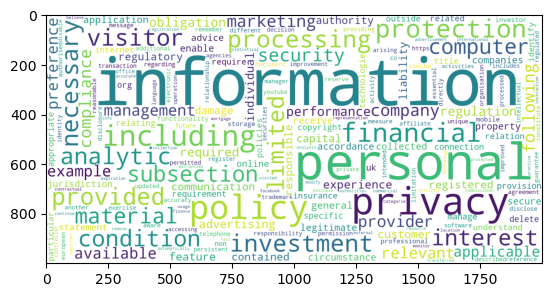

In [280]:
counts = Counter(complex_words)
print(complex_words)
print(len(complex_words))
print(counts.most_common(50))
bad_words = ['purposes','include','provide','notice','device','ensure','update','improve','services','websites','business']
complex_words = [x for x in complex_words if x.lower() not in bad_words]
complex_words_str = str(complex_words).replace("[","").replace("]","").replace(","," ").replace("'","")
word_cloud = WordCloud(width=2000, height=1000,collocations = False, background_color = 'white').generate(complex_words_str)
plt.imshow(word_cloud)
plt.show()
word_cloud.to_file('cloud.png')

In [12]:
k_words = 'https://raw.githubusercontent.com/first20hours/google-10000-english/master/google-10000-english-usa-no-swears.txt'
response = requests.get(k_words)
data = response.text
set_of_common_words = {x for x in data.split('\n')}

uncommon_complex_words = [x for x in complex_words if x not in set_of_common_words]
print(uncommon_complex_words)
print(len(uncommon_complex_words))
# aggregate_complex_words_uncommon = {x for x in complex_words if not(x in set_of_common_words)}
# print(len(aggregate_complex_words_uncommon))
# counts_uncommon = Counter(complex_words_uncommon)
# print(len(complex_words_uncommon)

['advisers', 'formulate', 'http://www.whiteleysaccountants.co.uk', 'whiteleys', 'chartered', 'sovereign', 'whiteleys', 'chartered', 'summarised', '"marketing"', 'fulfilment', 'endeavour', 'revise', 'unlawful', 'organisational', 'safeguard', 'encrypted', 'safeguard', 'protections', 'utilise', 'safeguards', 'adherence', 'transferring', 'https://www.privacyshield.gov/welcome', 'revise', 'grow@whiteleysaccountants.co.uk', 'whiteleys', 'chartered', 'consented', 'recognise', 'personalised', 'enjoyable', 'interpret', 'facebook', 'distinguish', 'distinguish', 'www.aboutcookies.org', 'www.allaboutcookies.org', 'grow@whiteleysaccountants.co.uk', 'www.whiteleysaccountants.co.uk', 'supervisory', 'bonuses', 'pandemic', 'unchanged', 'commenting', 'pressures', 'respecting', 'pioneerpoint.com', 'registering', 'subscribing', 'permanently', 'proactively', 'distinguish', 'analytics', 'afore', 'pioneerpoint.com', 'analytics', 'deletion', 'analytics', 'safeguarding', 'consented', 'de-dupe', 'unwanted', 'co

In [13]:
common_word_lists = [[y for y in x if ((y in set_of_common_words) & (syllables.estimate(y) >= 3))]for x in words.values() ]
firm_complex_words_common_count = dict(zip(words.keys(), [len(x) for x in common_word_lists]))
firm_complex_words_common_count = dict(sorted(firm_complex_words_common_count.items(), key=lambda item: item[1]))
print(firm_complex_words_common_count)
print(sum(firm_complex_words_common_count.values()))



{'http://bluewhale.co.uk/assets/files/FMC/fund-management-centre-fmc-terms-of-use.pdf': 0, 'http://wmgfunds.com/cookie-policy': 0, 'https://pathwaycapital.com/privacy-policy/': 0, 'https://sglistedproducts.co.uk/privacy-and-policy': 0, 'http://www.novia-financial.co.uk/cookie-policy/': 0, 'http://www.gwguk.com/public/document/en/privacy_policy.pdf': 0, 'http://www.gwguk.com/public/document/en/cookies_policy.pdf ': 0, 'http://www.gwguk.com/public/document/en/terms_and_conditions_of_business.pdf': 0, 'http://www.mesirow.com/sites/default/files/Form%20CRS/privacy-and-cookies-policy.pdf': 0, 'http://www.fusionwealth.co.uk/en-gb/uk/adviser/footer/applicant-privacy-notice': 0, 'http://www.fusionwealth.co.uk/en-gb/uk/adviser/footer/email-terms': 0, 'http://www.fusionwealth.co.uk/en-gb/uk/adviser/footer/schroders-group-cookie-policy/': 0, 'http://www.blakeney.com/assets/pdf/blakeney-privacypolicy.pdf': 0, 'https://www.houseofborse.com/professional-standard-terms-of-business': 0, 'http://www.bl

In [14]:
complex_common_words_pc = {k:(firm_complex_words_common_count[k]/len(v)) for (k,v) in words.items() if len(v)!=0}

In [15]:
complex_common_words_pc

{'http://www.whiteleysaccountants.co.uk/terms-and-conditions-0': 0.2962962962962963,
 'http://www.whiteleysaccountants.co.uk/privacy-cookie-policy': 0.1815415821501014,
 'http://www.whiteleysaccountants.co.uk/news-item/real-terms-pay-continues-fall': 0.10784313725490197,
 'https://pioneerpoint.com/privacy-and-cookie-policies/': 0.1731893837156995,
 'https://engagewm.co.uk/privacy-notice/': 0.17777777777777778,
 'https://policies.google.com/privacy': 0.17694854047547398,
 'https://policies.google.com/terms': 0.1994502138057422,
 'https://ledgeredge.com/privacy-policy/': 0.19171676686706746,
 'https://ledgeredge.com/cookies/': 0.1337579617834395,
 'http://www.onyxcapitalgroup.com/privacy-policy/': 0.21878224974200206,
 'http://www.onyxcapitalgroup.com/cookie-policy/': 0.1343042071197411,
 'http://www.barings.com/en-gb/guest/content/terms-and-conditions': 0.15835140997830802,
 'http://www.barings.com/en-gb/guest/content/cookies-notice': 0.1694915254237288,
 'https://consensusworkspace.co.

In [37]:

firm_names=[data_df_cleaned.loc[data_df_cleaned['Link'] == x, 'Firm'] for x in complex_common_words_pc.keys()]
d = pd.DataFrame({'Firm':firm_names,'URL':complex_common_words_pc.keys(),'Common Perc':complex_common_words_pc.values()})
d.to_excel('url_common_perc.xlsx')

In [312]:
uncommon_words_pc = {k:len([x for x in words[k] if x not in set_of_common_words])/len(v) for (k,v) in words.items() if len(v)!=0}

In [313]:
uncommon_words_pc

{'Whiteleys Financial Management LLP': 0.21568627450980393,
 'Pioneer Point Partners LLP': 0.1313540260908682,
 'Engage Wealth Management Limited': 0.15241295051924253,
 'LedgerEdge Ltd': 0.1643312101910828,
 'Onyx Commodities Limited': 0.18770226537216828,
 'Baring Asset Management Limited': 0.1016949152542373,
 'BARINGS (U.K.) LIMITED': 0.10047846889952153,
 'Chenavari Credit Partners LLP': 0.22867892976588627,
 'Stanhope Capital LLP': 0.15211521152115212,
 'Exo Investing Limited': 0.5283018867924528,
 'Merrill Lynch International': 0.2056590752242926,
 'EMFI Securities Limited': 0.16129032258064516,
 'Vinco Wealth Management Ltd': 0.10674157303370786,
 'Jarrovian Wealth Limited': 0.21508097165991902,
 'Ipreo Limited': 0.6428571428571429,
 'Independent Risk Management Solutions Limited': 0.17518248175182483,
 'Hamilton Stuart Capital Ltd': 0.24041122973507315,
 'Mitsubishi UFJ Asset Management (UK) Ltd': 0.2306925759840558,
 'CS Managers Ltd': 0.1561822125813449,
 'Walker Crips Inves

In [309]:
common_words_pc = {k:len([x for x in words[k] if x in set_of_common_words])/len(v) for (k,v) in words.items() if len(v)!=0}

In [310]:
common_words_pc

{'Whiteleys Financial Management LLP': 0.7843137254901961,
 'Pioneer Point Partners LLP': 0.8686459739091318,
 'Engage Wealth Management Limited': 0.8475870494807575,
 'LedgerEdge Ltd': 0.8356687898089172,
 'Onyx Commodities Limited': 0.8122977346278317,
 'Baring Asset Management Limited': 0.8983050847457628,
 'BARINGS (U.K.) LIMITED': 0.8995215311004785,
 'Chenavari Credit Partners LLP': 0.7713210702341137,
 'Stanhope Capital LLP': 0.8478847884788479,
 'Exo Investing Limited': 0.4716981132075472,
 'Merrill Lynch International': 0.7943409247757074,
 'EMFI Securities Limited': 0.8387096774193549,
 'Vinco Wealth Management Ltd': 0.8932584269662921,
 'Jarrovian Wealth Limited': 0.784919028340081,
 'Ipreo Limited': 0.35714285714285715,
 'Independent Risk Management Solutions Limited': 0.8248175182481752,
 'Hamilton Stuart Capital Ltd': 0.7595887702649269,
 'Mitsubishi UFJ Asset Management (UK) Ltd': 0.7693074240159442,
 'CS Managers Ltd': 0.8438177874186551,
 'Walker Crips Investment Manag

In [316]:
common_words_df = pd.DataFrame({'Firm':common_words_pc.keys(),'Common Perc':common_words_pc.values(),'Uncommon Perc':uncommon_words_pc.values()})
common_words_df.to_excel('common_words_pc.xlsx')